# Binary classification based on Logistic Regression using non-linear regression function

## import library

In [121]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.colors as colors

## load data

In [122]:
fname_data1 = 'assignment_09_data1.txt'
fname_data2 = 'assignment_09_data2.txt'

data1 = np.genfromtxt(fname_data1, delimiter=',')
data2 = np.genfromtxt(fname_data2, delimiter=',')

num_data1 = data1.shape[0]
num_data2 = data2.shape[0]

# data[:,0] : x
# data[:,1] : y
# data[:,2] : label {0, 1}

## plot the data

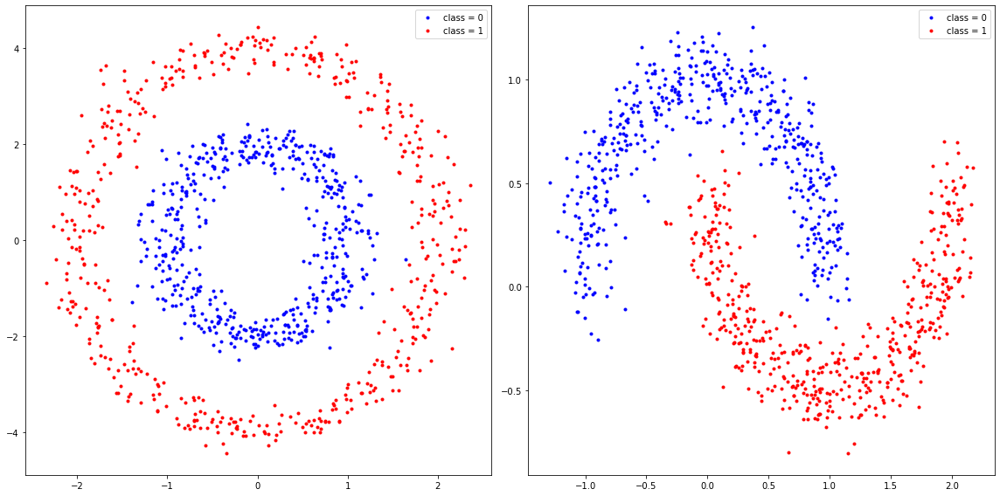

In [123]:
plt.figure(figsize=(16,8))

blue_data1 = data1[data1[:,2] == 0]
blue_x = blue_data1[:, 0]
blue_y = blue_data1[:, 1]
    
red_data1 = data1[data1[:,2] == 1]
red_x = red_data1[:, 0]
red_y = red_data1[:, 1]
    
plt.subplot(121)
plt.plot(blue_x, blue_y, '.', color = 'blue', label='class = 0')
plt.plot(red_x, red_y, '.', color = 'red', label='class = 1')


plt.legend()

blue_data2 = data2[data2[:,2] == 0]
blue_x = blue_data2[:, 0]
blue_y = blue_data2[:, 1]
    
red_data2 = data2[data2[:,2] == 1]
red_x = red_data2[:, 0]
red_y = red_data2[:, 1]
 
plt.subplot(122)    
plt.plot(blue_x, blue_y, '.', color = 'blue', label='class = 0')
plt.plot(red_x, red_y, '.', color = 'red', label='class = 1')



plt.legend()
plt.tight_layout()
plt.show()


## define the feature function for each data to obtain the best accuracy

In [124]:
def feature_function1(x, y):
    
    feature = []
    for i in range(0, num_data1):
        feature.append(np.array([1, x[i]**2, y[i]**2]))
    
    feature = np.array(feature)
        
    return feature

In [125]:
def feature_function2(x, y):
    
    feature = []
    for i in range(0, num_data2):
        feature.append(np.array([1, x[i], x[i]**2, x[i]**3, y[i]]))
    
    feature = np.array(feature)
    
    return feature

## define regression function with a vector $\theta$ model parameters and input data 

In [126]:
def regression_function(theta, feature):
    
    value = np.matmul(np.transpose(theta), np.transpose(feature))
    
    return value

## define sigmoid function with input $x$

In [127]:
def logistic_function(x):
    
    z = 1/(1+np.exp(-x))
    
    return z

## define loss function with feature and label based on the logistic regression

In [128]:
def compute_loss_feature(theta, feature, label):
    regression_value = regression_function(theta, feature)
    rhs_sum = 0
    loss = 0
    num_data = len(feature)
    
    for i in range(0, num_data):
        h = logistic_function(regression_value[i])
        rhs_sum += ((-label[i]*np.log(h)) - ((1-label[i])*np.log(1-h)))
    
    loss = rhs_sum / num_data
    
    return loss

## define gradient vector for the model parameters $\theta$

In [129]:
def compute_gradient_feature(theta, feature, label):
    gradient = 0
    H = []

    num_data = len(feature)
    regression_value = regression_function(theta, feature)
    
    for i in range(0, num_data):
        h = logistic_function(regression_value[i])
        H.append(h)

    gradient = np.matmul(np.transpose(feature), (H - label)) / num_data
    
    return gradient

## compute the accuracy

In [130]:
def compute_accuracy(theta, feature, label):
    num_data = len(feature)
    regression_value = regression_function(theta, feature)
    hit_count = 0
    accuracy = 0
        
    for i in range(0, num_data):
        h = logistic_function(regression_value[i])
        if h >= 0.5 and label[i] == 1:
            hit_count += 1
        elif h < 0.5 and label[i] == 0:
            hit_count += 1
            
    accuracy = hit_count / num_data
    
    return accuracy

## gradient descent for the model parameters $\theta$

In [131]:
num_iteration   = 30000         # USE THIS VALUE for the number of gradient descent iterations 
learning_rate   = 0.3           # USE THIS VALUE for the learning rate
theta1          = np.array((0, 0, 0))
theta2          = np.array((0, 0, 0, 0, 0))

theta1_iteration = np.zeros((num_iteration, theta1.size))
loss1_iteration  = np.zeros(num_iteration)

theta2_iteration = np.zeros((num_iteration, theta2.size))
loss2_iteration  = np.zeros(num_iteration)

In [132]:
feature1 = feature_function1(data1[:,0], data1[:,1])
label1 = data1[:, 2]

feature2 = feature_function2(data2[:,0], data2[:,1])
label2 = data2[:, 2]

In [133]:
for i in range(0, num_iteration):
    theta1 = theta1 - learning_rate * compute_gradient_feature(theta1, feature1, label1)
    loss1 = compute_loss_feature(theta1, feature1, label1)
    theta1_iteration[i] = theta1
    loss1_iteration[i] = loss1
    print("**for data1** iteration = %4d, loss = %5.5f" % (i, loss1))
    
    theta2 = theta2 - learning_rate * compute_gradient_feature(theta2, feature2, label2)
    loss2 = compute_loss_feature(theta2, feature2, label2)
    theta2_iteration[i] = theta2
    loss2_iteration[i] = loss2
    print("**for data2** iteration = %4d, loss = %5.5f" % (i, loss2))
    
theta1_optimal = theta1
theta2_optimal = theta2

**for data1** iteration =    0, loss = 0.72428
**for data2** iteration =    0, loss = 0.57880
**for data1** iteration =    1, loss = 0.57370
**for data2** iteration =    1, loss = 0.54930
**for data1** iteration =    2, loss = 0.54469
**for data2** iteration =    2, loss = 0.52889
**for data1** iteration =    3, loss = 0.52982
**for data2** iteration =    3, loss = 0.51238
**for data1** iteration =    4, loss = 0.51471
**for data2** iteration =    4, loss = 0.49825
**for data1** iteration =    5, loss = 0.50206
**for data2** iteration =    5, loss = 0.48585
**for data1** iteration =    6, loss = 0.48957
**for data2** iteration =    6, loss = 0.47479
**for data1** iteration =    7, loss = 0.47824
**for data2** iteration =    7, loss = 0.46484
**for data1** iteration =    8, loss = 0.46718
**for data2** iteration =    8, loss = 0.45581
**for data1** iteration =    9, loss = 0.45682
**for data2** iteration =    9, loss = 0.44757
**for data1** iteration =   10, loss = 0.44678
**for data2**

**for data2** iteration =   93, loss = 0.26698
**for data1** iteration =   94, loss = 0.14771
**for data2** iteration =   94, loss = 0.26610
**for data1** iteration =   95, loss = 0.14654
**for data2** iteration =   95, loss = 0.26522
**for data1** iteration =   96, loss = 0.14538
**for data2** iteration =   96, loss = 0.26436
**for data1** iteration =   97, loss = 0.14424
**for data2** iteration =   97, loss = 0.26351
**for data1** iteration =   98, loss = 0.14312
**for data2** iteration =   98, loss = 0.26267
**for data1** iteration =   99, loss = 0.14202
**for data2** iteration =   99, loss = 0.26183
**for data1** iteration =  100, loss = 0.14094
**for data2** iteration =  100, loss = 0.26100
**for data1** iteration =  101, loss = 0.13987
**for data2** iteration =  101, loss = 0.26018
**for data1** iteration =  102, loss = 0.13882
**for data2** iteration =  102, loss = 0.25937
**for data1** iteration =  103, loss = 0.13779
**for data2** iteration =  103, loss = 0.25857
**for data1**

**for data1** iteration =  189, loss = 0.08534
**for data2** iteration =  189, loss = 0.20972
**for data1** iteration =  190, loss = 0.08498
**for data2** iteration =  190, loss = 0.20931
**for data1** iteration =  191, loss = 0.08463
**for data2** iteration =  191, loss = 0.20890
**for data1** iteration =  192, loss = 0.08427
**for data2** iteration =  192, loss = 0.20850
**for data1** iteration =  193, loss = 0.08392
**for data2** iteration =  193, loss = 0.20809
**for data1** iteration =  194, loss = 0.08358
**for data2** iteration =  194, loss = 0.20769
**for data1** iteration =  195, loss = 0.08323
**for data2** iteration =  195, loss = 0.20729
**for data1** iteration =  196, loss = 0.08289
**for data2** iteration =  196, loss = 0.20689
**for data1** iteration =  197, loss = 0.08255
**for data2** iteration =  197, loss = 0.20650
**for data1** iteration =  198, loss = 0.08222
**for data2** iteration =  198, loss = 0.20610
**for data1** iteration =  199, loss = 0.08189
**for data2**

**for data2** iteration =  282, loss = 0.17932
**for data1** iteration =  283, loss = 0.06177
**for data2** iteration =  283, loss = 0.17906
**for data1** iteration =  284, loss = 0.06160
**for data2** iteration =  284, loss = 0.17880
**for data1** iteration =  285, loss = 0.06143
**for data2** iteration =  285, loss = 0.17854
**for data1** iteration =  286, loss = 0.06125
**for data2** iteration =  286, loss = 0.17828
**for data1** iteration =  287, loss = 0.06108
**for data2** iteration =  287, loss = 0.17802
**for data1** iteration =  288, loss = 0.06092
**for data2** iteration =  288, loss = 0.17776
**for data1** iteration =  289, loss = 0.06075
**for data2** iteration =  289, loss = 0.17751
**for data1** iteration =  290, loss = 0.06058
**for data2** iteration =  290, loss = 0.17725
**for data1** iteration =  291, loss = 0.06042
**for data2** iteration =  291, loss = 0.17700
**for data1** iteration =  292, loss = 0.06025
**for data2** iteration =  292, loss = 0.17675
**for data1**

**for data2** iteration =  376, loss = 0.15856
**for data1** iteration =  377, loss = 0.04924
**for data2** iteration =  377, loss = 0.15837
**for data1** iteration =  378, loss = 0.04914
**for data2** iteration =  378, loss = 0.15818
**for data1** iteration =  379, loss = 0.04904
**for data2** iteration =  379, loss = 0.15800
**for data1** iteration =  380, loss = 0.04894
**for data2** iteration =  380, loss = 0.15781
**for data1** iteration =  381, loss = 0.04884
**for data2** iteration =  381, loss = 0.15763
**for data1** iteration =  382, loss = 0.04874
**for data2** iteration =  382, loss = 0.15744
**for data1** iteration =  383, loss = 0.04864
**for data2** iteration =  383, loss = 0.15726
**for data1** iteration =  384, loss = 0.04854
**for data2** iteration =  384, loss = 0.15708
**for data1** iteration =  385, loss = 0.04844
**for data2** iteration =  385, loss = 0.15690
**for data1** iteration =  386, loss = 0.04834
**for data2** iteration =  386, loss = 0.15671
**for data1**

**for data2** iteration =  468, loss = 0.14351
**for data1** iteration =  469, loss = 0.04157
**for data2** iteration =  469, loss = 0.14337
**for data1** iteration =  470, loss = 0.04150
**for data2** iteration =  470, loss = 0.14322
**for data1** iteration =  471, loss = 0.04144
**for data2** iteration =  471, loss = 0.14308
**for data1** iteration =  472, loss = 0.04137
**for data2** iteration =  472, loss = 0.14294
**for data1** iteration =  473, loss = 0.04130
**for data2** iteration =  473, loss = 0.14280
**for data1** iteration =  474, loss = 0.04123
**for data2** iteration =  474, loss = 0.14266
**for data1** iteration =  475, loss = 0.04117
**for data2** iteration =  475, loss = 0.14252
**for data1** iteration =  476, loss = 0.04110
**for data2** iteration =  476, loss = 0.14238
**for data1** iteration =  477, loss = 0.04104
**for data2** iteration =  477, loss = 0.14224
**for data1** iteration =  478, loss = 0.04097
**for data2** iteration =  478, loss = 0.14210
**for data1**

**for data1** iteration =  561, loss = 0.03627
**for data2** iteration =  561, loss = 0.13164
**for data1** iteration =  562, loss = 0.03623
**for data2** iteration =  562, loss = 0.13153
**for data1** iteration =  563, loss = 0.03618
**for data2** iteration =  563, loss = 0.13142
**for data1** iteration =  564, loss = 0.03613
**for data2** iteration =  564, loss = 0.13130
**for data1** iteration =  565, loss = 0.03608
**for data2** iteration =  565, loss = 0.13119
**for data1** iteration =  566, loss = 0.03603
**for data2** iteration =  566, loss = 0.13108
**for data1** iteration =  567, loss = 0.03599
**for data2** iteration =  567, loss = 0.13097
**for data1** iteration =  568, loss = 0.03594
**for data2** iteration =  568, loss = 0.13085
**for data1** iteration =  569, loss = 0.03589
**for data2** iteration =  569, loss = 0.13074
**for data1** iteration =  570, loss = 0.03584
**for data2** iteration =  570, loss = 0.13063
**for data1** iteration =  571, loss = 0.03580
**for data2**

**for data1** iteration =  658, loss = 0.03220
**for data2** iteration =  658, loss = 0.12172
**for data1** iteration =  659, loss = 0.03217
**for data2** iteration =  659, loss = 0.12163
**for data1** iteration =  660, loss = 0.03213
**for data2** iteration =  660, loss = 0.12154
**for data1** iteration =  661, loss = 0.03210
**for data2** iteration =  661, loss = 0.12144
**for data1** iteration =  662, loss = 0.03206
**for data2** iteration =  662, loss = 0.12135
**for data1** iteration =  663, loss = 0.03203
**for data2** iteration =  663, loss = 0.12126
**for data1** iteration =  664, loss = 0.03199
**for data2** iteration =  664, loss = 0.12117
**for data1** iteration =  665, loss = 0.03195
**for data2** iteration =  665, loss = 0.12108
**for data1** iteration =  666, loss = 0.03192
**for data2** iteration =  666, loss = 0.12099
**for data1** iteration =  667, loss = 0.03188
**for data2** iteration =  667, loss = 0.12090
**for data1** iteration =  668, loss = 0.03185
**for data2**

**for data2** iteration =  751, loss = 0.11390
**for data1** iteration =  752, loss = 0.02921
**for data2** iteration =  752, loss = 0.11382
**for data1** iteration =  753, loss = 0.02918
**for data2** iteration =  753, loss = 0.11374
**for data1** iteration =  754, loss = 0.02915
**for data2** iteration =  754, loss = 0.11367
**for data1** iteration =  755, loss = 0.02912
**for data2** iteration =  755, loss = 0.11359
**for data1** iteration =  756, loss = 0.02909
**for data2** iteration =  756, loss = 0.11351
**for data1** iteration =  757, loss = 0.02907
**for data2** iteration =  757, loss = 0.11344
**for data1** iteration =  758, loss = 0.02904
**for data2** iteration =  758, loss = 0.11336
**for data1** iteration =  759, loss = 0.02901
**for data2** iteration =  759, loss = 0.11329
**for data1** iteration =  760, loss = 0.02898
**for data2** iteration =  760, loss = 0.11321
**for data1** iteration =  761, loss = 0.02895
**for data2** iteration =  761, loss = 0.11314
**for data1**

**for data2** iteration =  844, loss = 0.10731
**for data1** iteration =  845, loss = 0.02686
**for data2** iteration =  845, loss = 0.10725
**for data1** iteration =  846, loss = 0.02683
**for data2** iteration =  846, loss = 0.10718
**for data1** iteration =  847, loss = 0.02681
**for data2** iteration =  847, loss = 0.10712
**for data1** iteration =  848, loss = 0.02679
**for data2** iteration =  848, loss = 0.10705
**for data1** iteration =  849, loss = 0.02677
**for data2** iteration =  849, loss = 0.10699
**for data1** iteration =  850, loss = 0.02674
**for data2** iteration =  850, loss = 0.10692
**for data1** iteration =  851, loss = 0.02672
**for data2** iteration =  851, loss = 0.10686
**for data1** iteration =  852, loss = 0.02670
**for data2** iteration =  852, loss = 0.10679
**for data1** iteration =  853, loss = 0.02668
**for data2** iteration =  853, loss = 0.10673
**for data1** iteration =  854, loss = 0.02665
**for data2** iteration =  854, loss = 0.10667
**for data1**

**for data1** iteration =  938, loss = 0.02495
**for data2** iteration =  938, loss = 0.10163
**for data1** iteration =  939, loss = 0.02493
**for data2** iteration =  939, loss = 0.10157
**for data1** iteration =  940, loss = 0.02491
**for data2** iteration =  940, loss = 0.10152
**for data1** iteration =  941, loss = 0.02489
**for data2** iteration =  941, loss = 0.10146
**for data1** iteration =  942, loss = 0.02487
**for data2** iteration =  942, loss = 0.10140
**for data1** iteration =  943, loss = 0.02485
**for data2** iteration =  943, loss = 0.10135
**for data1** iteration =  944, loss = 0.02483
**for data2** iteration =  944, loss = 0.10129
**for data1** iteration =  945, loss = 0.02482
**for data2** iteration =  945, loss = 0.10124
**for data1** iteration =  946, loss = 0.02480
**for data2** iteration =  946, loss = 0.10118
**for data1** iteration =  947, loss = 0.02478
**for data2** iteration =  947, loss = 0.10113
**for data1** iteration =  948, loss = 0.02476
**for data2**

**for data1** iteration = 1030, loss = 0.02337
**for data2** iteration = 1030, loss = 0.09681
**for data1** iteration = 1031, loss = 0.02336
**for data2** iteration = 1031, loss = 0.09676
**for data1** iteration = 1032, loss = 0.02334
**for data2** iteration = 1032, loss = 0.09671
**for data1** iteration = 1033, loss = 0.02333
**for data2** iteration = 1033, loss = 0.09666
**for data1** iteration = 1034, loss = 0.02331
**for data2** iteration = 1034, loss = 0.09661
**for data1** iteration = 1035, loss = 0.02330
**for data2** iteration = 1035, loss = 0.09657
**for data1** iteration = 1036, loss = 0.02328
**for data2** iteration = 1036, loss = 0.09652
**for data1** iteration = 1037, loss = 0.02326
**for data2** iteration = 1037, loss = 0.09647
**for data1** iteration = 1038, loss = 0.02325
**for data2** iteration = 1038, loss = 0.09642
**for data1** iteration = 1039, loss = 0.02323
**for data2** iteration = 1039, loss = 0.09637
**for data1** iteration = 1040, loss = 0.02322
**for data2**

**for data2** iteration = 1125, loss = 0.09246
**for data1** iteration = 1126, loss = 0.02199
**for data2** iteration = 1126, loss = 0.09241
**for data1** iteration = 1127, loss = 0.02198
**for data2** iteration = 1127, loss = 0.09237
**for data1** iteration = 1128, loss = 0.02196
**for data2** iteration = 1128, loss = 0.09233
**for data1** iteration = 1129, loss = 0.02195
**for data2** iteration = 1129, loss = 0.09229
**for data1** iteration = 1130, loss = 0.02194
**for data2** iteration = 1130, loss = 0.09224
**for data1** iteration = 1131, loss = 0.02192
**for data2** iteration = 1131, loss = 0.09220
**for data1** iteration = 1132, loss = 0.02191
**for data2** iteration = 1132, loss = 0.09216
**for data1** iteration = 1133, loss = 0.02190
**for data2** iteration = 1133, loss = 0.09211
**for data1** iteration = 1134, loss = 0.02189
**for data2** iteration = 1134, loss = 0.09207
**for data1** iteration = 1135, loss = 0.02187
**for data2** iteration = 1135, loss = 0.09203
**for data1**

**for data1** iteration = 1219, loss = 0.02085
**for data2** iteration = 1219, loss = 0.08866
**for data1** iteration = 1220, loss = 0.02083
**for data2** iteration = 1220, loss = 0.08862
**for data1** iteration = 1221, loss = 0.02082
**for data2** iteration = 1221, loss = 0.08858
**for data1** iteration = 1222, loss = 0.02081
**for data2** iteration = 1222, loss = 0.08854
**for data1** iteration = 1223, loss = 0.02080
**for data2** iteration = 1223, loss = 0.08851
**for data1** iteration = 1224, loss = 0.02079
**for data2** iteration = 1224, loss = 0.08847
**for data1** iteration = 1225, loss = 0.02078
**for data2** iteration = 1225, loss = 0.08843
**for data1** iteration = 1226, loss = 0.02077
**for data2** iteration = 1226, loss = 0.08839
**for data1** iteration = 1227, loss = 0.02075
**for data2** iteration = 1227, loss = 0.08835
**for data1** iteration = 1228, loss = 0.02074
**for data2** iteration = 1228, loss = 0.08832
**for data1** iteration = 1229, loss = 0.02073
**for data2**

**for data1** iteration = 1313, loss = 0.01984
**for data2** iteration = 1313, loss = 0.08527
**for data1** iteration = 1314, loss = 0.01983
**for data2** iteration = 1314, loss = 0.08524
**for data1** iteration = 1315, loss = 0.01982
**for data2** iteration = 1315, loss = 0.08521
**for data1** iteration = 1316, loss = 0.01981
**for data2** iteration = 1316, loss = 0.08517
**for data1** iteration = 1317, loss = 0.01980
**for data2** iteration = 1317, loss = 0.08514
**for data1** iteration = 1318, loss = 0.01979
**for data2** iteration = 1318, loss = 0.08510
**for data1** iteration = 1319, loss = 0.01978
**for data2** iteration = 1319, loss = 0.08507
**for data1** iteration = 1320, loss = 0.01977
**for data2** iteration = 1320, loss = 0.08504
**for data1** iteration = 1321, loss = 0.01976
**for data2** iteration = 1321, loss = 0.08500
**for data1** iteration = 1322, loss = 0.01975
**for data2** iteration = 1322, loss = 0.08497
**for data1** iteration = 1323, loss = 0.01974
**for data2**

**for data1** iteration = 1407, loss = 0.01896
**for data2** iteration = 1407, loss = 0.08224
**for data1** iteration = 1408, loss = 0.01896
**for data2** iteration = 1408, loss = 0.08221
**for data1** iteration = 1409, loss = 0.01895
**for data2** iteration = 1409, loss = 0.08218
**for data1** iteration = 1410, loss = 0.01894
**for data2** iteration = 1410, loss = 0.08215
**for data1** iteration = 1411, loss = 0.01893
**for data2** iteration = 1411, loss = 0.08212
**for data1** iteration = 1412, loss = 0.01892
**for data2** iteration = 1412, loss = 0.08209
**for data1** iteration = 1413, loss = 0.01891
**for data2** iteration = 1413, loss = 0.08206
**for data1** iteration = 1414, loss = 0.01890
**for data2** iteration = 1414, loss = 0.08203
**for data1** iteration = 1415, loss = 0.01889
**for data2** iteration = 1415, loss = 0.08200
**for data1** iteration = 1416, loss = 0.01889
**for data2** iteration = 1416, loss = 0.08197
**for data1** iteration = 1417, loss = 0.01888
**for data2**

**for data1** iteration = 1502, loss = 0.01818
**for data2** iteration = 1502, loss = 0.07947
**for data1** iteration = 1503, loss = 0.01817
**for data2** iteration = 1503, loss = 0.07945
**for data1** iteration = 1504, loss = 0.01817
**for data2** iteration = 1504, loss = 0.07942
**for data1** iteration = 1505, loss = 0.01816
**for data2** iteration = 1505, loss = 0.07939
**for data1** iteration = 1506, loss = 0.01815
**for data2** iteration = 1506, loss = 0.07936
**for data1** iteration = 1507, loss = 0.01814
**for data2** iteration = 1507, loss = 0.07934
**for data1** iteration = 1508, loss = 0.01814
**for data2** iteration = 1508, loss = 0.07931
**for data1** iteration = 1509, loss = 0.01813
**for data2** iteration = 1509, loss = 0.07928
**for data1** iteration = 1510, loss = 0.01812
**for data2** iteration = 1510, loss = 0.07925
**for data1** iteration = 1511, loss = 0.01811
**for data2** iteration = 1511, loss = 0.07923
**for data1** iteration = 1512, loss = 0.01810
**for data2**

**for data2** iteration = 1597, loss = 0.07696
**for data1** iteration = 1598, loss = 0.01748
**for data2** iteration = 1598, loss = 0.07694
**for data1** iteration = 1599, loss = 0.01747
**for data2** iteration = 1599, loss = 0.07691
**for data1** iteration = 1600, loss = 0.01746
**for data2** iteration = 1600, loss = 0.07689
**for data1** iteration = 1601, loss = 0.01746
**for data2** iteration = 1601, loss = 0.07686
**for data1** iteration = 1602, loss = 0.01745
**for data2** iteration = 1602, loss = 0.07684
**for data1** iteration = 1603, loss = 0.01744
**for data2** iteration = 1603, loss = 0.07681
**for data1** iteration = 1604, loss = 0.01744
**for data2** iteration = 1604, loss = 0.07679
**for data1** iteration = 1605, loss = 0.01743
**for data2** iteration = 1605, loss = 0.07676
**for data1** iteration = 1606, loss = 0.01742
**for data2** iteration = 1606, loss = 0.07674
**for data1** iteration = 1607, loss = 0.01742
**for data2** iteration = 1607, loss = 0.07671
**for data1**

**for data2** iteration = 1692, loss = 0.07467
**for data1** iteration = 1693, loss = 0.01686
**for data2** iteration = 1693, loss = 0.07465
**for data1** iteration = 1694, loss = 0.01685
**for data2** iteration = 1694, loss = 0.07463
**for data1** iteration = 1695, loss = 0.01684
**for data2** iteration = 1695, loss = 0.07461
**for data1** iteration = 1696, loss = 0.01684
**for data2** iteration = 1696, loss = 0.07458
**for data1** iteration = 1697, loss = 0.01683
**for data2** iteration = 1697, loss = 0.07456
**for data1** iteration = 1698, loss = 0.01683
**for data2** iteration = 1698, loss = 0.07454
**for data1** iteration = 1699, loss = 0.01682
**for data2** iteration = 1699, loss = 0.07451
**for data1** iteration = 1700, loss = 0.01681
**for data2** iteration = 1700, loss = 0.07449
**for data1** iteration = 1701, loss = 0.01681
**for data2** iteration = 1701, loss = 0.07447
**for data1** iteration = 1702, loss = 0.01680
**for data2** iteration = 1702, loss = 0.07444
**for data1**

**for data1** iteration = 1787, loss = 0.01630
**for data2** iteration = 1787, loss = 0.07258
**for data1** iteration = 1788, loss = 0.01630
**for data2** iteration = 1788, loss = 0.07255
**for data1** iteration = 1789, loss = 0.01629
**for data2** iteration = 1789, loss = 0.07253
**for data1** iteration = 1790, loss = 0.01628
**for data2** iteration = 1790, loss = 0.07251
**for data1** iteration = 1791, loss = 0.01628
**for data2** iteration = 1791, loss = 0.07249
**for data1** iteration = 1792, loss = 0.01627
**for data2** iteration = 1792, loss = 0.07247
**for data1** iteration = 1793, loss = 0.01627
**for data2** iteration = 1793, loss = 0.07245
**for data1** iteration = 1794, loss = 0.01626
**for data2** iteration = 1794, loss = 0.07243
**for data1** iteration = 1795, loss = 0.01626
**for data2** iteration = 1795, loss = 0.07241
**for data1** iteration = 1796, loss = 0.01625
**for data2** iteration = 1796, loss = 0.07239
**for data1** iteration = 1797, loss = 0.01624
**for data2**

**for data2** iteration = 1882, loss = 0.07064
**for data1** iteration = 1883, loss = 0.01579
**for data2** iteration = 1883, loss = 0.07063
**for data1** iteration = 1884, loss = 0.01578
**for data2** iteration = 1884, loss = 0.07061
**for data1** iteration = 1885, loss = 0.01578
**for data2** iteration = 1885, loss = 0.07059
**for data1** iteration = 1886, loss = 0.01577
**for data2** iteration = 1886, loss = 0.07057
**for data1** iteration = 1887, loss = 0.01577
**for data2** iteration = 1887, loss = 0.07055
**for data1** iteration = 1888, loss = 0.01576
**for data2** iteration = 1888, loss = 0.07053
**for data1** iteration = 1889, loss = 0.01576
**for data2** iteration = 1889, loss = 0.07051
**for data1** iteration = 1890, loss = 0.01575
**for data2** iteration = 1890, loss = 0.07049
**for data1** iteration = 1891, loss = 0.01575
**for data2** iteration = 1891, loss = 0.07047
**for data1** iteration = 1892, loss = 0.01574
**for data2** iteration = 1892, loss = 0.07045
**for data1**

**for data1** iteration = 1978, loss = 0.01532
**for data2** iteration = 1978, loss = 0.06884
**for data1** iteration = 1979, loss = 0.01532
**for data2** iteration = 1979, loss = 0.06882
**for data1** iteration = 1980, loss = 0.01531
**for data2** iteration = 1980, loss = 0.06881
**for data1** iteration = 1981, loss = 0.01531
**for data2** iteration = 1981, loss = 0.06879
**for data1** iteration = 1982, loss = 0.01531
**for data2** iteration = 1982, loss = 0.06877
**for data1** iteration = 1983, loss = 0.01530
**for data2** iteration = 1983, loss = 0.06875
**for data1** iteration = 1984, loss = 0.01530
**for data2** iteration = 1984, loss = 0.06873
**for data1** iteration = 1985, loss = 0.01529
**for data2** iteration = 1985, loss = 0.06872
**for data1** iteration = 1986, loss = 0.01529
**for data2** iteration = 1986, loss = 0.06870
**for data1** iteration = 1987, loss = 0.01528
**for data2** iteration = 1987, loss = 0.06868
**for data1** iteration = 1988, loss = 0.01528
**for data2**

**for data1** iteration = 2073, loss = 0.01490
**for data2** iteration = 2073, loss = 0.06719
**for data1** iteration = 2074, loss = 0.01490
**for data2** iteration = 2074, loss = 0.06717
**for data1** iteration = 2075, loss = 0.01489
**for data2** iteration = 2075, loss = 0.06715
**for data1** iteration = 2076, loss = 0.01489
**for data2** iteration = 2076, loss = 0.06714
**for data1** iteration = 2077, loss = 0.01488
**for data2** iteration = 2077, loss = 0.06712
**for data1** iteration = 2078, loss = 0.01488
**for data2** iteration = 2078, loss = 0.06710
**for data1** iteration = 2079, loss = 0.01487
**for data2** iteration = 2079, loss = 0.06709
**for data1** iteration = 2080, loss = 0.01487
**for data2** iteration = 2080, loss = 0.06707
**for data1** iteration = 2081, loss = 0.01487
**for data2** iteration = 2081, loss = 0.06705
**for data1** iteration = 2082, loss = 0.01486
**for data2** iteration = 2082, loss = 0.06704
**for data1** iteration = 2083, loss = 0.01486
**for data2**

**for data2** iteration = 2165, loss = 0.06570
**for data1** iteration = 2166, loss = 0.01452
**for data2** iteration = 2166, loss = 0.06568
**for data1** iteration = 2167, loss = 0.01452
**for data2** iteration = 2167, loss = 0.06566
**for data1** iteration = 2168, loss = 0.01451
**for data2** iteration = 2168, loss = 0.06565
**for data1** iteration = 2169, loss = 0.01451
**for data2** iteration = 2169, loss = 0.06563
**for data1** iteration = 2170, loss = 0.01450
**for data2** iteration = 2170, loss = 0.06562
**for data1** iteration = 2171, loss = 0.01450
**for data2** iteration = 2171, loss = 0.06560
**for data1** iteration = 2172, loss = 0.01450
**for data2** iteration = 2172, loss = 0.06559
**for data1** iteration = 2173, loss = 0.01449
**for data2** iteration = 2173, loss = 0.06557
**for data1** iteration = 2174, loss = 0.01449
**for data2** iteration = 2174, loss = 0.06556
**for data1** iteration = 2175, loss = 0.01448
**for data2** iteration = 2175, loss = 0.06554
**for data1**

**for data2** iteration = 2260, loss = 0.06426
**for data1** iteration = 2261, loss = 0.01416
**for data2** iteration = 2261, loss = 0.06424
**for data1** iteration = 2262, loss = 0.01416
**for data2** iteration = 2262, loss = 0.06423
**for data1** iteration = 2263, loss = 0.01415
**for data2** iteration = 2263, loss = 0.06421
**for data1** iteration = 2264, loss = 0.01415
**for data2** iteration = 2264, loss = 0.06420
**for data1** iteration = 2265, loss = 0.01415
**for data2** iteration = 2265, loss = 0.06418
**for data1** iteration = 2266, loss = 0.01414
**for data2** iteration = 2266, loss = 0.06417
**for data1** iteration = 2267, loss = 0.01414
**for data2** iteration = 2267, loss = 0.06415
**for data1** iteration = 2268, loss = 0.01413
**for data2** iteration = 2268, loss = 0.06414
**for data1** iteration = 2269, loss = 0.01413
**for data2** iteration = 2269, loss = 0.06413
**for data1** iteration = 2270, loss = 0.01413
**for data2** iteration = 2270, loss = 0.06411
**for data1**

**for data1** iteration = 2354, loss = 0.01383
**for data2** iteration = 2354, loss = 0.06292
**for data1** iteration = 2355, loss = 0.01383
**for data2** iteration = 2355, loss = 0.06291
**for data1** iteration = 2356, loss = 0.01383
**for data2** iteration = 2356, loss = 0.06290
**for data1** iteration = 2357, loss = 0.01382
**for data2** iteration = 2357, loss = 0.06288
**for data1** iteration = 2358, loss = 0.01382
**for data2** iteration = 2358, loss = 0.06287
**for data1** iteration = 2359, loss = 0.01382
**for data2** iteration = 2359, loss = 0.06285
**for data1** iteration = 2360, loss = 0.01381
**for data2** iteration = 2360, loss = 0.06284
**for data1** iteration = 2361, loss = 0.01381
**for data2** iteration = 2361, loss = 0.06283
**for data1** iteration = 2362, loss = 0.01381
**for data2** iteration = 2362, loss = 0.06281
**for data1** iteration = 2363, loss = 0.01380
**for data2** iteration = 2363, loss = 0.06280
**for data1** iteration = 2364, loss = 0.01380
**for data2**

**for data1** iteration = 2446, loss = 0.01353
**for data2** iteration = 2446, loss = 0.06170
**for data1** iteration = 2447, loss = 0.01353
**for data2** iteration = 2447, loss = 0.06168
**for data1** iteration = 2448, loss = 0.01353
**for data2** iteration = 2448, loss = 0.06167
**for data1** iteration = 2449, loss = 0.01353
**for data2** iteration = 2449, loss = 0.06166
**for data1** iteration = 2450, loss = 0.01352
**for data2** iteration = 2450, loss = 0.06165
**for data1** iteration = 2451, loss = 0.01352
**for data2** iteration = 2451, loss = 0.06163
**for data1** iteration = 2452, loss = 0.01352
**for data2** iteration = 2452, loss = 0.06162
**for data1** iteration = 2453, loss = 0.01351
**for data2** iteration = 2453, loss = 0.06161
**for data1** iteration = 2454, loss = 0.01351
**for data2** iteration = 2454, loss = 0.06159
**for data1** iteration = 2455, loss = 0.01351
**for data2** iteration = 2455, loss = 0.06158
**for data1** iteration = 2456, loss = 0.01350
**for data2**

**for data2** iteration = 2541, loss = 0.06050
**for data1** iteration = 2542, loss = 0.01324
**for data2** iteration = 2542, loss = 0.06049
**for data1** iteration = 2543, loss = 0.01324
**for data2** iteration = 2543, loss = 0.06048
**for data1** iteration = 2544, loss = 0.01324
**for data2** iteration = 2544, loss = 0.06047
**for data1** iteration = 2545, loss = 0.01323
**for data2** iteration = 2545, loss = 0.06046
**for data1** iteration = 2546, loss = 0.01323
**for data2** iteration = 2546, loss = 0.06044
**for data1** iteration = 2547, loss = 0.01323
**for data2** iteration = 2547, loss = 0.06043
**for data1** iteration = 2548, loss = 0.01323
**for data2** iteration = 2548, loss = 0.06042
**for data1** iteration = 2549, loss = 0.01322
**for data2** iteration = 2549, loss = 0.06041
**for data1** iteration = 2550, loss = 0.01322
**for data2** iteration = 2550, loss = 0.06040
**for data1** iteration = 2551, loss = 0.01322
**for data2** iteration = 2551, loss = 0.06038
**for data1**

**for data2** iteration = 2636, loss = 0.05938
**for data1** iteration = 2637, loss = 0.01297
**for data2** iteration = 2637, loss = 0.05937
**for data1** iteration = 2638, loss = 0.01297
**for data2** iteration = 2638, loss = 0.05936
**for data1** iteration = 2639, loss = 0.01297
**for data2** iteration = 2639, loss = 0.05935
**for data1** iteration = 2640, loss = 0.01297
**for data2** iteration = 2640, loss = 0.05934
**for data1** iteration = 2641, loss = 0.01296
**for data2** iteration = 2641, loss = 0.05932
**for data1** iteration = 2642, loss = 0.01296
**for data2** iteration = 2642, loss = 0.05931
**for data1** iteration = 2643, loss = 0.01296
**for data2** iteration = 2643, loss = 0.05930
**for data1** iteration = 2644, loss = 0.01296
**for data2** iteration = 2644, loss = 0.05929
**for data1** iteration = 2645, loss = 0.01295
**for data2** iteration = 2645, loss = 0.05928
**for data1** iteration = 2646, loss = 0.01295
**for data2** iteration = 2646, loss = 0.05927
**for data1**

**for data2** iteration = 2730, loss = 0.05833
**for data1** iteration = 2731, loss = 0.01273
**for data2** iteration = 2731, loss = 0.05832
**for data1** iteration = 2732, loss = 0.01272
**for data2** iteration = 2732, loss = 0.05831
**for data1** iteration = 2733, loss = 0.01272
**for data2** iteration = 2733, loss = 0.05830
**for data1** iteration = 2734, loss = 0.01272
**for data2** iteration = 2734, loss = 0.05829
**for data1** iteration = 2735, loss = 0.01271
**for data2** iteration = 2735, loss = 0.05828
**for data1** iteration = 2736, loss = 0.01271
**for data2** iteration = 2736, loss = 0.05827
**for data1** iteration = 2737, loss = 0.01271
**for data2** iteration = 2737, loss = 0.05825
**for data1** iteration = 2738, loss = 0.01271
**for data2** iteration = 2738, loss = 0.05824
**for data1** iteration = 2739, loss = 0.01270
**for data2** iteration = 2739, loss = 0.05823
**for data1** iteration = 2740, loss = 0.01270
**for data2** iteration = 2740, loss = 0.05822
**for data1**

**for data1** iteration = 2824, loss = 0.01249
**for data2** iteration = 2824, loss = 0.05734
**for data1** iteration = 2825, loss = 0.01249
**for data2** iteration = 2825, loss = 0.05733
**for data1** iteration = 2826, loss = 0.01249
**for data2** iteration = 2826, loss = 0.05732
**for data1** iteration = 2827, loss = 0.01249
**for data2** iteration = 2827, loss = 0.05731
**for data1** iteration = 2828, loss = 0.01248
**for data2** iteration = 2828, loss = 0.05730
**for data1** iteration = 2829, loss = 0.01248
**for data2** iteration = 2829, loss = 0.05728
**for data1** iteration = 2830, loss = 0.01248
**for data2** iteration = 2830, loss = 0.05727
**for data1** iteration = 2831, loss = 0.01248
**for data2** iteration = 2831, loss = 0.05726
**for data1** iteration = 2832, loss = 0.01247
**for data2** iteration = 2832, loss = 0.05725
**for data1** iteration = 2833, loss = 0.01247
**for data2** iteration = 2833, loss = 0.05724
**for data1** iteration = 2834, loss = 0.01247
**for data2**

**for data2** iteration = 2915, loss = 0.05642
**for data1** iteration = 2916, loss = 0.01228
**for data2** iteration = 2916, loss = 0.05641
**for data1** iteration = 2917, loss = 0.01228
**for data2** iteration = 2917, loss = 0.05640
**for data1** iteration = 2918, loss = 0.01227
**for data2** iteration = 2918, loss = 0.05639
**for data1** iteration = 2919, loss = 0.01227
**for data2** iteration = 2919, loss = 0.05638
**for data1** iteration = 2920, loss = 0.01227
**for data2** iteration = 2920, loss = 0.05637
**for data1** iteration = 2921, loss = 0.01227
**for data2** iteration = 2921, loss = 0.05636
**for data1** iteration = 2922, loss = 0.01226
**for data2** iteration = 2922, loss = 0.05635
**for data1** iteration = 2923, loss = 0.01226
**for data2** iteration = 2923, loss = 0.05634
**for data1** iteration = 2924, loss = 0.01226
**for data2** iteration = 2924, loss = 0.05633
**for data1** iteration = 2925, loss = 0.01226
**for data2** iteration = 2925, loss = 0.05632
**for data1**

**for data1** iteration = 3008, loss = 0.01207
**for data2** iteration = 3008, loss = 0.05553
**for data1** iteration = 3009, loss = 0.01207
**for data2** iteration = 3009, loss = 0.05552
**for data1** iteration = 3010, loss = 0.01207
**for data2** iteration = 3010, loss = 0.05551
**for data1** iteration = 3011, loss = 0.01207
**for data2** iteration = 3011, loss = 0.05551
**for data1** iteration = 3012, loss = 0.01207
**for data2** iteration = 3012, loss = 0.05550
**for data1** iteration = 3013, loss = 0.01206
**for data2** iteration = 3013, loss = 0.05549
**for data1** iteration = 3014, loss = 0.01206
**for data2** iteration = 3014, loss = 0.05548
**for data1** iteration = 3015, loss = 0.01206
**for data2** iteration = 3015, loss = 0.05547
**for data1** iteration = 3016, loss = 0.01206
**for data2** iteration = 3016, loss = 0.05546
**for data1** iteration = 3017, loss = 0.01206
**for data2** iteration = 3017, loss = 0.05545
**for data1** iteration = 3018, loss = 0.01205
**for data2**

**for data2** iteration = 3102, loss = 0.05468
**for data1** iteration = 3103, loss = 0.01188
**for data2** iteration = 3103, loss = 0.05467
**for data1** iteration = 3104, loss = 0.01187
**for data2** iteration = 3104, loss = 0.05466
**for data1** iteration = 3105, loss = 0.01187
**for data2** iteration = 3105, loss = 0.05465
**for data1** iteration = 3106, loss = 0.01187
**for data2** iteration = 3106, loss = 0.05464
**for data1** iteration = 3107, loss = 0.01187
**for data2** iteration = 3107, loss = 0.05463
**for data1** iteration = 3108, loss = 0.01187
**for data2** iteration = 3108, loss = 0.05463
**for data1** iteration = 3109, loss = 0.01186
**for data2** iteration = 3109, loss = 0.05462
**for data1** iteration = 3110, loss = 0.01186
**for data2** iteration = 3110, loss = 0.05461
**for data1** iteration = 3111, loss = 0.01186
**for data2** iteration = 3111, loss = 0.05460
**for data1** iteration = 3112, loss = 0.01186
**for data2** iteration = 3112, loss = 0.05459
**for data1**

**for data1** iteration = 3194, loss = 0.01170
**for data2** iteration = 3194, loss = 0.05388
**for data1** iteration = 3195, loss = 0.01169
**for data2** iteration = 3195, loss = 0.05387
**for data1** iteration = 3196, loss = 0.01169
**for data2** iteration = 3196, loss = 0.05386
**for data1** iteration = 3197, loss = 0.01169
**for data2** iteration = 3197, loss = 0.05386
**for data1** iteration = 3198, loss = 0.01169
**for data2** iteration = 3198, loss = 0.05385
**for data1** iteration = 3199, loss = 0.01169
**for data2** iteration = 3199, loss = 0.05384
**for data1** iteration = 3200, loss = 0.01169
**for data2** iteration = 3200, loss = 0.05383
**for data1** iteration = 3201, loss = 0.01168
**for data2** iteration = 3201, loss = 0.05382
**for data1** iteration = 3202, loss = 0.01168
**for data2** iteration = 3202, loss = 0.05381
**for data1** iteration = 3203, loss = 0.01168
**for data2** iteration = 3203, loss = 0.05380
**for data1** iteration = 3204, loss = 0.01168
**for data2**

**for data2** iteration = 3288, loss = 0.05310
**for data1** iteration = 3289, loss = 0.01152
**for data2** iteration = 3289, loss = 0.05309
**for data1** iteration = 3290, loss = 0.01152
**for data2** iteration = 3290, loss = 0.05309
**for data1** iteration = 3291, loss = 0.01152
**for data2** iteration = 3291, loss = 0.05308
**for data1** iteration = 3292, loss = 0.01151
**for data2** iteration = 3292, loss = 0.05307
**for data1** iteration = 3293, loss = 0.01151
**for data2** iteration = 3293, loss = 0.05306
**for data1** iteration = 3294, loss = 0.01151
**for data2** iteration = 3294, loss = 0.05305
**for data1** iteration = 3295, loss = 0.01151
**for data2** iteration = 3295, loss = 0.05305
**for data1** iteration = 3296, loss = 0.01151
**for data2** iteration = 3296, loss = 0.05304
**for data1** iteration = 3297, loss = 0.01150
**for data2** iteration = 3297, loss = 0.05303
**for data1** iteration = 3298, loss = 0.01150
**for data2** iteration = 3298, loss = 0.05302
**for data1**

**for data2** iteration = 3379, loss = 0.05238
**for data1** iteration = 3380, loss = 0.01136
**for data2** iteration = 3380, loss = 0.05237
**for data1** iteration = 3381, loss = 0.01136
**for data2** iteration = 3381, loss = 0.05237
**for data1** iteration = 3382, loss = 0.01135
**for data2** iteration = 3382, loss = 0.05236
**for data1** iteration = 3383, loss = 0.01135
**for data2** iteration = 3383, loss = 0.05235
**for data1** iteration = 3384, loss = 0.01135
**for data2** iteration = 3384, loss = 0.05234
**for data1** iteration = 3385, loss = 0.01135
**for data2** iteration = 3385, loss = 0.05234
**for data1** iteration = 3386, loss = 0.01135
**for data2** iteration = 3386, loss = 0.05233
**for data1** iteration = 3387, loss = 0.01135
**for data2** iteration = 3387, loss = 0.05232
**for data1** iteration = 3388, loss = 0.01134
**for data2** iteration = 3388, loss = 0.05231
**for data1** iteration = 3389, loss = 0.01134
**for data2** iteration = 3389, loss = 0.05230
**for data1**

**for data2** iteration = 3474, loss = 0.05166
**for data1** iteration = 3475, loss = 0.01120
**for data2** iteration = 3475, loss = 0.05165
**for data1** iteration = 3476, loss = 0.01119
**for data2** iteration = 3476, loss = 0.05165
**for data1** iteration = 3477, loss = 0.01119
**for data2** iteration = 3477, loss = 0.05164
**for data1** iteration = 3478, loss = 0.01119
**for data2** iteration = 3478, loss = 0.05163
**for data1** iteration = 3479, loss = 0.01119
**for data2** iteration = 3479, loss = 0.05162
**for data1** iteration = 3480, loss = 0.01119
**for data2** iteration = 3480, loss = 0.05162
**for data1** iteration = 3481, loss = 0.01119
**for data2** iteration = 3481, loss = 0.05161
**for data1** iteration = 3482, loss = 0.01119
**for data2** iteration = 3482, loss = 0.05160
**for data1** iteration = 3483, loss = 0.01118
**for data2** iteration = 3483, loss = 0.05159
**for data1** iteration = 3484, loss = 0.01118
**for data2** iteration = 3484, loss = 0.05159
**for data1**

**for data1** iteration = 3568, loss = 0.01105
**for data2** iteration = 3568, loss = 0.05098
**for data1** iteration = 3569, loss = 0.01105
**for data2** iteration = 3569, loss = 0.05097
**for data1** iteration = 3570, loss = 0.01104
**for data2** iteration = 3570, loss = 0.05096
**for data1** iteration = 3571, loss = 0.01104
**for data2** iteration = 3571, loss = 0.05096
**for data1** iteration = 3572, loss = 0.01104
**for data2** iteration = 3572, loss = 0.05095
**for data1** iteration = 3573, loss = 0.01104
**for data2** iteration = 3573, loss = 0.05094
**for data1** iteration = 3574, loss = 0.01104
**for data2** iteration = 3574, loss = 0.05094
**for data1** iteration = 3575, loss = 0.01104
**for data2** iteration = 3575, loss = 0.05093
**for data1** iteration = 3576, loss = 0.01103
**for data2** iteration = 3576, loss = 0.05092
**for data1** iteration = 3577, loss = 0.01103
**for data2** iteration = 3577, loss = 0.05092
**for data1** iteration = 3578, loss = 0.01103
**for data2**

**for data2** iteration = 3661, loss = 0.05033
**for data1** iteration = 3662, loss = 0.01090
**for data2** iteration = 3662, loss = 0.05032
**for data1** iteration = 3663, loss = 0.01090
**for data2** iteration = 3663, loss = 0.05032
**for data1** iteration = 3664, loss = 0.01090
**for data2** iteration = 3664, loss = 0.05031
**for data1** iteration = 3665, loss = 0.01090
**for data2** iteration = 3665, loss = 0.05030
**for data1** iteration = 3666, loss = 0.01090
**for data2** iteration = 3666, loss = 0.05030
**for data1** iteration = 3667, loss = 0.01090
**for data2** iteration = 3667, loss = 0.05029
**for data1** iteration = 3668, loss = 0.01089
**for data2** iteration = 3668, loss = 0.05028
**for data1** iteration = 3669, loss = 0.01089
**for data2** iteration = 3669, loss = 0.05028
**for data1** iteration = 3670, loss = 0.01089
**for data2** iteration = 3670, loss = 0.05027
**for data1** iteration = 3671, loss = 0.01089
**for data2** iteration = 3671, loss = 0.05026
**for data1**

**for data2** iteration = 3755, loss = 0.04970
**for data1** iteration = 3756, loss = 0.01077
**for data2** iteration = 3756, loss = 0.04970
**for data1** iteration = 3757, loss = 0.01076
**for data2** iteration = 3757, loss = 0.04969
**for data1** iteration = 3758, loss = 0.01076
**for data2** iteration = 3758, loss = 0.04968
**for data1** iteration = 3759, loss = 0.01076
**for data2** iteration = 3759, loss = 0.04968
**for data1** iteration = 3760, loss = 0.01076
**for data2** iteration = 3760, loss = 0.04967
**for data1** iteration = 3761, loss = 0.01076
**for data2** iteration = 3761, loss = 0.04966
**for data1** iteration = 3762, loss = 0.01076
**for data2** iteration = 3762, loss = 0.04966
**for data1** iteration = 3763, loss = 0.01076
**for data2** iteration = 3763, loss = 0.04965
**for data1** iteration = 3764, loss = 0.01075
**for data2** iteration = 3764, loss = 0.04964
**for data1** iteration = 3765, loss = 0.01075
**for data2** iteration = 3765, loss = 0.04964
**for data1**

**for data1** iteration = 3849, loss = 0.01064
**for data2** iteration = 3849, loss = 0.04910
**for data1** iteration = 3850, loss = 0.01063
**for data2** iteration = 3850, loss = 0.04909
**for data1** iteration = 3851, loss = 0.01063
**for data2** iteration = 3851, loss = 0.04909
**for data1** iteration = 3852, loss = 0.01063
**for data2** iteration = 3852, loss = 0.04908
**for data1** iteration = 3853, loss = 0.01063
**for data2** iteration = 3853, loss = 0.04907
**for data1** iteration = 3854, loss = 0.01063
**for data2** iteration = 3854, loss = 0.04907
**for data1** iteration = 3855, loss = 0.01063
**for data2** iteration = 3855, loss = 0.04906
**for data1** iteration = 3856, loss = 0.01063
**for data2** iteration = 3856, loss = 0.04905
**for data1** iteration = 3857, loss = 0.01062
**for data2** iteration = 3857, loss = 0.04905
**for data1** iteration = 3858, loss = 0.01062
**for data2** iteration = 3858, loss = 0.04904
**for data1** iteration = 3859, loss = 0.01062
**for data2**

**for data1** iteration = 3943, loss = 0.01051
**for data2** iteration = 3943, loss = 0.04852
**for data1** iteration = 3944, loss = 0.01051
**for data2** iteration = 3944, loss = 0.04851
**for data1** iteration = 3945, loss = 0.01051
**for data2** iteration = 3945, loss = 0.04851
**for data1** iteration = 3946, loss = 0.01051
**for data2** iteration = 3946, loss = 0.04850
**for data1** iteration = 3947, loss = 0.01050
**for data2** iteration = 3947, loss = 0.04849
**for data1** iteration = 3948, loss = 0.01050
**for data2** iteration = 3948, loss = 0.04849
**for data1** iteration = 3949, loss = 0.01050
**for data2** iteration = 3949, loss = 0.04848
**for data1** iteration = 3950, loss = 0.01050
**for data2** iteration = 3950, loss = 0.04848
**for data1** iteration = 3951, loss = 0.01050
**for data2** iteration = 3951, loss = 0.04847
**for data1** iteration = 3952, loss = 0.01050
**for data2** iteration = 3952, loss = 0.04846
**for data1** iteration = 3953, loss = 0.01050
**for data2**

**for data2** iteration = 4036, loss = 0.04796
**for data1** iteration = 4037, loss = 0.01039
**for data2** iteration = 4037, loss = 0.04796
**for data1** iteration = 4038, loss = 0.01039
**for data2** iteration = 4038, loss = 0.04795
**for data1** iteration = 4039, loss = 0.01039
**for data2** iteration = 4039, loss = 0.04795
**for data1** iteration = 4040, loss = 0.01039
**for data2** iteration = 4040, loss = 0.04794
**for data1** iteration = 4041, loss = 0.01038
**for data2** iteration = 4041, loss = 0.04793
**for data1** iteration = 4042, loss = 0.01038
**for data2** iteration = 4042, loss = 0.04793
**for data1** iteration = 4043, loss = 0.01038
**for data2** iteration = 4043, loss = 0.04792
**for data1** iteration = 4044, loss = 0.01038
**for data2** iteration = 4044, loss = 0.04792
**for data1** iteration = 4045, loss = 0.01038
**for data2** iteration = 4045, loss = 0.04791
**for data1** iteration = 4046, loss = 0.01038
**for data2** iteration = 4046, loss = 0.04791
**for data1**

**for data2** iteration = 4130, loss = 0.04742
**for data1** iteration = 4131, loss = 0.01027
**for data2** iteration = 4131, loss = 0.04742
**for data1** iteration = 4132, loss = 0.01027
**for data2** iteration = 4132, loss = 0.04741
**for data1** iteration = 4133, loss = 0.01027
**for data2** iteration = 4133, loss = 0.04741
**for data1** iteration = 4134, loss = 0.01027
**for data2** iteration = 4134, loss = 0.04740
**for data1** iteration = 4135, loss = 0.01027
**for data2** iteration = 4135, loss = 0.04740
**for data1** iteration = 4136, loss = 0.01027
**for data2** iteration = 4136, loss = 0.04739
**for data1** iteration = 4137, loss = 0.01027
**for data2** iteration = 4137, loss = 0.04738
**for data1** iteration = 4138, loss = 0.01027
**for data2** iteration = 4138, loss = 0.04738
**for data1** iteration = 4139, loss = 0.01026
**for data2** iteration = 4139, loss = 0.04737
**for data1** iteration = 4140, loss = 0.01026
**for data2** iteration = 4140, loss = 0.04737
**for data1**

**for data2** iteration = 4224, loss = 0.04690
**for data1** iteration = 4225, loss = 0.01016
**for data2** iteration = 4225, loss = 0.04690
**for data1** iteration = 4226, loss = 0.01016
**for data2** iteration = 4226, loss = 0.04689
**for data1** iteration = 4227, loss = 0.01016
**for data2** iteration = 4227, loss = 0.04689
**for data1** iteration = 4228, loss = 0.01016
**for data2** iteration = 4228, loss = 0.04688
**for data1** iteration = 4229, loss = 0.01016
**for data2** iteration = 4229, loss = 0.04688
**for data1** iteration = 4230, loss = 0.01016
**for data2** iteration = 4230, loss = 0.04687
**for data1** iteration = 4231, loss = 0.01016
**for data2** iteration = 4231, loss = 0.04687
**for data1** iteration = 4232, loss = 0.01016
**for data2** iteration = 4232, loss = 0.04686
**for data1** iteration = 4233, loss = 0.01015
**for data2** iteration = 4233, loss = 0.04685
**for data1** iteration = 4234, loss = 0.01015
**for data2** iteration = 4234, loss = 0.04685
**for data1**

**for data2** iteration = 4320, loss = 0.04639
**for data1** iteration = 4321, loss = 0.01006
**for data2** iteration = 4321, loss = 0.04639
**for data1** iteration = 4322, loss = 0.01005
**for data2** iteration = 4322, loss = 0.04638
**for data1** iteration = 4323, loss = 0.01005
**for data2** iteration = 4323, loss = 0.04638
**for data1** iteration = 4324, loss = 0.01005
**for data2** iteration = 4324, loss = 0.04637
**for data1** iteration = 4325, loss = 0.01005
**for data2** iteration = 4325, loss = 0.04636
**for data1** iteration = 4326, loss = 0.01005
**for data2** iteration = 4326, loss = 0.04636
**for data1** iteration = 4327, loss = 0.01005
**for data2** iteration = 4327, loss = 0.04635
**for data1** iteration = 4328, loss = 0.01005
**for data2** iteration = 4328, loss = 0.04635
**for data1** iteration = 4329, loss = 0.01005
**for data2** iteration = 4329, loss = 0.04634
**for data1** iteration = 4330, loss = 0.01005
**for data2** iteration = 4330, loss = 0.04634
**for data1**

**for data1** iteration = 4415, loss = 0.00995
**for data2** iteration = 4415, loss = 0.04590
**for data1** iteration = 4416, loss = 0.00995
**for data2** iteration = 4416, loss = 0.04590
**for data1** iteration = 4417, loss = 0.00995
**for data2** iteration = 4417, loss = 0.04589
**for data1** iteration = 4418, loss = 0.00995
**for data2** iteration = 4418, loss = 0.04589
**for data1** iteration = 4419, loss = 0.00995
**for data2** iteration = 4419, loss = 0.04588
**for data1** iteration = 4420, loss = 0.00995
**for data2** iteration = 4420, loss = 0.04588
**for data1** iteration = 4421, loss = 0.00995
**for data2** iteration = 4421, loss = 0.04587
**for data1** iteration = 4422, loss = 0.00995
**for data2** iteration = 4422, loss = 0.04587
**for data1** iteration = 4423, loss = 0.00995
**for data2** iteration = 4423, loss = 0.04586
**for data1** iteration = 4424, loss = 0.00994
**for data2** iteration = 4424, loss = 0.04586
**for data1** iteration = 4425, loss = 0.00994
**for data2**

**for data1** iteration = 4511, loss = 0.00985
**for data2** iteration = 4511, loss = 0.04542
**for data1** iteration = 4512, loss = 0.00985
**for data2** iteration = 4512, loss = 0.04542
**for data1** iteration = 4513, loss = 0.00985
**for data2** iteration = 4513, loss = 0.04541
**for data1** iteration = 4514, loss = 0.00985
**for data2** iteration = 4514, loss = 0.04541
**for data1** iteration = 4515, loss = 0.00985
**for data2** iteration = 4515, loss = 0.04540
**for data1** iteration = 4516, loss = 0.00985
**for data2** iteration = 4516, loss = 0.04540
**for data1** iteration = 4517, loss = 0.00985
**for data2** iteration = 4517, loss = 0.04539
**for data1** iteration = 4518, loss = 0.00985
**for data2** iteration = 4518, loss = 0.04539
**for data1** iteration = 4519, loss = 0.00985
**for data2** iteration = 4519, loss = 0.04538
**for data1** iteration = 4520, loss = 0.00984
**for data2** iteration = 4520, loss = 0.04538
**for data1** iteration = 4521, loss = 0.00984
**for data2**

**for data1** iteration = 4607, loss = 0.00976
**for data2** iteration = 4607, loss = 0.04496
**for data1** iteration = 4608, loss = 0.00976
**for data2** iteration = 4608, loss = 0.04495
**for data1** iteration = 4609, loss = 0.00976
**for data2** iteration = 4609, loss = 0.04495
**for data1** iteration = 4610, loss = 0.00975
**for data2** iteration = 4610, loss = 0.04495
**for data1** iteration = 4611, loss = 0.00975
**for data2** iteration = 4611, loss = 0.04494
**for data1** iteration = 4612, loss = 0.00975
**for data2** iteration = 4612, loss = 0.04494
**for data1** iteration = 4613, loss = 0.00975
**for data2** iteration = 4613, loss = 0.04493
**for data1** iteration = 4614, loss = 0.00975
**for data2** iteration = 4614, loss = 0.04493
**for data1** iteration = 4615, loss = 0.00975
**for data2** iteration = 4615, loss = 0.04492
**for data1** iteration = 4616, loss = 0.00975
**for data2** iteration = 4616, loss = 0.04492
**for data1** iteration = 4617, loss = 0.00975
**for data2**

**for data2** iteration = 4701, loss = 0.04452
**for data1** iteration = 4702, loss = 0.00967
**for data2** iteration = 4702, loss = 0.04452
**for data1** iteration = 4703, loss = 0.00966
**for data2** iteration = 4703, loss = 0.04451
**for data1** iteration = 4704, loss = 0.00966
**for data2** iteration = 4704, loss = 0.04451
**for data1** iteration = 4705, loss = 0.00966
**for data2** iteration = 4705, loss = 0.04450
**for data1** iteration = 4706, loss = 0.00966
**for data2** iteration = 4706, loss = 0.04450
**for data1** iteration = 4707, loss = 0.00966
**for data2** iteration = 4707, loss = 0.04449
**for data1** iteration = 4708, loss = 0.00966
**for data2** iteration = 4708, loss = 0.04449
**for data1** iteration = 4709, loss = 0.00966
**for data2** iteration = 4709, loss = 0.04448
**for data1** iteration = 4710, loss = 0.00966
**for data2** iteration = 4710, loss = 0.04448
**for data1** iteration = 4711, loss = 0.00966
**for data2** iteration = 4711, loss = 0.04448
**for data1**

**for data1** iteration = 4797, loss = 0.00958
**for data2** iteration = 4797, loss = 0.04409
**for data1** iteration = 4798, loss = 0.00958
**for data2** iteration = 4798, loss = 0.04408
**for data1** iteration = 4799, loss = 0.00958
**for data2** iteration = 4799, loss = 0.04408
**for data1** iteration = 4800, loss = 0.00957
**for data2** iteration = 4800, loss = 0.04407
**for data1** iteration = 4801, loss = 0.00957
**for data2** iteration = 4801, loss = 0.04407
**for data1** iteration = 4802, loss = 0.00957
**for data2** iteration = 4802, loss = 0.04407
**for data1** iteration = 4803, loss = 0.00957
**for data2** iteration = 4803, loss = 0.04406
**for data1** iteration = 4804, loss = 0.00957
**for data2** iteration = 4804, loss = 0.04406
**for data1** iteration = 4805, loss = 0.00957
**for data2** iteration = 4805, loss = 0.04405
**for data1** iteration = 4806, loss = 0.00957
**for data2** iteration = 4806, loss = 0.04405
**for data1** iteration = 4807, loss = 0.00957
**for data2**

**for data2** iteration = 4893, loss = 0.04367
**for data1** iteration = 4894, loss = 0.00949
**for data2** iteration = 4894, loss = 0.04366
**for data1** iteration = 4895, loss = 0.00949
**for data2** iteration = 4895, loss = 0.04366
**for data1** iteration = 4896, loss = 0.00949
**for data2** iteration = 4896, loss = 0.04365
**for data1** iteration = 4897, loss = 0.00949
**for data2** iteration = 4897, loss = 0.04365
**for data1** iteration = 4898, loss = 0.00949
**for data2** iteration = 4898, loss = 0.04365
**for data1** iteration = 4899, loss = 0.00949
**for data2** iteration = 4899, loss = 0.04364
**for data1** iteration = 4900, loss = 0.00949
**for data2** iteration = 4900, loss = 0.04364
**for data1** iteration = 4901, loss = 0.00948
**for data2** iteration = 4901, loss = 0.04363
**for data1** iteration = 4902, loss = 0.00948
**for data2** iteration = 4902, loss = 0.04363
**for data1** iteration = 4903, loss = 0.00948
**for data2** iteration = 4903, loss = 0.04362
**for data1**

**for data2** iteration = 4988, loss = 0.04326
**for data1** iteration = 4989, loss = 0.00941
**for data2** iteration = 4989, loss = 0.04326
**for data1** iteration = 4990, loss = 0.00941
**for data2** iteration = 4990, loss = 0.04326
**for data1** iteration = 4991, loss = 0.00941
**for data2** iteration = 4991, loss = 0.04325
**for data1** iteration = 4992, loss = 0.00941
**for data2** iteration = 4992, loss = 0.04325
**for data1** iteration = 4993, loss = 0.00940
**for data2** iteration = 4993, loss = 0.04324
**for data1** iteration = 4994, loss = 0.00940
**for data2** iteration = 4994, loss = 0.04324
**for data1** iteration = 4995, loss = 0.00940
**for data2** iteration = 4995, loss = 0.04323
**for data1** iteration = 4996, loss = 0.00940
**for data2** iteration = 4996, loss = 0.04323
**for data1** iteration = 4997, loss = 0.00940
**for data2** iteration = 4997, loss = 0.04323
**for data1** iteration = 4998, loss = 0.00940
**for data2** iteration = 4998, loss = 0.04322
**for data1**

**for data1** iteration = 5084, loss = 0.00933
**for data2** iteration = 5084, loss = 0.04287
**for data1** iteration = 5085, loss = 0.00933
**for data2** iteration = 5085, loss = 0.04286
**for data1** iteration = 5086, loss = 0.00933
**for data2** iteration = 5086, loss = 0.04286
**for data1** iteration = 5087, loss = 0.00933
**for data2** iteration = 5087, loss = 0.04286
**for data1** iteration = 5088, loss = 0.00933
**for data2** iteration = 5088, loss = 0.04285
**for data1** iteration = 5089, loss = 0.00932
**for data2** iteration = 5089, loss = 0.04285
**for data1** iteration = 5090, loss = 0.00932
**for data2** iteration = 5090, loss = 0.04284
**for data1** iteration = 5091, loss = 0.00932
**for data2** iteration = 5091, loss = 0.04284
**for data1** iteration = 5092, loss = 0.00932
**for data2** iteration = 5092, loss = 0.04284
**for data1** iteration = 5093, loss = 0.00932
**for data2** iteration = 5093, loss = 0.04283
**for data1** iteration = 5094, loss = 0.00932
**for data2**

**for data1** iteration = 5179, loss = 0.00925
**for data2** iteration = 5179, loss = 0.04249
**for data1** iteration = 5180, loss = 0.00925
**for data2** iteration = 5180, loss = 0.04249
**for data1** iteration = 5181, loss = 0.00925
**for data2** iteration = 5181, loss = 0.04248
**for data1** iteration = 5182, loss = 0.00925
**for data2** iteration = 5182, loss = 0.04248
**for data1** iteration = 5183, loss = 0.00925
**for data2** iteration = 5183, loss = 0.04247
**for data1** iteration = 5184, loss = 0.00925
**for data2** iteration = 5184, loss = 0.04247
**for data1** iteration = 5185, loss = 0.00925
**for data2** iteration = 5185, loss = 0.04247
**for data1** iteration = 5186, loss = 0.00925
**for data2** iteration = 5186, loss = 0.04246
**for data1** iteration = 5187, loss = 0.00925
**for data2** iteration = 5187, loss = 0.04246
**for data1** iteration = 5188, loss = 0.00924
**for data2** iteration = 5188, loss = 0.04245
**for data1** iteration = 5189, loss = 0.00924
**for data2**

**for data2** iteration = 5272, loss = 0.04213
**for data1** iteration = 5273, loss = 0.00918
**for data2** iteration = 5273, loss = 0.04212
**for data1** iteration = 5274, loss = 0.00918
**for data2** iteration = 5274, loss = 0.04212
**for data1** iteration = 5275, loss = 0.00918
**for data2** iteration = 5275, loss = 0.04212
**for data1** iteration = 5276, loss = 0.00918
**for data2** iteration = 5276, loss = 0.04211
**for data1** iteration = 5277, loss = 0.00918
**for data2** iteration = 5277, loss = 0.04211
**for data1** iteration = 5278, loss = 0.00917
**for data2** iteration = 5278, loss = 0.04210
**for data1** iteration = 5279, loss = 0.00917
**for data2** iteration = 5279, loss = 0.04210
**for data1** iteration = 5280, loss = 0.00917
**for data2** iteration = 5280, loss = 0.04210
**for data1** iteration = 5281, loss = 0.00917
**for data2** iteration = 5281, loss = 0.04209
**for data1** iteration = 5282, loss = 0.00917
**for data2** iteration = 5282, loss = 0.04209
**for data1**

**for data1** iteration = 5368, loss = 0.00911
**for data2** iteration = 5368, loss = 0.04177
**for data1** iteration = 5369, loss = 0.00911
**for data2** iteration = 5369, loss = 0.04176
**for data1** iteration = 5370, loss = 0.00911
**for data2** iteration = 5370, loss = 0.04176
**for data1** iteration = 5371, loss = 0.00910
**for data2** iteration = 5371, loss = 0.04175
**for data1** iteration = 5372, loss = 0.00910
**for data2** iteration = 5372, loss = 0.04175
**for data1** iteration = 5373, loss = 0.00910
**for data2** iteration = 5373, loss = 0.04175
**for data1** iteration = 5374, loss = 0.00910
**for data2** iteration = 5374, loss = 0.04174
**for data1** iteration = 5375, loss = 0.00910
**for data2** iteration = 5375, loss = 0.04174
**for data1** iteration = 5376, loss = 0.00910
**for data2** iteration = 5376, loss = 0.04174
**for data1** iteration = 5377, loss = 0.00910
**for data2** iteration = 5377, loss = 0.04173
**for data1** iteration = 5378, loss = 0.00910
**for data2**

**for data2** iteration = 5463, loss = 0.04142
**for data1** iteration = 5464, loss = 0.00904
**for data2** iteration = 5464, loss = 0.04141
**for data1** iteration = 5465, loss = 0.00904
**for data2** iteration = 5465, loss = 0.04141
**for data1** iteration = 5466, loss = 0.00903
**for data2** iteration = 5466, loss = 0.04141
**for data1** iteration = 5467, loss = 0.00903
**for data2** iteration = 5467, loss = 0.04140
**for data1** iteration = 5468, loss = 0.00903
**for data2** iteration = 5468, loss = 0.04140
**for data1** iteration = 5469, loss = 0.00903
**for data2** iteration = 5469, loss = 0.04139
**for data1** iteration = 5470, loss = 0.00903
**for data2** iteration = 5470, loss = 0.04139
**for data1** iteration = 5471, loss = 0.00903
**for data2** iteration = 5471, loss = 0.04139
**for data1** iteration = 5472, loss = 0.00903
**for data2** iteration = 5472, loss = 0.04138
**for data1** iteration = 5473, loss = 0.00903
**for data2** iteration = 5473, loss = 0.04138
**for data1**

**for data1** iteration = 5558, loss = 0.00897
**for data2** iteration = 5558, loss = 0.04108
**for data1** iteration = 5559, loss = 0.00897
**for data2** iteration = 5559, loss = 0.04107
**for data1** iteration = 5560, loss = 0.00897
**for data2** iteration = 5560, loss = 0.04107
**for data1** iteration = 5561, loss = 0.00897
**for data2** iteration = 5561, loss = 0.04107
**for data1** iteration = 5562, loss = 0.00897
**for data2** iteration = 5562, loss = 0.04106
**for data1** iteration = 5563, loss = 0.00897
**for data2** iteration = 5563, loss = 0.04106
**for data1** iteration = 5564, loss = 0.00897
**for data2** iteration = 5564, loss = 0.04106
**for data1** iteration = 5565, loss = 0.00896
**for data2** iteration = 5565, loss = 0.04105
**for data1** iteration = 5566, loss = 0.00896
**for data2** iteration = 5566, loss = 0.04105
**for data1** iteration = 5567, loss = 0.00896
**for data2** iteration = 5567, loss = 0.04105
**for data1** iteration = 5568, loss = 0.00896
**for data2**

**for data2** iteration = 5653, loss = 0.04075
**for data1** iteration = 5654, loss = 0.00890
**for data2** iteration = 5654, loss = 0.04074
**for data1** iteration = 5655, loss = 0.00890
**for data2** iteration = 5655, loss = 0.04074
**for data1** iteration = 5656, loss = 0.00890
**for data2** iteration = 5656, loss = 0.04074
**for data1** iteration = 5657, loss = 0.00890
**for data2** iteration = 5657, loss = 0.04073
**for data1** iteration = 5658, loss = 0.00890
**for data2** iteration = 5658, loss = 0.04073
**for data1** iteration = 5659, loss = 0.00890
**for data2** iteration = 5659, loss = 0.04073
**for data1** iteration = 5660, loss = 0.00890
**for data2** iteration = 5660, loss = 0.04072
**for data1** iteration = 5661, loss = 0.00890
**for data2** iteration = 5661, loss = 0.04072
**for data1** iteration = 5662, loss = 0.00890
**for data2** iteration = 5662, loss = 0.04072
**for data1** iteration = 5663, loss = 0.00890
**for data2** iteration = 5663, loss = 0.04071
**for data1**

**for data1** iteration = 5748, loss = 0.00884
**for data2** iteration = 5748, loss = 0.04042
**for data1** iteration = 5749, loss = 0.00884
**for data2** iteration = 5749, loss = 0.04042
**for data1** iteration = 5750, loss = 0.00884
**for data2** iteration = 5750, loss = 0.04042
**for data1** iteration = 5751, loss = 0.00884
**for data2** iteration = 5751, loss = 0.04041
**for data1** iteration = 5752, loss = 0.00884
**for data2** iteration = 5752, loss = 0.04041
**for data1** iteration = 5753, loss = 0.00884
**for data2** iteration = 5753, loss = 0.04041
**for data1** iteration = 5754, loss = 0.00884
**for data2** iteration = 5754, loss = 0.04040
**for data1** iteration = 5755, loss = 0.00884
**for data2** iteration = 5755, loss = 0.04040
**for data1** iteration = 5756, loss = 0.00884
**for data2** iteration = 5756, loss = 0.04040
**for data1** iteration = 5757, loss = 0.00883
**for data2** iteration = 5757, loss = 0.04039
**for data1** iteration = 5758, loss = 0.00883
**for data2**

**for data2** iteration = 5842, loss = 0.04011
**for data1** iteration = 5843, loss = 0.00878
**for data2** iteration = 5843, loss = 0.04011
**for data1** iteration = 5844, loss = 0.00878
**for data2** iteration = 5844, loss = 0.04011
**for data1** iteration = 5845, loss = 0.00878
**for data2** iteration = 5845, loss = 0.04010
**for data1** iteration = 5846, loss = 0.00878
**for data2** iteration = 5846, loss = 0.04010
**for data1** iteration = 5847, loss = 0.00878
**for data2** iteration = 5847, loss = 0.04010
**for data1** iteration = 5848, loss = 0.00878
**for data2** iteration = 5848, loss = 0.04009
**for data1** iteration = 5849, loss = 0.00878
**for data2** iteration = 5849, loss = 0.04009
**for data1** iteration = 5850, loss = 0.00877
**for data2** iteration = 5850, loss = 0.04009
**for data1** iteration = 5851, loss = 0.00877
**for data2** iteration = 5851, loss = 0.04008
**for data1** iteration = 5852, loss = 0.00877
**for data2** iteration = 5852, loss = 0.04008
**for data1**

**for data2** iteration = 5936, loss = 0.03981
**for data1** iteration = 5937, loss = 0.00872
**for data2** iteration = 5937, loss = 0.03981
**for data1** iteration = 5938, loss = 0.00872
**for data2** iteration = 5938, loss = 0.03981
**for data1** iteration = 5939, loss = 0.00872
**for data2** iteration = 5939, loss = 0.03980
**for data1** iteration = 5940, loss = 0.00872
**for data2** iteration = 5940, loss = 0.03980
**for data1** iteration = 5941, loss = 0.00872
**for data2** iteration = 5941, loss = 0.03980
**for data1** iteration = 5942, loss = 0.00872
**for data2** iteration = 5942, loss = 0.03979
**for data1** iteration = 5943, loss = 0.00872
**for data2** iteration = 5943, loss = 0.03979
**for data1** iteration = 5944, loss = 0.00872
**for data2** iteration = 5944, loss = 0.03979
**for data1** iteration = 5945, loss = 0.00872
**for data2** iteration = 5945, loss = 0.03978
**for data1** iteration = 5946, loss = 0.00871
**for data2** iteration = 5946, loss = 0.03978
**for data1**

**for data1** iteration = 6032, loss = 0.00866
**for data2** iteration = 6032, loss = 0.03951
**for data1** iteration = 6033, loss = 0.00866
**for data2** iteration = 6033, loss = 0.03951
**for data1** iteration = 6034, loss = 0.00866
**for data2** iteration = 6034, loss = 0.03950
**for data1** iteration = 6035, loss = 0.00866
**for data2** iteration = 6035, loss = 0.03950
**for data1** iteration = 6036, loss = 0.00866
**for data2** iteration = 6036, loss = 0.03950
**for data1** iteration = 6037, loss = 0.00866
**for data2** iteration = 6037, loss = 0.03949
**for data1** iteration = 6038, loss = 0.00866
**for data2** iteration = 6038, loss = 0.03949
**for data1** iteration = 6039, loss = 0.00866
**for data2** iteration = 6039, loss = 0.03949
**for data1** iteration = 6040, loss = 0.00866
**for data2** iteration = 6040, loss = 0.03949
**for data1** iteration = 6041, loss = 0.00866
**for data2** iteration = 6041, loss = 0.03948
**for data1** iteration = 6042, loss = 0.00866
**for data2**

**for data1** iteration = 6125, loss = 0.00861
**for data2** iteration = 6125, loss = 0.03923
**for data1** iteration = 6126, loss = 0.00861
**for data2** iteration = 6126, loss = 0.03922
**for data1** iteration = 6127, loss = 0.00861
**for data2** iteration = 6127, loss = 0.03922
**for data1** iteration = 6128, loss = 0.00861
**for data2** iteration = 6128, loss = 0.03922
**for data1** iteration = 6129, loss = 0.00860
**for data2** iteration = 6129, loss = 0.03921
**for data1** iteration = 6130, loss = 0.00860
**for data2** iteration = 6130, loss = 0.03921
**for data1** iteration = 6131, loss = 0.00860
**for data2** iteration = 6131, loss = 0.03921
**for data1** iteration = 6132, loss = 0.00860
**for data2** iteration = 6132, loss = 0.03920
**for data1** iteration = 6133, loss = 0.00860
**for data2** iteration = 6133, loss = 0.03920
**for data1** iteration = 6134, loss = 0.00860
**for data2** iteration = 6134, loss = 0.03920
**for data1** iteration = 6135, loss = 0.00860
**for data2**

**for data2** iteration = 6221, loss = 0.03894
**for data1** iteration = 6222, loss = 0.00855
**for data2** iteration = 6222, loss = 0.03893
**for data1** iteration = 6223, loss = 0.00855
**for data2** iteration = 6223, loss = 0.03893
**for data1** iteration = 6224, loss = 0.00855
**for data2** iteration = 6224, loss = 0.03893
**for data1** iteration = 6225, loss = 0.00855
**for data2** iteration = 6225, loss = 0.03893
**for data1** iteration = 6226, loss = 0.00855
**for data2** iteration = 6226, loss = 0.03892
**for data1** iteration = 6227, loss = 0.00855
**for data2** iteration = 6227, loss = 0.03892
**for data1** iteration = 6228, loss = 0.00855
**for data2** iteration = 6228, loss = 0.03892
**for data1** iteration = 6229, loss = 0.00855
**for data2** iteration = 6229, loss = 0.03891
**for data1** iteration = 6230, loss = 0.00855
**for data2** iteration = 6230, loss = 0.03891
**for data1** iteration = 6231, loss = 0.00855
**for data2** iteration = 6231, loss = 0.03891
**for data1**

**for data1** iteration = 6314, loss = 0.00850
**for data2** iteration = 6314, loss = 0.03867
**for data1** iteration = 6315, loss = 0.00850
**for data2** iteration = 6315, loss = 0.03866
**for data1** iteration = 6316, loss = 0.00850
**for data2** iteration = 6316, loss = 0.03866
**for data1** iteration = 6317, loss = 0.00850
**for data2** iteration = 6317, loss = 0.03866
**for data1** iteration = 6318, loss = 0.00850
**for data2** iteration = 6318, loss = 0.03865
**for data1** iteration = 6319, loss = 0.00850
**for data2** iteration = 6319, loss = 0.03865
**for data1** iteration = 6320, loss = 0.00850
**for data2** iteration = 6320, loss = 0.03865
**for data1** iteration = 6321, loss = 0.00850
**for data2** iteration = 6321, loss = 0.03865
**for data1** iteration = 6322, loss = 0.00849
**for data2** iteration = 6322, loss = 0.03864
**for data1** iteration = 6323, loss = 0.00849
**for data2** iteration = 6323, loss = 0.03864
**for data1** iteration = 6324, loss = 0.00849
**for data2**

**for data2** iteration = 6408, loss = 0.03840
**for data1** iteration = 6409, loss = 0.00845
**for data2** iteration = 6409, loss = 0.03840
**for data1** iteration = 6410, loss = 0.00845
**for data2** iteration = 6410, loss = 0.03839
**for data1** iteration = 6411, loss = 0.00845
**for data2** iteration = 6411, loss = 0.03839
**for data1** iteration = 6412, loss = 0.00845
**for data2** iteration = 6412, loss = 0.03839
**for data1** iteration = 6413, loss = 0.00845
**for data2** iteration = 6413, loss = 0.03838
**for data1** iteration = 6414, loss = 0.00844
**for data2** iteration = 6414, loss = 0.03838
**for data1** iteration = 6415, loss = 0.00844
**for data2** iteration = 6415, loss = 0.03838
**for data1** iteration = 6416, loss = 0.00844
**for data2** iteration = 6416, loss = 0.03838
**for data1** iteration = 6417, loss = 0.00844
**for data2** iteration = 6417, loss = 0.03837
**for data1** iteration = 6418, loss = 0.00844
**for data2** iteration = 6418, loss = 0.03837
**for data1**

**for data1** iteration = 6504, loss = 0.00840
**for data2** iteration = 6504, loss = 0.03813
**for data1** iteration = 6505, loss = 0.00840
**for data2** iteration = 6505, loss = 0.03813
**for data1** iteration = 6506, loss = 0.00840
**for data2** iteration = 6506, loss = 0.03812
**for data1** iteration = 6507, loss = 0.00840
**for data2** iteration = 6507, loss = 0.03812
**for data1** iteration = 6508, loss = 0.00839
**for data2** iteration = 6508, loss = 0.03812
**for data1** iteration = 6509, loss = 0.00839
**for data2** iteration = 6509, loss = 0.03812
**for data1** iteration = 6510, loss = 0.00839
**for data2** iteration = 6510, loss = 0.03811
**for data1** iteration = 6511, loss = 0.00839
**for data2** iteration = 6511, loss = 0.03811
**for data1** iteration = 6512, loss = 0.00839
**for data2** iteration = 6512, loss = 0.03811
**for data1** iteration = 6513, loss = 0.00839
**for data2** iteration = 6513, loss = 0.03811
**for data1** iteration = 6514, loss = 0.00839
**for data2**

**for data1** iteration = 6597, loss = 0.00835
**for data2** iteration = 6597, loss = 0.03788
**for data1** iteration = 6598, loss = 0.00835
**for data2** iteration = 6598, loss = 0.03787
**for data1** iteration = 6599, loss = 0.00835
**for data2** iteration = 6599, loss = 0.03787
**for data1** iteration = 6600, loss = 0.00835
**for data2** iteration = 6600, loss = 0.03787
**for data1** iteration = 6601, loss = 0.00835
**for data2** iteration = 6601, loss = 0.03787
**for data1** iteration = 6602, loss = 0.00835
**for data2** iteration = 6602, loss = 0.03786
**for data1** iteration = 6603, loss = 0.00835
**for data2** iteration = 6603, loss = 0.03786
**for data1** iteration = 6604, loss = 0.00834
**for data2** iteration = 6604, loss = 0.03786
**for data1** iteration = 6605, loss = 0.00834
**for data2** iteration = 6605, loss = 0.03786
**for data1** iteration = 6606, loss = 0.00834
**for data2** iteration = 6606, loss = 0.03785
**for data1** iteration = 6607, loss = 0.00834
**for data2**

**for data2** iteration = 6689, loss = 0.03763
**for data1** iteration = 6690, loss = 0.00830
**for data2** iteration = 6690, loss = 0.03763
**for data1** iteration = 6691, loss = 0.00830
**for data2** iteration = 6691, loss = 0.03763
**for data1** iteration = 6692, loss = 0.00830
**for data2** iteration = 6692, loss = 0.03762
**for data1** iteration = 6693, loss = 0.00830
**for data2** iteration = 6693, loss = 0.03762
**for data1** iteration = 6694, loss = 0.00830
**for data2** iteration = 6694, loss = 0.03762
**for data1** iteration = 6695, loss = 0.00830
**for data2** iteration = 6695, loss = 0.03762
**for data1** iteration = 6696, loss = 0.00830
**for data2** iteration = 6696, loss = 0.03761
**for data1** iteration = 6697, loss = 0.00830
**for data2** iteration = 6697, loss = 0.03761
**for data1** iteration = 6698, loss = 0.00830
**for data2** iteration = 6698, loss = 0.03761
**for data1** iteration = 6699, loss = 0.00830
**for data2** iteration = 6699, loss = 0.03760
**for data1**

**for data2** iteration = 6779, loss = 0.03740
**for data1** iteration = 6780, loss = 0.00826
**for data2** iteration = 6780, loss = 0.03739
**for data1** iteration = 6781, loss = 0.00826
**for data2** iteration = 6781, loss = 0.03739
**for data1** iteration = 6782, loss = 0.00826
**for data2** iteration = 6782, loss = 0.03739
**for data1** iteration = 6783, loss = 0.00826
**for data2** iteration = 6783, loss = 0.03739
**for data1** iteration = 6784, loss = 0.00826
**for data2** iteration = 6784, loss = 0.03738
**for data1** iteration = 6785, loss = 0.00825
**for data2** iteration = 6785, loss = 0.03738
**for data1** iteration = 6786, loss = 0.00825
**for data2** iteration = 6786, loss = 0.03738
**for data1** iteration = 6787, loss = 0.00825
**for data2** iteration = 6787, loss = 0.03738
**for data1** iteration = 6788, loss = 0.00825
**for data2** iteration = 6788, loss = 0.03737
**for data1** iteration = 6789, loss = 0.00825
**for data2** iteration = 6789, loss = 0.03737
**for data1**

**for data2** iteration = 6870, loss = 0.03716
**for data1** iteration = 6871, loss = 0.00821
**for data2** iteration = 6871, loss = 0.03716
**for data1** iteration = 6872, loss = 0.00821
**for data2** iteration = 6872, loss = 0.03716
**for data1** iteration = 6873, loss = 0.00821
**for data2** iteration = 6873, loss = 0.03716
**for data1** iteration = 6874, loss = 0.00821
**for data2** iteration = 6874, loss = 0.03715
**for data1** iteration = 6875, loss = 0.00821
**for data2** iteration = 6875, loss = 0.03715
**for data1** iteration = 6876, loss = 0.00821
**for data2** iteration = 6876, loss = 0.03715
**for data1** iteration = 6877, loss = 0.00821
**for data2** iteration = 6877, loss = 0.03715
**for data1** iteration = 6878, loss = 0.00821
**for data2** iteration = 6878, loss = 0.03714
**for data1** iteration = 6879, loss = 0.00821
**for data2** iteration = 6879, loss = 0.03714
**for data1** iteration = 6880, loss = 0.00821
**for data2** iteration = 6880, loss = 0.03714
**for data1**

**for data2** iteration = 6962, loss = 0.03693
**for data1** iteration = 6963, loss = 0.00817
**for data2** iteration = 6963, loss = 0.03693
**for data1** iteration = 6964, loss = 0.00817
**for data2** iteration = 6964, loss = 0.03693
**for data1** iteration = 6965, loss = 0.00817
**for data2** iteration = 6965, loss = 0.03693
**for data1** iteration = 6966, loss = 0.00817
**for data2** iteration = 6966, loss = 0.03692
**for data1** iteration = 6967, loss = 0.00817
**for data2** iteration = 6967, loss = 0.03692
**for data1** iteration = 6968, loss = 0.00817
**for data2** iteration = 6968, loss = 0.03692
**for data1** iteration = 6969, loss = 0.00817
**for data2** iteration = 6969, loss = 0.03692
**for data1** iteration = 6970, loss = 0.00817
**for data2** iteration = 6970, loss = 0.03691
**for data1** iteration = 6971, loss = 0.00817
**for data2** iteration = 6971, loss = 0.03691
**for data1** iteration = 6972, loss = 0.00817
**for data2** iteration = 6972, loss = 0.03691
**for data1**

**for data2** iteration = 7054, loss = 0.03671
**for data1** iteration = 7055, loss = 0.00813
**for data2** iteration = 7055, loss = 0.03670
**for data1** iteration = 7056, loss = 0.00813
**for data2** iteration = 7056, loss = 0.03670
**for data1** iteration = 7057, loss = 0.00813
**for data2** iteration = 7057, loss = 0.03670
**for data1** iteration = 7058, loss = 0.00813
**for data2** iteration = 7058, loss = 0.03670
**for data1** iteration = 7059, loss = 0.00813
**for data2** iteration = 7059, loss = 0.03669
**for data1** iteration = 7060, loss = 0.00813
**for data2** iteration = 7060, loss = 0.03669
**for data1** iteration = 7061, loss = 0.00812
**for data2** iteration = 7061, loss = 0.03669
**for data1** iteration = 7062, loss = 0.00812
**for data2** iteration = 7062, loss = 0.03669
**for data1** iteration = 7063, loss = 0.00812
**for data2** iteration = 7063, loss = 0.03669
**for data1** iteration = 7064, loss = 0.00812
**for data2** iteration = 7064, loss = 0.03668
**for data1**

**for data1** iteration = 7148, loss = 0.00809
**for data2** iteration = 7148, loss = 0.03648
**for data1** iteration = 7149, loss = 0.00809
**for data2** iteration = 7149, loss = 0.03648
**for data1** iteration = 7150, loss = 0.00809
**for data2** iteration = 7150, loss = 0.03648
**for data1** iteration = 7151, loss = 0.00808
**for data2** iteration = 7151, loss = 0.03647
**for data1** iteration = 7152, loss = 0.00808
**for data2** iteration = 7152, loss = 0.03647
**for data1** iteration = 7153, loss = 0.00808
**for data2** iteration = 7153, loss = 0.03647
**for data1** iteration = 7154, loss = 0.00808
**for data2** iteration = 7154, loss = 0.03647
**for data1** iteration = 7155, loss = 0.00808
**for data2** iteration = 7155, loss = 0.03646
**for data1** iteration = 7156, loss = 0.00808
**for data2** iteration = 7156, loss = 0.03646
**for data1** iteration = 7157, loss = 0.00808
**for data2** iteration = 7157, loss = 0.03646
**for data1** iteration = 7158, loss = 0.00808
**for data2**

**for data1** iteration = 7241, loss = 0.00805
**for data2** iteration = 7241, loss = 0.03626
**for data1** iteration = 7242, loss = 0.00804
**for data2** iteration = 7242, loss = 0.03626
**for data1** iteration = 7243, loss = 0.00804
**for data2** iteration = 7243, loss = 0.03626
**for data1** iteration = 7244, loss = 0.00804
**for data2** iteration = 7244, loss = 0.03625
**for data1** iteration = 7245, loss = 0.00804
**for data2** iteration = 7245, loss = 0.03625
**for data1** iteration = 7246, loss = 0.00804
**for data2** iteration = 7246, loss = 0.03625
**for data1** iteration = 7247, loss = 0.00804
**for data2** iteration = 7247, loss = 0.03625
**for data1** iteration = 7248, loss = 0.00804
**for data2** iteration = 7248, loss = 0.03625
**for data1** iteration = 7249, loss = 0.00804
**for data2** iteration = 7249, loss = 0.03624
**for data1** iteration = 7250, loss = 0.00804
**for data2** iteration = 7250, loss = 0.03624
**for data1** iteration = 7251, loss = 0.00804
**for data2**

**for data2** iteration = 7334, loss = 0.03605
**for data1** iteration = 7335, loss = 0.00801
**for data2** iteration = 7335, loss = 0.03604
**for data1** iteration = 7336, loss = 0.00800
**for data2** iteration = 7336, loss = 0.03604
**for data1** iteration = 7337, loss = 0.00800
**for data2** iteration = 7337, loss = 0.03604
**for data1** iteration = 7338, loss = 0.00800
**for data2** iteration = 7338, loss = 0.03604
**for data1** iteration = 7339, loss = 0.00800
**for data2** iteration = 7339, loss = 0.03604
**for data1** iteration = 7340, loss = 0.00800
**for data2** iteration = 7340, loss = 0.03603
**for data1** iteration = 7341, loss = 0.00800
**for data2** iteration = 7341, loss = 0.03603
**for data1** iteration = 7342, loss = 0.00800
**for data2** iteration = 7342, loss = 0.03603
**for data1** iteration = 7343, loss = 0.00800
**for data2** iteration = 7343, loss = 0.03603
**for data1** iteration = 7344, loss = 0.00800
**for data2** iteration = 7344, loss = 0.03602
**for data1**

**for data1** iteration = 7427, loss = 0.00797
**for data2** iteration = 7427, loss = 0.03584
**for data1** iteration = 7428, loss = 0.00797
**for data2** iteration = 7428, loss = 0.03583
**for data1** iteration = 7429, loss = 0.00797
**for data2** iteration = 7429, loss = 0.03583
**for data1** iteration = 7430, loss = 0.00797
**for data2** iteration = 7430, loss = 0.03583
**for data1** iteration = 7431, loss = 0.00797
**for data2** iteration = 7431, loss = 0.03583
**for data1** iteration = 7432, loss = 0.00796
**for data2** iteration = 7432, loss = 0.03582
**for data1** iteration = 7433, loss = 0.00796
**for data2** iteration = 7433, loss = 0.03582
**for data1** iteration = 7434, loss = 0.00796
**for data2** iteration = 7434, loss = 0.03582
**for data1** iteration = 7435, loss = 0.00796
**for data2** iteration = 7435, loss = 0.03582
**for data1** iteration = 7436, loss = 0.00796
**for data2** iteration = 7436, loss = 0.03582
**for data1** iteration = 7437, loss = 0.00796
**for data2**

**for data1** iteration = 7522, loss = 0.00793
**for data2** iteration = 7522, loss = 0.03562
**for data1** iteration = 7523, loss = 0.00793
**for data2** iteration = 7523, loss = 0.03562
**for data1** iteration = 7524, loss = 0.00793
**for data2** iteration = 7524, loss = 0.03562
**for data1** iteration = 7525, loss = 0.00793
**for data2** iteration = 7525, loss = 0.03562
**for data1** iteration = 7526, loss = 0.00793
**for data2** iteration = 7526, loss = 0.03562
**for data1** iteration = 7527, loss = 0.00793
**for data2** iteration = 7527, loss = 0.03561
**for data1** iteration = 7528, loss = 0.00793
**for data2** iteration = 7528, loss = 0.03561
**for data1** iteration = 7529, loss = 0.00793
**for data2** iteration = 7529, loss = 0.03561
**for data1** iteration = 7530, loss = 0.00792
**for data2** iteration = 7530, loss = 0.03561
**for data1** iteration = 7531, loss = 0.00792
**for data2** iteration = 7531, loss = 0.03561
**for data1** iteration = 7532, loss = 0.00792
**for data2**

**for data2** iteration = 7616, loss = 0.03542
**for data1** iteration = 7617, loss = 0.00789
**for data2** iteration = 7617, loss = 0.03542
**for data1** iteration = 7618, loss = 0.00789
**for data2** iteration = 7618, loss = 0.03542
**for data1** iteration = 7619, loss = 0.00789
**for data2** iteration = 7619, loss = 0.03541
**for data1** iteration = 7620, loss = 0.00789
**for data2** iteration = 7620, loss = 0.03541
**for data1** iteration = 7621, loss = 0.00789
**for data2** iteration = 7621, loss = 0.03541
**for data1** iteration = 7622, loss = 0.00789
**for data2** iteration = 7622, loss = 0.03541
**for data1** iteration = 7623, loss = 0.00789
**for data2** iteration = 7623, loss = 0.03540
**for data1** iteration = 7624, loss = 0.00789
**for data2** iteration = 7624, loss = 0.03540
**for data1** iteration = 7625, loss = 0.00789
**for data2** iteration = 7625, loss = 0.03540
**for data1** iteration = 7626, loss = 0.00789
**for data2** iteration = 7626, loss = 0.03540
**for data1**

**for data2** iteration = 7708, loss = 0.03522
**for data1** iteration = 7709, loss = 0.00785
**for data2** iteration = 7709, loss = 0.03522
**for data1** iteration = 7710, loss = 0.00785
**for data2** iteration = 7710, loss = 0.03522
**for data1** iteration = 7711, loss = 0.00785
**for data2** iteration = 7711, loss = 0.03522
**for data1** iteration = 7712, loss = 0.00785
**for data2** iteration = 7712, loss = 0.03521
**for data1** iteration = 7713, loss = 0.00785
**for data2** iteration = 7713, loss = 0.03521
**for data1** iteration = 7714, loss = 0.00785
**for data2** iteration = 7714, loss = 0.03521
**for data1** iteration = 7715, loss = 0.00785
**for data2** iteration = 7715, loss = 0.03521
**for data1** iteration = 7716, loss = 0.00785
**for data2** iteration = 7716, loss = 0.03521
**for data1** iteration = 7717, loss = 0.00785
**for data2** iteration = 7717, loss = 0.03520
**for data1** iteration = 7718, loss = 0.00785
**for data2** iteration = 7718, loss = 0.03520
**for data1**

**for data1** iteration = 7802, loss = 0.00782
**for data2** iteration = 7802, loss = 0.03503
**for data1** iteration = 7803, loss = 0.00782
**for data2** iteration = 7803, loss = 0.03502
**for data1** iteration = 7804, loss = 0.00782
**for data2** iteration = 7804, loss = 0.03502
**for data1** iteration = 7805, loss = 0.00782
**for data2** iteration = 7805, loss = 0.03502
**for data1** iteration = 7806, loss = 0.00782
**for data2** iteration = 7806, loss = 0.03502
**for data1** iteration = 7807, loss = 0.00782
**for data2** iteration = 7807, loss = 0.03502
**for data1** iteration = 7808, loss = 0.00782
**for data2** iteration = 7808, loss = 0.03501
**for data1** iteration = 7809, loss = 0.00782
**for data2** iteration = 7809, loss = 0.03501
**for data1** iteration = 7810, loss = 0.00782
**for data2** iteration = 7810, loss = 0.03501
**for data1** iteration = 7811, loss = 0.00781
**for data2** iteration = 7811, loss = 0.03501
**for data1** iteration = 7812, loss = 0.00781
**for data2**

**for data1** iteration = 7897, loss = 0.00778
**for data2** iteration = 7897, loss = 0.03483
**for data1** iteration = 7898, loss = 0.00778
**for data2** iteration = 7898, loss = 0.03483
**for data1** iteration = 7899, loss = 0.00778
**for data2** iteration = 7899, loss = 0.03483
**for data1** iteration = 7900, loss = 0.00778
**for data2** iteration = 7900, loss = 0.03482
**for data1** iteration = 7901, loss = 0.00778
**for data2** iteration = 7901, loss = 0.03482
**for data1** iteration = 7902, loss = 0.00778
**for data2** iteration = 7902, loss = 0.03482
**for data1** iteration = 7903, loss = 0.00778
**for data2** iteration = 7903, loss = 0.03482
**for data1** iteration = 7904, loss = 0.00778
**for data2** iteration = 7904, loss = 0.03482
**for data1** iteration = 7905, loss = 0.00778
**for data2** iteration = 7905, loss = 0.03481
**for data1** iteration = 7906, loss = 0.00778
**for data2** iteration = 7906, loss = 0.03481
**for data1** iteration = 7907, loss = 0.00778
**for data2**

**for data1** iteration = 7992, loss = 0.00775
**for data2** iteration = 7992, loss = 0.03464
**for data1** iteration = 7993, loss = 0.00775
**for data2** iteration = 7993, loss = 0.03464
**for data1** iteration = 7994, loss = 0.00775
**for data2** iteration = 7994, loss = 0.03463
**for data1** iteration = 7995, loss = 0.00775
**for data2** iteration = 7995, loss = 0.03463
**for data1** iteration = 7996, loss = 0.00775
**for data2** iteration = 7996, loss = 0.03463
**for data1** iteration = 7997, loss = 0.00775
**for data2** iteration = 7997, loss = 0.03463
**for data1** iteration = 7998, loss = 0.00775
**for data2** iteration = 7998, loss = 0.03463
**for data1** iteration = 7999, loss = 0.00775
**for data2** iteration = 7999, loss = 0.03462
**for data1** iteration = 8000, loss = 0.00775
**for data2** iteration = 8000, loss = 0.03462
**for data1** iteration = 8001, loss = 0.00774
**for data2** iteration = 8001, loss = 0.03462
**for data1** iteration = 8002, loss = 0.00774
**for data2**

**for data1** iteration = 8085, loss = 0.00771
**for data2** iteration = 8085, loss = 0.03445
**for data1** iteration = 8086, loss = 0.00771
**for data2** iteration = 8086, loss = 0.03445
**for data1** iteration = 8087, loss = 0.00771
**for data2** iteration = 8087, loss = 0.03445
**for data1** iteration = 8088, loss = 0.00771
**for data2** iteration = 8088, loss = 0.03445
**for data1** iteration = 8089, loss = 0.00771
**for data2** iteration = 8089, loss = 0.03445
**for data1** iteration = 8090, loss = 0.00771
**for data2** iteration = 8090, loss = 0.03444
**for data1** iteration = 8091, loss = 0.00771
**for data2** iteration = 8091, loss = 0.03444
**for data1** iteration = 8092, loss = 0.00771
**for data2** iteration = 8092, loss = 0.03444
**for data1** iteration = 8093, loss = 0.00771
**for data2** iteration = 8093, loss = 0.03444
**for data1** iteration = 8094, loss = 0.00771
**for data2** iteration = 8094, loss = 0.03444
**for data1** iteration = 8095, loss = 0.00771
**for data2**

**for data1** iteration = 8182, loss = 0.00768
**for data2** iteration = 8182, loss = 0.03426
**for data1** iteration = 8183, loss = 0.00768
**for data2** iteration = 8183, loss = 0.03426
**for data1** iteration = 8184, loss = 0.00768
**for data2** iteration = 8184, loss = 0.03426
**for data1** iteration = 8185, loss = 0.00768
**for data2** iteration = 8185, loss = 0.03426
**for data1** iteration = 8186, loss = 0.00768
**for data2** iteration = 8186, loss = 0.03426
**for data1** iteration = 8187, loss = 0.00768
**for data2** iteration = 8187, loss = 0.03425
**for data1** iteration = 8188, loss = 0.00768
**for data2** iteration = 8188, loss = 0.03425
**for data1** iteration = 8189, loss = 0.00768
**for data2** iteration = 8189, loss = 0.03425
**for data1** iteration = 8190, loss = 0.00768
**for data2** iteration = 8190, loss = 0.03425
**for data1** iteration = 8191, loss = 0.00768
**for data2** iteration = 8191, loss = 0.03425
**for data1** iteration = 8192, loss = 0.00768
**for data2**

**for data2** iteration = 8274, loss = 0.03409
**for data1** iteration = 8275, loss = 0.00765
**for data2** iteration = 8275, loss = 0.03409
**for data1** iteration = 8276, loss = 0.00765
**for data2** iteration = 8276, loss = 0.03408
**for data1** iteration = 8277, loss = 0.00765
**for data2** iteration = 8277, loss = 0.03408
**for data1** iteration = 8278, loss = 0.00765
**for data2** iteration = 8278, loss = 0.03408
**for data1** iteration = 8279, loss = 0.00765
**for data2** iteration = 8279, loss = 0.03408
**for data1** iteration = 8280, loss = 0.00765
**for data2** iteration = 8280, loss = 0.03408
**for data1** iteration = 8281, loss = 0.00765
**for data2** iteration = 8281, loss = 0.03407
**for data1** iteration = 8282, loss = 0.00765
**for data2** iteration = 8282, loss = 0.03407
**for data1** iteration = 8283, loss = 0.00765
**for data2** iteration = 8283, loss = 0.03407
**for data1** iteration = 8284, loss = 0.00765
**for data2** iteration = 8284, loss = 0.03407
**for data1**

**for data1** iteration = 8370, loss = 0.00762
**for data2** iteration = 8370, loss = 0.03391
**for data1** iteration = 8371, loss = 0.00762
**for data2** iteration = 8371, loss = 0.03390
**for data1** iteration = 8372, loss = 0.00762
**for data2** iteration = 8372, loss = 0.03390
**for data1** iteration = 8373, loss = 0.00762
**for data2** iteration = 8373, loss = 0.03390
**for data1** iteration = 8374, loss = 0.00762
**for data2** iteration = 8374, loss = 0.03390
**for data1** iteration = 8375, loss = 0.00762
**for data2** iteration = 8375, loss = 0.03390
**for data1** iteration = 8376, loss = 0.00761
**for data2** iteration = 8376, loss = 0.03390
**for data1** iteration = 8377, loss = 0.00761
**for data2** iteration = 8377, loss = 0.03389
**for data1** iteration = 8378, loss = 0.00761
**for data2** iteration = 8378, loss = 0.03389
**for data1** iteration = 8379, loss = 0.00761
**for data2** iteration = 8379, loss = 0.03389
**for data1** iteration = 8380, loss = 0.00761
**for data2**

**for data1** iteration = 8465, loss = 0.00759
**for data2** iteration = 8465, loss = 0.03373
**for data1** iteration = 8466, loss = 0.00759
**for data2** iteration = 8466, loss = 0.03373
**for data1** iteration = 8467, loss = 0.00758
**for data2** iteration = 8467, loss = 0.03373
**for data1** iteration = 8468, loss = 0.00758
**for data2** iteration = 8468, loss = 0.03372
**for data1** iteration = 8469, loss = 0.00758
**for data2** iteration = 8469, loss = 0.03372
**for data1** iteration = 8470, loss = 0.00758
**for data2** iteration = 8470, loss = 0.03372
**for data1** iteration = 8471, loss = 0.00758
**for data2** iteration = 8471, loss = 0.03372
**for data1** iteration = 8472, loss = 0.00758
**for data2** iteration = 8472, loss = 0.03372
**for data1** iteration = 8473, loss = 0.00758
**for data2** iteration = 8473, loss = 0.03372
**for data1** iteration = 8474, loss = 0.00758
**for data2** iteration = 8474, loss = 0.03371
**for data1** iteration = 8475, loss = 0.00758
**for data2**

**for data2** iteration = 8559, loss = 0.03356
**for data1** iteration = 8560, loss = 0.00755
**for data2** iteration = 8560, loss = 0.03356
**for data1** iteration = 8561, loss = 0.00755
**for data2** iteration = 8561, loss = 0.03356
**for data1** iteration = 8562, loss = 0.00755
**for data2** iteration = 8562, loss = 0.03355
**for data1** iteration = 8563, loss = 0.00755
**for data2** iteration = 8563, loss = 0.03355
**for data1** iteration = 8564, loss = 0.00755
**for data2** iteration = 8564, loss = 0.03355
**for data1** iteration = 8565, loss = 0.00755
**for data2** iteration = 8565, loss = 0.03355
**for data1** iteration = 8566, loss = 0.00755
**for data2** iteration = 8566, loss = 0.03355
**for data1** iteration = 8567, loss = 0.00755
**for data2** iteration = 8567, loss = 0.03354
**for data1** iteration = 8568, loss = 0.00755
**for data2** iteration = 8568, loss = 0.03354
**for data1** iteration = 8569, loss = 0.00755
**for data2** iteration = 8569, loss = 0.03354
**for data1**

**for data2** iteration = 8652, loss = 0.03339
**for data1** iteration = 8653, loss = 0.00753
**for data2** iteration = 8653, loss = 0.03339
**for data1** iteration = 8654, loss = 0.00752
**for data2** iteration = 8654, loss = 0.03339
**for data1** iteration = 8655, loss = 0.00752
**for data2** iteration = 8655, loss = 0.03339
**for data1** iteration = 8656, loss = 0.00752
**for data2** iteration = 8656, loss = 0.03339
**for data1** iteration = 8657, loss = 0.00752
**for data2** iteration = 8657, loss = 0.03338
**for data1** iteration = 8658, loss = 0.00752
**for data2** iteration = 8658, loss = 0.03338
**for data1** iteration = 8659, loss = 0.00752
**for data2** iteration = 8659, loss = 0.03338
**for data1** iteration = 8660, loss = 0.00752
**for data2** iteration = 8660, loss = 0.03338
**for data1** iteration = 8661, loss = 0.00752
**for data2** iteration = 8661, loss = 0.03338
**for data1** iteration = 8662, loss = 0.00752
**for data2** iteration = 8662, loss = 0.03337
**for data1**

**for data1** iteration = 8748, loss = 0.00750
**for data2** iteration = 8748, loss = 0.03322
**for data1** iteration = 8749, loss = 0.00750
**for data2** iteration = 8749, loss = 0.03322
**for data1** iteration = 8750, loss = 0.00750
**for data2** iteration = 8750, loss = 0.03322
**for data1** iteration = 8751, loss = 0.00749
**for data2** iteration = 8751, loss = 0.03322
**for data1** iteration = 8752, loss = 0.00749
**for data2** iteration = 8752, loss = 0.03322
**for data1** iteration = 8753, loss = 0.00749
**for data2** iteration = 8753, loss = 0.03321
**for data1** iteration = 8754, loss = 0.00749
**for data2** iteration = 8754, loss = 0.03321
**for data1** iteration = 8755, loss = 0.00749
**for data2** iteration = 8755, loss = 0.03321
**for data1** iteration = 8756, loss = 0.00749
**for data2** iteration = 8756, loss = 0.03321
**for data1** iteration = 8757, loss = 0.00749
**for data2** iteration = 8757, loss = 0.03321
**for data1** iteration = 8758, loss = 0.00749
**for data2**

**for data2** iteration = 8841, loss = 0.03306
**for data1** iteration = 8842, loss = 0.00747
**for data2** iteration = 8842, loss = 0.03306
**for data1** iteration = 8843, loss = 0.00747
**for data2** iteration = 8843, loss = 0.03306
**for data1** iteration = 8844, loss = 0.00747
**for data2** iteration = 8844, loss = 0.03306
**for data1** iteration = 8845, loss = 0.00747
**for data2** iteration = 8845, loss = 0.03306
**for data1** iteration = 8846, loss = 0.00747
**for data2** iteration = 8846, loss = 0.03305
**for data1** iteration = 8847, loss = 0.00747
**for data2** iteration = 8847, loss = 0.03305
**for data1** iteration = 8848, loss = 0.00747
**for data2** iteration = 8848, loss = 0.03305
**for data1** iteration = 8849, loss = 0.00746
**for data2** iteration = 8849, loss = 0.03305
**for data1** iteration = 8850, loss = 0.00746
**for data2** iteration = 8850, loss = 0.03305
**for data1** iteration = 8851, loss = 0.00746
**for data2** iteration = 8851, loss = 0.03305
**for data1**

**for data1** iteration = 8936, loss = 0.00744
**for data2** iteration = 8936, loss = 0.03290
**for data1** iteration = 8937, loss = 0.00744
**for data2** iteration = 8937, loss = 0.03290
**for data1** iteration = 8938, loss = 0.00744
**for data2** iteration = 8938, loss = 0.03290
**for data1** iteration = 8939, loss = 0.00744
**for data2** iteration = 8939, loss = 0.03290
**for data1** iteration = 8940, loss = 0.00744
**for data2** iteration = 8940, loss = 0.03289
**for data1** iteration = 8941, loss = 0.00744
**for data2** iteration = 8941, loss = 0.03289
**for data1** iteration = 8942, loss = 0.00744
**for data2** iteration = 8942, loss = 0.03289
**for data1** iteration = 8943, loss = 0.00744
**for data2** iteration = 8943, loss = 0.03289
**for data1** iteration = 8944, loss = 0.00744
**for data2** iteration = 8944, loss = 0.03289
**for data1** iteration = 8945, loss = 0.00744
**for data2** iteration = 8945, loss = 0.03289
**for data1** iteration = 8946, loss = 0.00744
**for data2**

**for data1** iteration = 9032, loss = 0.00741
**for data2** iteration = 9032, loss = 0.03274
**for data1** iteration = 9033, loss = 0.00741
**for data2** iteration = 9033, loss = 0.03274
**for data1** iteration = 9034, loss = 0.00741
**for data2** iteration = 9034, loss = 0.03274
**for data1** iteration = 9035, loss = 0.00741
**for data2** iteration = 9035, loss = 0.03273
**for data1** iteration = 9036, loss = 0.00741
**for data2** iteration = 9036, loss = 0.03273
**for data1** iteration = 9037, loss = 0.00741
**for data2** iteration = 9037, loss = 0.03273
**for data1** iteration = 9038, loss = 0.00741
**for data2** iteration = 9038, loss = 0.03273
**for data1** iteration = 9039, loss = 0.00741
**for data2** iteration = 9039, loss = 0.03273
**for data1** iteration = 9040, loss = 0.00741
**for data2** iteration = 9040, loss = 0.03273
**for data1** iteration = 9041, loss = 0.00741
**for data2** iteration = 9041, loss = 0.03272
**for data1** iteration = 9042, loss = 0.00741
**for data2**

**for data2** iteration = 9127, loss = 0.03258
**for data1** iteration = 9128, loss = 0.00738
**for data2** iteration = 9128, loss = 0.03258
**for data1** iteration = 9129, loss = 0.00738
**for data2** iteration = 9129, loss = 0.03258
**for data1** iteration = 9130, loss = 0.00738
**for data2** iteration = 9130, loss = 0.03258
**for data1** iteration = 9131, loss = 0.00738
**for data2** iteration = 9131, loss = 0.03258
**for data1** iteration = 9132, loss = 0.00738
**for data2** iteration = 9132, loss = 0.03257
**for data1** iteration = 9133, loss = 0.00738
**for data2** iteration = 9133, loss = 0.03257
**for data1** iteration = 9134, loss = 0.00738
**for data2** iteration = 9134, loss = 0.03257
**for data1** iteration = 9135, loss = 0.00738
**for data2** iteration = 9135, loss = 0.03257
**for data1** iteration = 9136, loss = 0.00738
**for data2** iteration = 9136, loss = 0.03257
**for data1** iteration = 9137, loss = 0.00738
**for data2** iteration = 9137, loss = 0.03257
**for data1**

**for data2** iteration = 9222, loss = 0.03243
**for data1** iteration = 9223, loss = 0.00736
**for data2** iteration = 9223, loss = 0.03243
**for data1** iteration = 9224, loss = 0.00736
**for data2** iteration = 9224, loss = 0.03242
**for data1** iteration = 9225, loss = 0.00736
**for data2** iteration = 9225, loss = 0.03242
**for data1** iteration = 9226, loss = 0.00736
**for data2** iteration = 9226, loss = 0.03242
**for data1** iteration = 9227, loss = 0.00736
**for data2** iteration = 9227, loss = 0.03242
**for data1** iteration = 9228, loss = 0.00735
**for data2** iteration = 9228, loss = 0.03242
**for data1** iteration = 9229, loss = 0.00735
**for data2** iteration = 9229, loss = 0.03242
**for data1** iteration = 9230, loss = 0.00735
**for data2** iteration = 9230, loss = 0.03242
**for data1** iteration = 9231, loss = 0.00735
**for data2** iteration = 9231, loss = 0.03241
**for data1** iteration = 9232, loss = 0.00735
**for data2** iteration = 9232, loss = 0.03241
**for data1**

**for data2** iteration = 9316, loss = 0.03228
**for data1** iteration = 9317, loss = 0.00733
**for data2** iteration = 9317, loss = 0.03228
**for data1** iteration = 9318, loss = 0.00733
**for data2** iteration = 9318, loss = 0.03227
**for data1** iteration = 9319, loss = 0.00733
**for data2** iteration = 9319, loss = 0.03227
**for data1** iteration = 9320, loss = 0.00733
**for data2** iteration = 9320, loss = 0.03227
**for data1** iteration = 9321, loss = 0.00733
**for data2** iteration = 9321, loss = 0.03227
**for data1** iteration = 9322, loss = 0.00733
**for data2** iteration = 9322, loss = 0.03227
**for data1** iteration = 9323, loss = 0.00733
**for data2** iteration = 9323, loss = 0.03227
**for data1** iteration = 9324, loss = 0.00733
**for data2** iteration = 9324, loss = 0.03227
**for data1** iteration = 9325, loss = 0.00733
**for data2** iteration = 9325, loss = 0.03226
**for data1** iteration = 9326, loss = 0.00733
**for data2** iteration = 9326, loss = 0.03226
**for data1**

**for data2** iteration = 9409, loss = 0.03213
**for data1** iteration = 9410, loss = 0.00730
**for data2** iteration = 9410, loss = 0.03213
**for data1** iteration = 9411, loss = 0.00730
**for data2** iteration = 9411, loss = 0.03213
**for data1** iteration = 9412, loss = 0.00730
**for data2** iteration = 9412, loss = 0.03213
**for data1** iteration = 9413, loss = 0.00730
**for data2** iteration = 9413, loss = 0.03212
**for data1** iteration = 9414, loss = 0.00730
**for data2** iteration = 9414, loss = 0.03212
**for data1** iteration = 9415, loss = 0.00730
**for data2** iteration = 9415, loss = 0.03212
**for data1** iteration = 9416, loss = 0.00730
**for data2** iteration = 9416, loss = 0.03212
**for data1** iteration = 9417, loss = 0.00730
**for data2** iteration = 9417, loss = 0.03212
**for data1** iteration = 9418, loss = 0.00730
**for data2** iteration = 9418, loss = 0.03212
**for data1** iteration = 9419, loss = 0.00730
**for data2** iteration = 9419, loss = 0.03212
**for data1**

**for data2** iteration = 9503, loss = 0.03199
**for data1** iteration = 9504, loss = 0.00728
**for data2** iteration = 9504, loss = 0.03198
**for data1** iteration = 9505, loss = 0.00728
**for data2** iteration = 9505, loss = 0.03198
**for data1** iteration = 9506, loss = 0.00728
**for data2** iteration = 9506, loss = 0.03198
**for data1** iteration = 9507, loss = 0.00728
**for data2** iteration = 9507, loss = 0.03198
**for data1** iteration = 9508, loss = 0.00728
**for data2** iteration = 9508, loss = 0.03198
**for data1** iteration = 9509, loss = 0.00728
**for data2** iteration = 9509, loss = 0.03198
**for data1** iteration = 9510, loss = 0.00728
**for data2** iteration = 9510, loss = 0.03197
**for data1** iteration = 9511, loss = 0.00728
**for data2** iteration = 9511, loss = 0.03197
**for data1** iteration = 9512, loss = 0.00728
**for data2** iteration = 9512, loss = 0.03197
**for data1** iteration = 9513, loss = 0.00728
**for data2** iteration = 9513, loss = 0.03197
**for data1**

**for data2** iteration = 9598, loss = 0.03184
**for data1** iteration = 9599, loss = 0.00725
**for data2** iteration = 9599, loss = 0.03184
**for data1** iteration = 9600, loss = 0.00725
**for data2** iteration = 9600, loss = 0.03184
**for data1** iteration = 9601, loss = 0.00725
**for data2** iteration = 9601, loss = 0.03184
**for data1** iteration = 9602, loss = 0.00725
**for data2** iteration = 9602, loss = 0.03183
**for data1** iteration = 9603, loss = 0.00725
**for data2** iteration = 9603, loss = 0.03183
**for data1** iteration = 9604, loss = 0.00725
**for data2** iteration = 9604, loss = 0.03183
**for data1** iteration = 9605, loss = 0.00725
**for data2** iteration = 9605, loss = 0.03183
**for data1** iteration = 9606, loss = 0.00725
**for data2** iteration = 9606, loss = 0.03183
**for data1** iteration = 9607, loss = 0.00725
**for data2** iteration = 9607, loss = 0.03183
**for data1** iteration = 9608, loss = 0.00725
**for data2** iteration = 9608, loss = 0.03182
**for data1**

**for data2** iteration = 9692, loss = 0.03170
**for data1** iteration = 9693, loss = 0.00723
**for data2** iteration = 9693, loss = 0.03170
**for data1** iteration = 9694, loss = 0.00723
**for data2** iteration = 9694, loss = 0.03170
**for data1** iteration = 9695, loss = 0.00723
**for data2** iteration = 9695, loss = 0.03169
**for data1** iteration = 9696, loss = 0.00723
**for data2** iteration = 9696, loss = 0.03169
**for data1** iteration = 9697, loss = 0.00723
**for data2** iteration = 9697, loss = 0.03169
**for data1** iteration = 9698, loss = 0.00723
**for data2** iteration = 9698, loss = 0.03169
**for data1** iteration = 9699, loss = 0.00723
**for data2** iteration = 9699, loss = 0.03169
**for data1** iteration = 9700, loss = 0.00723
**for data2** iteration = 9700, loss = 0.03169
**for data1** iteration = 9701, loss = 0.00723
**for data2** iteration = 9701, loss = 0.03168
**for data1** iteration = 9702, loss = 0.00723
**for data2** iteration = 9702, loss = 0.03168
**for data1**

**for data1** iteration = 9786, loss = 0.00721
**for data2** iteration = 9786, loss = 0.03156
**for data1** iteration = 9787, loss = 0.00721
**for data2** iteration = 9787, loss = 0.03156
**for data1** iteration = 9788, loss = 0.00721
**for data2** iteration = 9788, loss = 0.03156
**for data1** iteration = 9789, loss = 0.00721
**for data2** iteration = 9789, loss = 0.03155
**for data1** iteration = 9790, loss = 0.00721
**for data2** iteration = 9790, loss = 0.03155
**for data1** iteration = 9791, loss = 0.00721
**for data2** iteration = 9791, loss = 0.03155
**for data1** iteration = 9792, loss = 0.00721
**for data2** iteration = 9792, loss = 0.03155
**for data1** iteration = 9793, loss = 0.00720
**for data2** iteration = 9793, loss = 0.03155
**for data1** iteration = 9794, loss = 0.00720
**for data2** iteration = 9794, loss = 0.03155
**for data1** iteration = 9795, loss = 0.00720
**for data2** iteration = 9795, loss = 0.03155
**for data1** iteration = 9796, loss = 0.00720
**for data2**

**for data2** iteration = 9880, loss = 0.03142
**for data1** iteration = 9881, loss = 0.00718
**for data2** iteration = 9881, loss = 0.03142
**for data1** iteration = 9882, loss = 0.00718
**for data2** iteration = 9882, loss = 0.03142
**for data1** iteration = 9883, loss = 0.00718
**for data2** iteration = 9883, loss = 0.03142
**for data1** iteration = 9884, loss = 0.00718
**for data2** iteration = 9884, loss = 0.03142
**for data1** iteration = 9885, loss = 0.00718
**for data2** iteration = 9885, loss = 0.03141
**for data1** iteration = 9886, loss = 0.00718
**for data2** iteration = 9886, loss = 0.03141
**for data1** iteration = 9887, loss = 0.00718
**for data2** iteration = 9887, loss = 0.03141
**for data1** iteration = 9888, loss = 0.00718
**for data2** iteration = 9888, loss = 0.03141
**for data1** iteration = 9889, loss = 0.00718
**for data2** iteration = 9889, loss = 0.03141
**for data1** iteration = 9890, loss = 0.00718
**for data2** iteration = 9890, loss = 0.03141
**for data1**

**for data1** iteration = 9972, loss = 0.00716
**for data2** iteration = 9972, loss = 0.03129
**for data1** iteration = 9973, loss = 0.00716
**for data2** iteration = 9973, loss = 0.03129
**for data1** iteration = 9974, loss = 0.00716
**for data2** iteration = 9974, loss = 0.03129
**for data1** iteration = 9975, loss = 0.00716
**for data2** iteration = 9975, loss = 0.03128
**for data1** iteration = 9976, loss = 0.00716
**for data2** iteration = 9976, loss = 0.03128
**for data1** iteration = 9977, loss = 0.00716
**for data2** iteration = 9977, loss = 0.03128
**for data1** iteration = 9978, loss = 0.00716
**for data2** iteration = 9978, loss = 0.03128
**for data1** iteration = 9979, loss = 0.00716
**for data2** iteration = 9979, loss = 0.03128
**for data1** iteration = 9980, loss = 0.00716
**for data2** iteration = 9980, loss = 0.03128
**for data1** iteration = 9981, loss = 0.00716
**for data2** iteration = 9981, loss = 0.03128
**for data1** iteration = 9982, loss = 0.00716
**for data2**

**for data1** iteration = 10067, loss = 0.00714
**for data2** iteration = 10067, loss = 0.03115
**for data1** iteration = 10068, loss = 0.00714
**for data2** iteration = 10068, loss = 0.03115
**for data1** iteration = 10069, loss = 0.00714
**for data2** iteration = 10069, loss = 0.03115
**for data1** iteration = 10070, loss = 0.00714
**for data2** iteration = 10070, loss = 0.03115
**for data1** iteration = 10071, loss = 0.00714
**for data2** iteration = 10071, loss = 0.03115
**for data1** iteration = 10072, loss = 0.00714
**for data2** iteration = 10072, loss = 0.03115
**for data1** iteration = 10073, loss = 0.00714
**for data2** iteration = 10073, loss = 0.03114
**for data1** iteration = 10074, loss = 0.00714
**for data2** iteration = 10074, loss = 0.03114
**for data1** iteration = 10075, loss = 0.00714
**for data2** iteration = 10075, loss = 0.03114
**for data1** iteration = 10076, loss = 0.00714
**for data2** iteration = 10076, loss = 0.03114
**for data1** iteration = 10077, loss = 

**for data1** iteration = 10163, loss = 0.00711
**for data2** iteration = 10163, loss = 0.03102
**for data1** iteration = 10164, loss = 0.00711
**for data2** iteration = 10164, loss = 0.03102
**for data1** iteration = 10165, loss = 0.00711
**for data2** iteration = 10165, loss = 0.03102
**for data1** iteration = 10166, loss = 0.00711
**for data2** iteration = 10166, loss = 0.03101
**for data1** iteration = 10167, loss = 0.00711
**for data2** iteration = 10167, loss = 0.03101
**for data1** iteration = 10168, loss = 0.00711
**for data2** iteration = 10168, loss = 0.03101
**for data1** iteration = 10169, loss = 0.00711
**for data2** iteration = 10169, loss = 0.03101
**for data1** iteration = 10170, loss = 0.00711
**for data2** iteration = 10170, loss = 0.03101
**for data1** iteration = 10171, loss = 0.00711
**for data2** iteration = 10171, loss = 0.03101
**for data1** iteration = 10172, loss = 0.00711
**for data2** iteration = 10172, loss = 0.03101
**for data1** iteration = 10173, loss = 

**for data1** iteration = 10258, loss = 0.00709
**for data2** iteration = 10258, loss = 0.03089
**for data1** iteration = 10259, loss = 0.00709
**for data2** iteration = 10259, loss = 0.03089
**for data1** iteration = 10260, loss = 0.00709
**for data2** iteration = 10260, loss = 0.03088
**for data1** iteration = 10261, loss = 0.00709
**for data2** iteration = 10261, loss = 0.03088
**for data1** iteration = 10262, loss = 0.00709
**for data2** iteration = 10262, loss = 0.03088
**for data1** iteration = 10263, loss = 0.00709
**for data2** iteration = 10263, loss = 0.03088
**for data1** iteration = 10264, loss = 0.00709
**for data2** iteration = 10264, loss = 0.03088
**for data1** iteration = 10265, loss = 0.00709
**for data2** iteration = 10265, loss = 0.03088
**for data1** iteration = 10266, loss = 0.00709
**for data2** iteration = 10266, loss = 0.03088
**for data1** iteration = 10267, loss = 0.00709
**for data2** iteration = 10267, loss = 0.03087
**for data1** iteration = 10268, loss = 

**for data1** iteration = 10351, loss = 0.00707
**for data2** iteration = 10351, loss = 0.03076
**for data1** iteration = 10352, loss = 0.00707
**for data2** iteration = 10352, loss = 0.03076
**for data1** iteration = 10353, loss = 0.00707
**for data2** iteration = 10353, loss = 0.03076
**for data1** iteration = 10354, loss = 0.00707
**for data2** iteration = 10354, loss = 0.03076
**for data1** iteration = 10355, loss = 0.00707
**for data2** iteration = 10355, loss = 0.03075
**for data1** iteration = 10356, loss = 0.00707
**for data2** iteration = 10356, loss = 0.03075
**for data1** iteration = 10357, loss = 0.00707
**for data2** iteration = 10357, loss = 0.03075
**for data1** iteration = 10358, loss = 0.00707
**for data2** iteration = 10358, loss = 0.03075
**for data1** iteration = 10359, loss = 0.00707
**for data2** iteration = 10359, loss = 0.03075
**for data1** iteration = 10360, loss = 0.00707
**for data2** iteration = 10360, loss = 0.03075
**for data1** iteration = 10361, loss = 

**for data2** iteration = 10446, loss = 0.03063
**for data1** iteration = 10447, loss = 0.00705
**for data2** iteration = 10447, loss = 0.03063
**for data1** iteration = 10448, loss = 0.00705
**for data2** iteration = 10448, loss = 0.03063
**for data1** iteration = 10449, loss = 0.00705
**for data2** iteration = 10449, loss = 0.03063
**for data1** iteration = 10450, loss = 0.00705
**for data2** iteration = 10450, loss = 0.03063
**for data1** iteration = 10451, loss = 0.00705
**for data2** iteration = 10451, loss = 0.03063
**for data1** iteration = 10452, loss = 0.00705
**for data2** iteration = 10452, loss = 0.03062
**for data1** iteration = 10453, loss = 0.00705
**for data2** iteration = 10453, loss = 0.03062
**for data1** iteration = 10454, loss = 0.00705
**for data2** iteration = 10454, loss = 0.03062
**for data1** iteration = 10455, loss = 0.00705
**for data2** iteration = 10455, loss = 0.03062
**for data1** iteration = 10456, loss = 0.00705
**for data2** iteration = 10456, loss = 

**for data2** iteration = 10540, loss = 0.03051
**for data1** iteration = 10541, loss = 0.00703
**for data2** iteration = 10541, loss = 0.03051
**for data1** iteration = 10542, loss = 0.00703
**for data2** iteration = 10542, loss = 0.03050
**for data1** iteration = 10543, loss = 0.00703
**for data2** iteration = 10543, loss = 0.03050
**for data1** iteration = 10544, loss = 0.00703
**for data2** iteration = 10544, loss = 0.03050
**for data1** iteration = 10545, loss = 0.00703
**for data2** iteration = 10545, loss = 0.03050
**for data1** iteration = 10546, loss = 0.00703
**for data2** iteration = 10546, loss = 0.03050
**for data1** iteration = 10547, loss = 0.00703
**for data2** iteration = 10547, loss = 0.03050
**for data1** iteration = 10548, loss = 0.00703
**for data2** iteration = 10548, loss = 0.03050
**for data1** iteration = 10549, loss = 0.00703
**for data2** iteration = 10549, loss = 0.03050
**for data1** iteration = 10550, loss = 0.00703
**for data2** iteration = 10550, loss = 

**for data2** iteration = 10634, loss = 0.03038
**for data1** iteration = 10635, loss = 0.00701
**for data2** iteration = 10635, loss = 0.03038
**for data1** iteration = 10636, loss = 0.00701
**for data2** iteration = 10636, loss = 0.03038
**for data1** iteration = 10637, loss = 0.00701
**for data2** iteration = 10637, loss = 0.03038
**for data1** iteration = 10638, loss = 0.00701
**for data2** iteration = 10638, loss = 0.03038
**for data1** iteration = 10639, loss = 0.00701
**for data2** iteration = 10639, loss = 0.03038
**for data1** iteration = 10640, loss = 0.00701
**for data2** iteration = 10640, loss = 0.03038
**for data1** iteration = 10641, loss = 0.00701
**for data2** iteration = 10641, loss = 0.03037
**for data1** iteration = 10642, loss = 0.00701
**for data2** iteration = 10642, loss = 0.03037
**for data1** iteration = 10643, loss = 0.00701
**for data2** iteration = 10643, loss = 0.03037
**for data1** iteration = 10644, loss = 0.00701
**for data2** iteration = 10644, loss = 

**for data1** iteration = 10729, loss = 0.00699
**for data2** iteration = 10729, loss = 0.03026
**for data1** iteration = 10730, loss = 0.00699
**for data2** iteration = 10730, loss = 0.03026
**for data1** iteration = 10731, loss = 0.00699
**for data2** iteration = 10731, loss = 0.03026
**for data1** iteration = 10732, loss = 0.00699
**for data2** iteration = 10732, loss = 0.03026
**for data1** iteration = 10733, loss = 0.00699
**for data2** iteration = 10733, loss = 0.03026
**for data1** iteration = 10734, loss = 0.00699
**for data2** iteration = 10734, loss = 0.03025
**for data1** iteration = 10735, loss = 0.00699
**for data2** iteration = 10735, loss = 0.03025
**for data1** iteration = 10736, loss = 0.00699
**for data2** iteration = 10736, loss = 0.03025
**for data1** iteration = 10737, loss = 0.00699
**for data2** iteration = 10737, loss = 0.03025
**for data1** iteration = 10738, loss = 0.00699
**for data2** iteration = 10738, loss = 0.03025
**for data1** iteration = 10739, loss = 

**for data1** iteration = 10825, loss = 0.00697
**for data2** iteration = 10825, loss = 0.03014
**for data1** iteration = 10826, loss = 0.00697
**for data2** iteration = 10826, loss = 0.03014
**for data1** iteration = 10827, loss = 0.00697
**for data2** iteration = 10827, loss = 0.03014
**for data1** iteration = 10828, loss = 0.00697
**for data2** iteration = 10828, loss = 0.03013
**for data1** iteration = 10829, loss = 0.00697
**for data2** iteration = 10829, loss = 0.03013
**for data1** iteration = 10830, loss = 0.00697
**for data2** iteration = 10830, loss = 0.03013
**for data1** iteration = 10831, loss = 0.00697
**for data2** iteration = 10831, loss = 0.03013
**for data1** iteration = 10832, loss = 0.00697
**for data2** iteration = 10832, loss = 0.03013
**for data1** iteration = 10833, loss = 0.00697
**for data2** iteration = 10833, loss = 0.03013
**for data1** iteration = 10834, loss = 0.00697
**for data2** iteration = 10834, loss = 0.03013
**for data1** iteration = 10835, loss = 

**for data2** iteration = 10919, loss = 0.03002
**for data1** iteration = 10920, loss = 0.00695
**for data2** iteration = 10920, loss = 0.03002
**for data1** iteration = 10921, loss = 0.00695
**for data2** iteration = 10921, loss = 0.03002
**for data1** iteration = 10922, loss = 0.00695
**for data2** iteration = 10922, loss = 0.03002
**for data1** iteration = 10923, loss = 0.00695
**for data2** iteration = 10923, loss = 0.03002
**for data1** iteration = 10924, loss = 0.00695
**for data2** iteration = 10924, loss = 0.03001
**for data1** iteration = 10925, loss = 0.00695
**for data2** iteration = 10925, loss = 0.03001
**for data1** iteration = 10926, loss = 0.00695
**for data2** iteration = 10926, loss = 0.03001
**for data1** iteration = 10927, loss = 0.00695
**for data2** iteration = 10927, loss = 0.03001
**for data1** iteration = 10928, loss = 0.00695
**for data2** iteration = 10928, loss = 0.03001
**for data1** iteration = 10929, loss = 0.00695
**for data2** iteration = 10929, loss = 

**for data2** iteration = 11013, loss = 0.02990
**for data1** iteration = 11014, loss = 0.00693
**for data2** iteration = 11014, loss = 0.02990
**for data1** iteration = 11015, loss = 0.00693
**for data2** iteration = 11015, loss = 0.02990
**for data1** iteration = 11016, loss = 0.00693
**for data2** iteration = 11016, loss = 0.02990
**for data1** iteration = 11017, loss = 0.00693
**for data2** iteration = 11017, loss = 0.02990
**for data1** iteration = 11018, loss = 0.00693
**for data2** iteration = 11018, loss = 0.02990
**for data1** iteration = 11019, loss = 0.00693
**for data2** iteration = 11019, loss = 0.02990
**for data1** iteration = 11020, loss = 0.00693
**for data2** iteration = 11020, loss = 0.02989
**for data1** iteration = 11021, loss = 0.00693
**for data2** iteration = 11021, loss = 0.02989
**for data1** iteration = 11022, loss = 0.00693
**for data2** iteration = 11022, loss = 0.02989
**for data1** iteration = 11023, loss = 0.00693
**for data2** iteration = 11023, loss = 

**for data1** iteration = 11111, loss = 0.00691
**for data2** iteration = 11111, loss = 0.02978
**for data1** iteration = 11112, loss = 0.00691
**for data2** iteration = 11112, loss = 0.02978
**for data1** iteration = 11113, loss = 0.00691
**for data2** iteration = 11113, loss = 0.02978
**for data1** iteration = 11114, loss = 0.00691
**for data2** iteration = 11114, loss = 0.02978
**for data1** iteration = 11115, loss = 0.00691
**for data2** iteration = 11115, loss = 0.02978
**for data1** iteration = 11116, loss = 0.00691
**for data2** iteration = 11116, loss = 0.02978
**for data1** iteration = 11117, loss = 0.00691
**for data2** iteration = 11117, loss = 0.02978
**for data1** iteration = 11118, loss = 0.00691
**for data2** iteration = 11118, loss = 0.02977
**for data1** iteration = 11119, loss = 0.00691
**for data2** iteration = 11119, loss = 0.02977
**for data1** iteration = 11120, loss = 0.00691
**for data2** iteration = 11120, loss = 0.02977
**for data1** iteration = 11121, loss = 

**for data2** iteration = 11205, loss = 0.02967
**for data1** iteration = 11206, loss = 0.00689
**for data2** iteration = 11206, loss = 0.02967
**for data1** iteration = 11207, loss = 0.00689
**for data2** iteration = 11207, loss = 0.02967
**for data1** iteration = 11208, loss = 0.00689
**for data2** iteration = 11208, loss = 0.02967
**for data1** iteration = 11209, loss = 0.00689
**for data2** iteration = 11209, loss = 0.02966
**for data1** iteration = 11210, loss = 0.00689
**for data2** iteration = 11210, loss = 0.02966
**for data1** iteration = 11211, loss = 0.00689
**for data2** iteration = 11211, loss = 0.02966
**for data1** iteration = 11212, loss = 0.00689
**for data2** iteration = 11212, loss = 0.02966
**for data1** iteration = 11213, loss = 0.00689
**for data2** iteration = 11213, loss = 0.02966
**for data1** iteration = 11214, loss = 0.00689
**for data2** iteration = 11214, loss = 0.02966
**for data1** iteration = 11215, loss = 0.00689
**for data2** iteration = 11215, loss = 

**for data2** iteration = 11300, loss = 0.02956
**for data1** iteration = 11301, loss = 0.00687
**for data2** iteration = 11301, loss = 0.02955
**for data1** iteration = 11302, loss = 0.00687
**for data2** iteration = 11302, loss = 0.02955
**for data1** iteration = 11303, loss = 0.00687
**for data2** iteration = 11303, loss = 0.02955
**for data1** iteration = 11304, loss = 0.00687
**for data2** iteration = 11304, loss = 0.02955
**for data1** iteration = 11305, loss = 0.00687
**for data2** iteration = 11305, loss = 0.02955
**for data1** iteration = 11306, loss = 0.00687
**for data2** iteration = 11306, loss = 0.02955
**for data1** iteration = 11307, loss = 0.00687
**for data2** iteration = 11307, loss = 0.02955
**for data1** iteration = 11308, loss = 0.00687
**for data2** iteration = 11308, loss = 0.02955
**for data1** iteration = 11309, loss = 0.00687
**for data2** iteration = 11309, loss = 0.02954
**for data1** iteration = 11310, loss = 0.00687
**for data2** iteration = 11310, loss = 

**for data2** iteration = 11394, loss = 0.02944
**for data1** iteration = 11395, loss = 0.00685
**for data2** iteration = 11395, loss = 0.02944
**for data1** iteration = 11396, loss = 0.00685
**for data2** iteration = 11396, loss = 0.02944
**for data1** iteration = 11397, loss = 0.00685
**for data2** iteration = 11397, loss = 0.02944
**for data1** iteration = 11398, loss = 0.00685
**for data2** iteration = 11398, loss = 0.02944
**for data1** iteration = 11399, loss = 0.00685
**for data2** iteration = 11399, loss = 0.02944
**for data1** iteration = 11400, loss = 0.00685
**for data2** iteration = 11400, loss = 0.02944
**for data1** iteration = 11401, loss = 0.00685
**for data2** iteration = 11401, loss = 0.02944
**for data1** iteration = 11402, loss = 0.00685
**for data2** iteration = 11402, loss = 0.02943
**for data1** iteration = 11403, loss = 0.00685
**for data2** iteration = 11403, loss = 0.02943
**for data1** iteration = 11404, loss = 0.00685
**for data2** iteration = 11404, loss = 

**for data1** iteration = 11490, loss = 0.00683
**for data2** iteration = 11490, loss = 0.02933
**for data1** iteration = 11491, loss = 0.00683
**for data2** iteration = 11491, loss = 0.02933
**for data1** iteration = 11492, loss = 0.00683
**for data2** iteration = 11492, loss = 0.02933
**for data1** iteration = 11493, loss = 0.00683
**for data2** iteration = 11493, loss = 0.02933
**for data1** iteration = 11494, loss = 0.00683
**for data2** iteration = 11494, loss = 0.02933
**for data1** iteration = 11495, loss = 0.00683
**for data2** iteration = 11495, loss = 0.02933
**for data1** iteration = 11496, loss = 0.00683
**for data2** iteration = 11496, loss = 0.02932
**for data1** iteration = 11497, loss = 0.00683
**for data2** iteration = 11497, loss = 0.02932
**for data1** iteration = 11498, loss = 0.00683
**for data2** iteration = 11498, loss = 0.02932
**for data1** iteration = 11499, loss = 0.00683
**for data2** iteration = 11499, loss = 0.02932
**for data1** iteration = 11500, loss = 

**for data2** iteration = 11585, loss = 0.02922
**for data1** iteration = 11586, loss = 0.00682
**for data2** iteration = 11586, loss = 0.02922
**for data1** iteration = 11587, loss = 0.00682
**for data2** iteration = 11587, loss = 0.02922
**for data1** iteration = 11588, loss = 0.00682
**for data2** iteration = 11588, loss = 0.02922
**for data1** iteration = 11589, loss = 0.00682
**for data2** iteration = 11589, loss = 0.02922
**for data1** iteration = 11590, loss = 0.00682
**for data2** iteration = 11590, loss = 0.02922
**for data1** iteration = 11591, loss = 0.00682
**for data2** iteration = 11591, loss = 0.02922
**for data1** iteration = 11592, loss = 0.00682
**for data2** iteration = 11592, loss = 0.02921
**for data1** iteration = 11593, loss = 0.00682
**for data2** iteration = 11593, loss = 0.02921
**for data1** iteration = 11594, loss = 0.00682
**for data2** iteration = 11594, loss = 0.02921
**for data1** iteration = 11595, loss = 0.00682
**for data2** iteration = 11595, loss = 

**for data2** iteration = 11679, loss = 0.02912
**for data1** iteration = 11680, loss = 0.00680
**for data2** iteration = 11680, loss = 0.02911
**for data1** iteration = 11681, loss = 0.00680
**for data2** iteration = 11681, loss = 0.02911
**for data1** iteration = 11682, loss = 0.00680
**for data2** iteration = 11682, loss = 0.02911
**for data1** iteration = 11683, loss = 0.00680
**for data2** iteration = 11683, loss = 0.02911
**for data1** iteration = 11684, loss = 0.00680
**for data2** iteration = 11684, loss = 0.02911
**for data1** iteration = 11685, loss = 0.00680
**for data2** iteration = 11685, loss = 0.02911
**for data1** iteration = 11686, loss = 0.00680
**for data2** iteration = 11686, loss = 0.02911
**for data1** iteration = 11687, loss = 0.00680
**for data2** iteration = 11687, loss = 0.02911
**for data1** iteration = 11688, loss = 0.00680
**for data2** iteration = 11688, loss = 0.02910
**for data1** iteration = 11689, loss = 0.00680
**for data2** iteration = 11689, loss = 

**for data1** iteration = 11774, loss = 0.00678
**for data2** iteration = 11774, loss = 0.02901
**for data1** iteration = 11775, loss = 0.00678
**for data2** iteration = 11775, loss = 0.02901
**for data1** iteration = 11776, loss = 0.00678
**for data2** iteration = 11776, loss = 0.02901
**for data1** iteration = 11777, loss = 0.00678
**for data2** iteration = 11777, loss = 0.02900
**for data1** iteration = 11778, loss = 0.00678
**for data2** iteration = 11778, loss = 0.02900
**for data1** iteration = 11779, loss = 0.00678
**for data2** iteration = 11779, loss = 0.02900
**for data1** iteration = 11780, loss = 0.00678
**for data2** iteration = 11780, loss = 0.02900
**for data1** iteration = 11781, loss = 0.00678
**for data2** iteration = 11781, loss = 0.02900
**for data1** iteration = 11782, loss = 0.00678
**for data2** iteration = 11782, loss = 0.02900
**for data1** iteration = 11783, loss = 0.00678
**for data2** iteration = 11783, loss = 0.02900
**for data1** iteration = 11784, loss = 

**for data1** iteration = 11869, loss = 0.00677
**for data2** iteration = 11869, loss = 0.02890
**for data1** iteration = 11870, loss = 0.00676
**for data2** iteration = 11870, loss = 0.02890
**for data1** iteration = 11871, loss = 0.00676
**for data2** iteration = 11871, loss = 0.02890
**for data1** iteration = 11872, loss = 0.00676
**for data2** iteration = 11872, loss = 0.02890
**for data1** iteration = 11873, loss = 0.00676
**for data2** iteration = 11873, loss = 0.02890
**for data1** iteration = 11874, loss = 0.00676
**for data2** iteration = 11874, loss = 0.02890
**for data1** iteration = 11875, loss = 0.00676
**for data2** iteration = 11875, loss = 0.02890
**for data1** iteration = 11876, loss = 0.00676
**for data2** iteration = 11876, loss = 0.02889
**for data1** iteration = 11877, loss = 0.00676
**for data2** iteration = 11877, loss = 0.02889
**for data1** iteration = 11878, loss = 0.00676
**for data2** iteration = 11878, loss = 0.02889
**for data1** iteration = 11879, loss = 

**for data1** iteration = 11963, loss = 0.00675
**for data2** iteration = 11963, loss = 0.02880
**for data1** iteration = 11964, loss = 0.00675
**for data2** iteration = 11964, loss = 0.02880
**for data1** iteration = 11965, loss = 0.00675
**for data2** iteration = 11965, loss = 0.02880
**for data1** iteration = 11966, loss = 0.00675
**for data2** iteration = 11966, loss = 0.02880
**for data1** iteration = 11967, loss = 0.00675
**for data2** iteration = 11967, loss = 0.02879
**for data1** iteration = 11968, loss = 0.00675
**for data2** iteration = 11968, loss = 0.02879
**for data1** iteration = 11969, loss = 0.00675
**for data2** iteration = 11969, loss = 0.02879
**for data1** iteration = 11970, loss = 0.00675
**for data2** iteration = 11970, loss = 0.02879
**for data1** iteration = 11971, loss = 0.00675
**for data2** iteration = 11971, loss = 0.02879
**for data1** iteration = 11972, loss = 0.00675
**for data2** iteration = 11972, loss = 0.02879
**for data1** iteration = 11973, loss = 

**for data1** iteration = 12059, loss = 0.00673
**for data2** iteration = 12059, loss = 0.02869
**for data1** iteration = 12060, loss = 0.00673
**for data2** iteration = 12060, loss = 0.02869
**for data1** iteration = 12061, loss = 0.00673
**for data2** iteration = 12061, loss = 0.02869
**for data1** iteration = 12062, loss = 0.00673
**for data2** iteration = 12062, loss = 0.02869
**for data1** iteration = 12063, loss = 0.00673
**for data2** iteration = 12063, loss = 0.02869
**for data1** iteration = 12064, loss = 0.00673
**for data2** iteration = 12064, loss = 0.02869
**for data1** iteration = 12065, loss = 0.00673
**for data2** iteration = 12065, loss = 0.02869
**for data1** iteration = 12066, loss = 0.00673
**for data2** iteration = 12066, loss = 0.02869
**for data1** iteration = 12067, loss = 0.00673
**for data2** iteration = 12067, loss = 0.02869
**for data1** iteration = 12068, loss = 0.00673
**for data2** iteration = 12068, loss = 0.02868
**for data1** iteration = 12069, loss = 

**for data1** iteration = 12155, loss = 0.00672
**for data2** iteration = 12155, loss = 0.02859
**for data1** iteration = 12156, loss = 0.00671
**for data2** iteration = 12156, loss = 0.02859
**for data1** iteration = 12157, loss = 0.00671
**for data2** iteration = 12157, loss = 0.02859
**for data1** iteration = 12158, loss = 0.00671
**for data2** iteration = 12158, loss = 0.02859
**for data1** iteration = 12159, loss = 0.00671
**for data2** iteration = 12159, loss = 0.02859
**for data1** iteration = 12160, loss = 0.00671
**for data2** iteration = 12160, loss = 0.02859
**for data1** iteration = 12161, loss = 0.00671
**for data2** iteration = 12161, loss = 0.02859
**for data1** iteration = 12162, loss = 0.00671
**for data2** iteration = 12162, loss = 0.02858
**for data1** iteration = 12163, loss = 0.00671
**for data2** iteration = 12163, loss = 0.02858
**for data1** iteration = 12164, loss = 0.00671
**for data2** iteration = 12164, loss = 0.02858
**for data1** iteration = 12165, loss = 

**for data2** iteration = 12248, loss = 0.02849
**for data1** iteration = 12249, loss = 0.00670
**for data2** iteration = 12249, loss = 0.02849
**for data1** iteration = 12250, loss = 0.00670
**for data2** iteration = 12250, loss = 0.02849
**for data1** iteration = 12251, loss = 0.00670
**for data2** iteration = 12251, loss = 0.02849
**for data1** iteration = 12252, loss = 0.00670
**for data2** iteration = 12252, loss = 0.02849
**for data1** iteration = 12253, loss = 0.00670
**for data2** iteration = 12253, loss = 0.02849
**for data1** iteration = 12254, loss = 0.00670
**for data2** iteration = 12254, loss = 0.02849
**for data1** iteration = 12255, loss = 0.00670
**for data2** iteration = 12255, loss = 0.02849
**for data1** iteration = 12256, loss = 0.00670
**for data2** iteration = 12256, loss = 0.02848
**for data1** iteration = 12257, loss = 0.00670
**for data2** iteration = 12257, loss = 0.02848
**for data1** iteration = 12258, loss = 0.00670
**for data2** iteration = 12258, loss = 

**for data1** iteration = 12345, loss = 0.00668
**for data2** iteration = 12345, loss = 0.02839
**for data1** iteration = 12346, loss = 0.00668
**for data2** iteration = 12346, loss = 0.02839
**for data1** iteration = 12347, loss = 0.00668
**for data2** iteration = 12347, loss = 0.02839
**for data1** iteration = 12348, loss = 0.00668
**for data2** iteration = 12348, loss = 0.02839
**for data1** iteration = 12349, loss = 0.00668
**for data2** iteration = 12349, loss = 0.02839
**for data1** iteration = 12350, loss = 0.00668
**for data2** iteration = 12350, loss = 0.02839
**for data1** iteration = 12351, loss = 0.00668
**for data2** iteration = 12351, loss = 0.02838
**for data1** iteration = 12352, loss = 0.00668
**for data2** iteration = 12352, loss = 0.02838
**for data1** iteration = 12353, loss = 0.00668
**for data2** iteration = 12353, loss = 0.02838
**for data1** iteration = 12354, loss = 0.00668
**for data2** iteration = 12354, loss = 0.02838
**for data1** iteration = 12355, loss = 

**for data1** iteration = 12441, loss = 0.00667
**for data2** iteration = 12441, loss = 0.02829
**for data1** iteration = 12442, loss = 0.00667
**for data2** iteration = 12442, loss = 0.02829
**for data1** iteration = 12443, loss = 0.00667
**for data2** iteration = 12443, loss = 0.02829
**for data1** iteration = 12444, loss = 0.00667
**for data2** iteration = 12444, loss = 0.02829
**for data1** iteration = 12445, loss = 0.00667
**for data2** iteration = 12445, loss = 0.02829
**for data1** iteration = 12446, loss = 0.00667
**for data2** iteration = 12446, loss = 0.02829
**for data1** iteration = 12447, loss = 0.00667
**for data2** iteration = 12447, loss = 0.02828
**for data1** iteration = 12448, loss = 0.00667
**for data2** iteration = 12448, loss = 0.02828
**for data1** iteration = 12449, loss = 0.00667
**for data2** iteration = 12449, loss = 0.02828
**for data1** iteration = 12450, loss = 0.00667
**for data2** iteration = 12450, loss = 0.02828
**for data1** iteration = 12451, loss = 

**for data1** iteration = 12539, loss = 0.00665
**for data2** iteration = 12539, loss = 0.02819
**for data1** iteration = 12540, loss = 0.00665
**for data2** iteration = 12540, loss = 0.02819
**for data1** iteration = 12541, loss = 0.00665
**for data2** iteration = 12541, loss = 0.02819
**for data1** iteration = 12542, loss = 0.00665
**for data2** iteration = 12542, loss = 0.02819
**for data1** iteration = 12543, loss = 0.00665
**for data2** iteration = 12543, loss = 0.02819
**for data1** iteration = 12544, loss = 0.00665
**for data2** iteration = 12544, loss = 0.02819
**for data1** iteration = 12545, loss = 0.00665
**for data2** iteration = 12545, loss = 0.02818
**for data1** iteration = 12546, loss = 0.00665
**for data2** iteration = 12546, loss = 0.02818
**for data1** iteration = 12547, loss = 0.00665
**for data2** iteration = 12547, loss = 0.02818
**for data1** iteration = 12548, loss = 0.00665
**for data2** iteration = 12548, loss = 0.02818
**for data1** iteration = 12549, loss = 

**for data2** iteration = 12634, loss = 0.02809
**for data1** iteration = 12635, loss = 0.00664
**for data2** iteration = 12635, loss = 0.02809
**for data1** iteration = 12636, loss = 0.00664
**for data2** iteration = 12636, loss = 0.02809
**for data1** iteration = 12637, loss = 0.00664
**for data2** iteration = 12637, loss = 0.02809
**for data1** iteration = 12638, loss = 0.00664
**for data2** iteration = 12638, loss = 0.02809
**for data1** iteration = 12639, loss = 0.00663
**for data2** iteration = 12639, loss = 0.02809
**for data1** iteration = 12640, loss = 0.00663
**for data2** iteration = 12640, loss = 0.02809
**for data1** iteration = 12641, loss = 0.00663
**for data2** iteration = 12641, loss = 0.02809
**for data1** iteration = 12642, loss = 0.00663
**for data2** iteration = 12642, loss = 0.02809
**for data1** iteration = 12643, loss = 0.00663
**for data2** iteration = 12643, loss = 0.02809
**for data1** iteration = 12644, loss = 0.00663
**for data2** iteration = 12644, loss = 

**for data2** iteration = 12728, loss = 0.02800
**for data1** iteration = 12729, loss = 0.00662
**for data2** iteration = 12729, loss = 0.02800
**for data1** iteration = 12730, loss = 0.00662
**for data2** iteration = 12730, loss = 0.02800
**for data1** iteration = 12731, loss = 0.00662
**for data2** iteration = 12731, loss = 0.02800
**for data1** iteration = 12732, loss = 0.00662
**for data2** iteration = 12732, loss = 0.02800
**for data1** iteration = 12733, loss = 0.00662
**for data2** iteration = 12733, loss = 0.02799
**for data1** iteration = 12734, loss = 0.00662
**for data2** iteration = 12734, loss = 0.02799
**for data1** iteration = 12735, loss = 0.00662
**for data2** iteration = 12735, loss = 0.02799
**for data1** iteration = 12736, loss = 0.00662
**for data2** iteration = 12736, loss = 0.02799
**for data1** iteration = 12737, loss = 0.00662
**for data2** iteration = 12737, loss = 0.02799
**for data1** iteration = 12738, loss = 0.00662
**for data2** iteration = 12738, loss = 

**for data1** iteration = 12821, loss = 0.00661
**for data2** iteration = 12821, loss = 0.02791
**for data1** iteration = 12822, loss = 0.00661
**for data2** iteration = 12822, loss = 0.02791
**for data1** iteration = 12823, loss = 0.00661
**for data2** iteration = 12823, loss = 0.02791
**for data1** iteration = 12824, loss = 0.00661
**for data2** iteration = 12824, loss = 0.02790
**for data1** iteration = 12825, loss = 0.00661
**for data2** iteration = 12825, loss = 0.02790
**for data1** iteration = 12826, loss = 0.00661
**for data2** iteration = 12826, loss = 0.02790
**for data1** iteration = 12827, loss = 0.00661
**for data2** iteration = 12827, loss = 0.02790
**for data1** iteration = 12828, loss = 0.00661
**for data2** iteration = 12828, loss = 0.02790
**for data1** iteration = 12829, loss = 0.00660
**for data2** iteration = 12829, loss = 0.02790
**for data1** iteration = 12830, loss = 0.00660
**for data2** iteration = 12830, loss = 0.02790
**for data1** iteration = 12831, loss = 

**for data1** iteration = 12916, loss = 0.00659
**for data2** iteration = 12916, loss = 0.02781
**for data1** iteration = 12917, loss = 0.00659
**for data2** iteration = 12917, loss = 0.02781
**for data1** iteration = 12918, loss = 0.00659
**for data2** iteration = 12918, loss = 0.02781
**for data1** iteration = 12919, loss = 0.00659
**for data2** iteration = 12919, loss = 0.02781
**for data1** iteration = 12920, loss = 0.00659
**for data2** iteration = 12920, loss = 0.02781
**for data1** iteration = 12921, loss = 0.00659
**for data2** iteration = 12921, loss = 0.02781
**for data1** iteration = 12922, loss = 0.00659
**for data2** iteration = 12922, loss = 0.02781
**for data1** iteration = 12923, loss = 0.00659
**for data2** iteration = 12923, loss = 0.02781
**for data1** iteration = 12924, loss = 0.00659
**for data2** iteration = 12924, loss = 0.02781
**for data1** iteration = 12925, loss = 0.00659
**for data2** iteration = 12925, loss = 0.02781
**for data1** iteration = 12926, loss = 

**for data2** iteration = 13008, loss = 0.02772
**for data1** iteration = 13009, loss = 0.00658
**for data2** iteration = 13009, loss = 0.02772
**for data1** iteration = 13010, loss = 0.00658
**for data2** iteration = 13010, loss = 0.02772
**for data1** iteration = 13011, loss = 0.00658
**for data2** iteration = 13011, loss = 0.02772
**for data1** iteration = 13012, loss = 0.00658
**for data2** iteration = 13012, loss = 0.02772
**for data1** iteration = 13013, loss = 0.00658
**for data2** iteration = 13013, loss = 0.02772
**for data1** iteration = 13014, loss = 0.00658
**for data2** iteration = 13014, loss = 0.02772
**for data1** iteration = 13015, loss = 0.00658
**for data2** iteration = 13015, loss = 0.02772
**for data1** iteration = 13016, loss = 0.00658
**for data2** iteration = 13016, loss = 0.02772
**for data1** iteration = 13017, loss = 0.00658
**for data2** iteration = 13017, loss = 0.02772
**for data1** iteration = 13018, loss = 0.00658
**for data2** iteration = 13018, loss = 

**for data2** iteration = 13103, loss = 0.02763
**for data1** iteration = 13104, loss = 0.00656
**for data2** iteration = 13104, loss = 0.02763
**for data1** iteration = 13105, loss = 0.00656
**for data2** iteration = 13105, loss = 0.02763
**for data1** iteration = 13106, loss = 0.00656
**for data2** iteration = 13106, loss = 0.02763
**for data1** iteration = 13107, loss = 0.00656
**for data2** iteration = 13107, loss = 0.02763
**for data1** iteration = 13108, loss = 0.00656
**for data2** iteration = 13108, loss = 0.02763
**for data1** iteration = 13109, loss = 0.00656
**for data2** iteration = 13109, loss = 0.02763
**for data1** iteration = 13110, loss = 0.00656
**for data2** iteration = 13110, loss = 0.02763
**for data1** iteration = 13111, loss = 0.00656
**for data2** iteration = 13111, loss = 0.02763
**for data1** iteration = 13112, loss = 0.00656
**for data2** iteration = 13112, loss = 0.02762
**for data1** iteration = 13113, loss = 0.00656
**for data2** iteration = 13113, loss = 

**for data1** iteration = 13197, loss = 0.00655
**for data2** iteration = 13197, loss = 0.02754
**for data1** iteration = 13198, loss = 0.00655
**for data2** iteration = 13198, loss = 0.02754
**for data1** iteration = 13199, loss = 0.00655
**for data2** iteration = 13199, loss = 0.02754
**for data1** iteration = 13200, loss = 0.00655
**for data2** iteration = 13200, loss = 0.02754
**for data1** iteration = 13201, loss = 0.00655
**for data2** iteration = 13201, loss = 0.02754
**for data1** iteration = 13202, loss = 0.00655
**for data2** iteration = 13202, loss = 0.02754
**for data1** iteration = 13203, loss = 0.00655
**for data2** iteration = 13203, loss = 0.02754
**for data1** iteration = 13204, loss = 0.00655
**for data2** iteration = 13204, loss = 0.02754
**for data1** iteration = 13205, loss = 0.00655
**for data2** iteration = 13205, loss = 0.02754
**for data1** iteration = 13206, loss = 0.00655
**for data2** iteration = 13206, loss = 0.02754
**for data1** iteration = 13207, loss = 

**for data2** iteration = 13293, loss = 0.02745
**for data1** iteration = 13294, loss = 0.00653
**for data2** iteration = 13294, loss = 0.02745
**for data1** iteration = 13295, loss = 0.00653
**for data2** iteration = 13295, loss = 0.02745
**for data1** iteration = 13296, loss = 0.00653
**for data2** iteration = 13296, loss = 0.02745
**for data1** iteration = 13297, loss = 0.00653
**for data2** iteration = 13297, loss = 0.02745
**for data1** iteration = 13298, loss = 0.00653
**for data2** iteration = 13298, loss = 0.02745
**for data1** iteration = 13299, loss = 0.00653
**for data2** iteration = 13299, loss = 0.02745
**for data1** iteration = 13300, loss = 0.00653
**for data2** iteration = 13300, loss = 0.02745
**for data1** iteration = 13301, loss = 0.00653
**for data2** iteration = 13301, loss = 0.02745
**for data1** iteration = 13302, loss = 0.00653
**for data2** iteration = 13302, loss = 0.02744
**for data1** iteration = 13303, loss = 0.00653
**for data2** iteration = 13303, loss = 

**for data1** iteration = 13389, loss = 0.00652
**for data2** iteration = 13389, loss = 0.02736
**for data1** iteration = 13390, loss = 0.00652
**for data2** iteration = 13390, loss = 0.02736
**for data1** iteration = 13391, loss = 0.00652
**for data2** iteration = 13391, loss = 0.02736
**for data1** iteration = 13392, loss = 0.00652
**for data2** iteration = 13392, loss = 0.02736
**for data1** iteration = 13393, loss = 0.00652
**for data2** iteration = 13393, loss = 0.02736
**for data1** iteration = 13394, loss = 0.00652
**for data2** iteration = 13394, loss = 0.02736
**for data1** iteration = 13395, loss = 0.00652
**for data2** iteration = 13395, loss = 0.02736
**for data1** iteration = 13396, loss = 0.00652
**for data2** iteration = 13396, loss = 0.02736
**for data1** iteration = 13397, loss = 0.00652
**for data2** iteration = 13397, loss = 0.02736
**for data1** iteration = 13398, loss = 0.00652
**for data2** iteration = 13398, loss = 0.02736
**for data1** iteration = 13399, loss = 

**for data2** iteration = 13482, loss = 0.02728
**for data1** iteration = 13483, loss = 0.00651
**for data2** iteration = 13483, loss = 0.02728
**for data1** iteration = 13484, loss = 0.00651
**for data2** iteration = 13484, loss = 0.02728
**for data1** iteration = 13485, loss = 0.00651
**for data2** iteration = 13485, loss = 0.02728
**for data1** iteration = 13486, loss = 0.00651
**for data2** iteration = 13486, loss = 0.02727
**for data1** iteration = 13487, loss = 0.00651
**for data2** iteration = 13487, loss = 0.02727
**for data1** iteration = 13488, loss = 0.00651
**for data2** iteration = 13488, loss = 0.02727
**for data1** iteration = 13489, loss = 0.00651
**for data2** iteration = 13489, loss = 0.02727
**for data1** iteration = 13490, loss = 0.00651
**for data2** iteration = 13490, loss = 0.02727
**for data1** iteration = 13491, loss = 0.00651
**for data2** iteration = 13491, loss = 0.02727
**for data1** iteration = 13492, loss = 0.00651
**for data2** iteration = 13492, loss = 

**for data2** iteration = 13576, loss = 0.02719
**for data1** iteration = 13577, loss = 0.00649
**for data2** iteration = 13577, loss = 0.02719
**for data1** iteration = 13578, loss = 0.00649
**for data2** iteration = 13578, loss = 0.02719
**for data1** iteration = 13579, loss = 0.00649
**for data2** iteration = 13579, loss = 0.02719
**for data1** iteration = 13580, loss = 0.00649
**for data2** iteration = 13580, loss = 0.02719
**for data1** iteration = 13581, loss = 0.00649
**for data2** iteration = 13581, loss = 0.02719
**for data1** iteration = 13582, loss = 0.00649
**for data2** iteration = 13582, loss = 0.02719
**for data1** iteration = 13583, loss = 0.00649
**for data2** iteration = 13583, loss = 0.02719
**for data1** iteration = 13584, loss = 0.00649
**for data2** iteration = 13584, loss = 0.02719
**for data1** iteration = 13585, loss = 0.00649
**for data2** iteration = 13585, loss = 0.02718
**for data1** iteration = 13586, loss = 0.00649
**for data2** iteration = 13586, loss = 

**for data1** iteration = 13671, loss = 0.00648
**for data2** iteration = 13671, loss = 0.02711
**for data1** iteration = 13672, loss = 0.00648
**for data2** iteration = 13672, loss = 0.02711
**for data1** iteration = 13673, loss = 0.00648
**for data2** iteration = 13673, loss = 0.02710
**for data1** iteration = 13674, loss = 0.00648
**for data2** iteration = 13674, loss = 0.02710
**for data1** iteration = 13675, loss = 0.00648
**for data2** iteration = 13675, loss = 0.02710
**for data1** iteration = 13676, loss = 0.00648
**for data2** iteration = 13676, loss = 0.02710
**for data1** iteration = 13677, loss = 0.00648
**for data2** iteration = 13677, loss = 0.02710
**for data1** iteration = 13678, loss = 0.00648
**for data2** iteration = 13678, loss = 0.02710
**for data1** iteration = 13679, loss = 0.00648
**for data2** iteration = 13679, loss = 0.02710
**for data1** iteration = 13680, loss = 0.00648
**for data2** iteration = 13680, loss = 0.02710
**for data1** iteration = 13681, loss = 

**for data1** iteration = 13765, loss = 0.00647
**for data2** iteration = 13765, loss = 0.02702
**for data1** iteration = 13766, loss = 0.00647
**for data2** iteration = 13766, loss = 0.02702
**for data1** iteration = 13767, loss = 0.00647
**for data2** iteration = 13767, loss = 0.02702
**for data1** iteration = 13768, loss = 0.00647
**for data2** iteration = 13768, loss = 0.02702
**for data1** iteration = 13769, loss = 0.00647
**for data2** iteration = 13769, loss = 0.02702
**for data1** iteration = 13770, loss = 0.00647
**for data2** iteration = 13770, loss = 0.02702
**for data1** iteration = 13771, loss = 0.00647
**for data2** iteration = 13771, loss = 0.02702
**for data1** iteration = 13772, loss = 0.00647
**for data2** iteration = 13772, loss = 0.02702
**for data1** iteration = 13773, loss = 0.00647
**for data2** iteration = 13773, loss = 0.02702
**for data1** iteration = 13774, loss = 0.00647
**for data2** iteration = 13774, loss = 0.02701
**for data1** iteration = 13775, loss = 

**for data2** iteration = 13859, loss = 0.02694
**for data1** iteration = 13860, loss = 0.00645
**for data2** iteration = 13860, loss = 0.02694
**for data1** iteration = 13861, loss = 0.00645
**for data2** iteration = 13861, loss = 0.02694
**for data1** iteration = 13862, loss = 0.00645
**for data2** iteration = 13862, loss = 0.02694
**for data1** iteration = 13863, loss = 0.00645
**for data2** iteration = 13863, loss = 0.02694
**for data1** iteration = 13864, loss = 0.00645
**for data2** iteration = 13864, loss = 0.02693
**for data1** iteration = 13865, loss = 0.00645
**for data2** iteration = 13865, loss = 0.02693
**for data1** iteration = 13866, loss = 0.00645
**for data2** iteration = 13866, loss = 0.02693
**for data1** iteration = 13867, loss = 0.00645
**for data2** iteration = 13867, loss = 0.02693
**for data1** iteration = 13868, loss = 0.00645
**for data2** iteration = 13868, loss = 0.02693
**for data1** iteration = 13869, loss = 0.00645
**for data2** iteration = 13869, loss = 

**for data2** iteration = 13952, loss = 0.02686
**for data1** iteration = 13953, loss = 0.00644
**for data2** iteration = 13953, loss = 0.02686
**for data1** iteration = 13954, loss = 0.00644
**for data2** iteration = 13954, loss = 0.02686
**for data1** iteration = 13955, loss = 0.00644
**for data2** iteration = 13955, loss = 0.02685
**for data1** iteration = 13956, loss = 0.00644
**for data2** iteration = 13956, loss = 0.02685
**for data1** iteration = 13957, loss = 0.00644
**for data2** iteration = 13957, loss = 0.02685
**for data1** iteration = 13958, loss = 0.00644
**for data2** iteration = 13958, loss = 0.02685
**for data1** iteration = 13959, loss = 0.00644
**for data2** iteration = 13959, loss = 0.02685
**for data1** iteration = 13960, loss = 0.00644
**for data2** iteration = 13960, loss = 0.02685
**for data1** iteration = 13961, loss = 0.00644
**for data2** iteration = 13961, loss = 0.02685
**for data1** iteration = 13962, loss = 0.00644
**for data2** iteration = 13962, loss = 

**for data2** iteration = 14047, loss = 0.02678
**for data1** iteration = 14048, loss = 0.00643
**for data2** iteration = 14048, loss = 0.02677
**for data1** iteration = 14049, loss = 0.00643
**for data2** iteration = 14049, loss = 0.02677
**for data1** iteration = 14050, loss = 0.00643
**for data2** iteration = 14050, loss = 0.02677
**for data1** iteration = 14051, loss = 0.00643
**for data2** iteration = 14051, loss = 0.02677
**for data1** iteration = 14052, loss = 0.00643
**for data2** iteration = 14052, loss = 0.02677
**for data1** iteration = 14053, loss = 0.00643
**for data2** iteration = 14053, loss = 0.02677
**for data1** iteration = 14054, loss = 0.00643
**for data2** iteration = 14054, loss = 0.02677
**for data1** iteration = 14055, loss = 0.00643
**for data2** iteration = 14055, loss = 0.02677
**for data1** iteration = 14056, loss = 0.00643
**for data2** iteration = 14056, loss = 0.02677
**for data1** iteration = 14057, loss = 0.00643
**for data2** iteration = 14057, loss = 

**for data1** iteration = 14134, loss = 0.00642
**for data2** iteration = 14134, loss = 0.02670
**for data1** iteration = 14135, loss = 0.00642
**for data2** iteration = 14135, loss = 0.02670
**for data1** iteration = 14136, loss = 0.00642
**for data2** iteration = 14136, loss = 0.02670
**for data1** iteration = 14137, loss = 0.00642
**for data2** iteration = 14137, loss = 0.02670
**for data1** iteration = 14138, loss = 0.00642
**for data2** iteration = 14138, loss = 0.02670
**for data1** iteration = 14139, loss = 0.00642
**for data2** iteration = 14139, loss = 0.02670
**for data1** iteration = 14140, loss = 0.00642
**for data2** iteration = 14140, loss = 0.02670
**for data1** iteration = 14141, loss = 0.00642
**for data2** iteration = 14141, loss = 0.02669
**for data1** iteration = 14142, loss = 0.00642
**for data2** iteration = 14142, loss = 0.02669
**for data1** iteration = 14143, loss = 0.00642
**for data2** iteration = 14143, loss = 0.02669
**for data1** iteration = 14144, loss = 

**for data2** iteration = 14229, loss = 0.02662
**for data1** iteration = 14230, loss = 0.00641
**for data2** iteration = 14230, loss = 0.02662
**for data1** iteration = 14231, loss = 0.00641
**for data2** iteration = 14231, loss = 0.02662
**for data1** iteration = 14232, loss = 0.00641
**for data2** iteration = 14232, loss = 0.02662
**for data1** iteration = 14233, loss = 0.00641
**for data2** iteration = 14233, loss = 0.02662
**for data1** iteration = 14234, loss = 0.00641
**for data2** iteration = 14234, loss = 0.02661
**for data1** iteration = 14235, loss = 0.00641
**for data2** iteration = 14235, loss = 0.02661
**for data1** iteration = 14236, loss = 0.00641
**for data2** iteration = 14236, loss = 0.02661
**for data1** iteration = 14237, loss = 0.00640
**for data2** iteration = 14237, loss = 0.02661
**for data1** iteration = 14238, loss = 0.00640
**for data2** iteration = 14238, loss = 0.02661
**for data1** iteration = 14239, loss = 0.00640
**for data2** iteration = 14239, loss = 

**for data2** iteration = 14324, loss = 0.02654
**for data1** iteration = 14325, loss = 0.00639
**for data2** iteration = 14325, loss = 0.02654
**for data1** iteration = 14326, loss = 0.00639
**for data2** iteration = 14326, loss = 0.02654
**for data1** iteration = 14327, loss = 0.00639
**for data2** iteration = 14327, loss = 0.02654
**for data1** iteration = 14328, loss = 0.00639
**for data2** iteration = 14328, loss = 0.02654
**for data1** iteration = 14329, loss = 0.00639
**for data2** iteration = 14329, loss = 0.02653
**for data1** iteration = 14330, loss = 0.00639
**for data2** iteration = 14330, loss = 0.02653
**for data1** iteration = 14331, loss = 0.00639
**for data2** iteration = 14331, loss = 0.02653
**for data1** iteration = 14332, loss = 0.00639
**for data2** iteration = 14332, loss = 0.02653
**for data1** iteration = 14333, loss = 0.00639
**for data2** iteration = 14333, loss = 0.02653
**for data1** iteration = 14334, loss = 0.00639
**for data2** iteration = 14334, loss = 

**for data2** iteration = 14418, loss = 0.02646
**for data1** iteration = 14419, loss = 0.00638
**for data2** iteration = 14419, loss = 0.02646
**for data1** iteration = 14420, loss = 0.00638
**for data2** iteration = 14420, loss = 0.02646
**for data1** iteration = 14421, loss = 0.00638
**for data2** iteration = 14421, loss = 0.02646
**for data1** iteration = 14422, loss = 0.00638
**for data2** iteration = 14422, loss = 0.02646
**for data1** iteration = 14423, loss = 0.00638
**for data2** iteration = 14423, loss = 0.02646
**for data1** iteration = 14424, loss = 0.00638
**for data2** iteration = 14424, loss = 0.02646
**for data1** iteration = 14425, loss = 0.00638
**for data2** iteration = 14425, loss = 0.02645
**for data1** iteration = 14426, loss = 0.00638
**for data2** iteration = 14426, loss = 0.02645
**for data1** iteration = 14427, loss = 0.00638
**for data2** iteration = 14427, loss = 0.02645
**for data1** iteration = 14428, loss = 0.00638
**for data2** iteration = 14428, loss = 

**for data1** iteration = 14512, loss = 0.00637
**for data2** iteration = 14512, loss = 0.02638
**for data1** iteration = 14513, loss = 0.00637
**for data2** iteration = 14513, loss = 0.02638
**for data1** iteration = 14514, loss = 0.00637
**for data2** iteration = 14514, loss = 0.02638
**for data1** iteration = 14515, loss = 0.00637
**for data2** iteration = 14515, loss = 0.02638
**for data1** iteration = 14516, loss = 0.00637
**for data2** iteration = 14516, loss = 0.02638
**for data1** iteration = 14517, loss = 0.00637
**for data2** iteration = 14517, loss = 0.02638
**for data1** iteration = 14518, loss = 0.00637
**for data2** iteration = 14518, loss = 0.02638
**for data1** iteration = 14519, loss = 0.00637
**for data2** iteration = 14519, loss = 0.02638
**for data1** iteration = 14520, loss = 0.00637
**for data2** iteration = 14520, loss = 0.02638
**for data1** iteration = 14521, loss = 0.00637
**for data2** iteration = 14521, loss = 0.02638
**for data1** iteration = 14522, loss = 

**for data1** iteration = 14607, loss = 0.00636
**for data2** iteration = 14607, loss = 0.02630
**for data1** iteration = 14608, loss = 0.00636
**for data2** iteration = 14608, loss = 0.02630
**for data1** iteration = 14609, loss = 0.00636
**for data2** iteration = 14609, loss = 0.02630
**for data1** iteration = 14610, loss = 0.00636
**for data2** iteration = 14610, loss = 0.02630
**for data1** iteration = 14611, loss = 0.00636
**for data2** iteration = 14611, loss = 0.02630
**for data1** iteration = 14612, loss = 0.00636
**for data2** iteration = 14612, loss = 0.02630
**for data1** iteration = 14613, loss = 0.00636
**for data2** iteration = 14613, loss = 0.02630
**for data1** iteration = 14614, loss = 0.00636
**for data2** iteration = 14614, loss = 0.02630
**for data1** iteration = 14615, loss = 0.00636
**for data2** iteration = 14615, loss = 0.02630
**for data1** iteration = 14616, loss = 0.00636
**for data2** iteration = 14616, loss = 0.02630
**for data1** iteration = 14617, loss = 

**for data2** iteration = 14698, loss = 0.02623
**for data1** iteration = 14699, loss = 0.00635
**for data2** iteration = 14699, loss = 0.02623
**for data1** iteration = 14700, loss = 0.00635
**for data2** iteration = 14700, loss = 0.02623
**for data1** iteration = 14701, loss = 0.00635
**for data2** iteration = 14701, loss = 0.02623
**for data1** iteration = 14702, loss = 0.00635
**for data2** iteration = 14702, loss = 0.02623
**for data1** iteration = 14703, loss = 0.00635
**for data2** iteration = 14703, loss = 0.02623
**for data1** iteration = 14704, loss = 0.00635
**for data2** iteration = 14704, loss = 0.02623
**for data1** iteration = 14705, loss = 0.00635
**for data2** iteration = 14705, loss = 0.02623
**for data1** iteration = 14706, loss = 0.00635
**for data2** iteration = 14706, loss = 0.02622
**for data1** iteration = 14707, loss = 0.00635
**for data2** iteration = 14707, loss = 0.02622
**for data1** iteration = 14708, loss = 0.00635
**for data2** iteration = 14708, loss = 

**for data2** iteration = 14794, loss = 0.02615
**for data1** iteration = 14795, loss = 0.00633
**for data2** iteration = 14795, loss = 0.02615
**for data1** iteration = 14796, loss = 0.00633
**for data2** iteration = 14796, loss = 0.02615
**for data1** iteration = 14797, loss = 0.00633
**for data2** iteration = 14797, loss = 0.02615
**for data1** iteration = 14798, loss = 0.00633
**for data2** iteration = 14798, loss = 0.02615
**for data1** iteration = 14799, loss = 0.00633
**for data2** iteration = 14799, loss = 0.02615
**for data1** iteration = 14800, loss = 0.00633
**for data2** iteration = 14800, loss = 0.02615
**for data1** iteration = 14801, loss = 0.00633
**for data2** iteration = 14801, loss = 0.02615
**for data1** iteration = 14802, loss = 0.00633
**for data2** iteration = 14802, loss = 0.02615
**for data1** iteration = 14803, loss = 0.00633
**for data2** iteration = 14803, loss = 0.02615
**for data1** iteration = 14804, loss = 0.00633
**for data2** iteration = 14804, loss = 

**for data1** iteration = 14888, loss = 0.00632
**for data2** iteration = 14888, loss = 0.02608
**for data1** iteration = 14889, loss = 0.00632
**for data2** iteration = 14889, loss = 0.02608
**for data1** iteration = 14890, loss = 0.00632
**for data2** iteration = 14890, loss = 0.02608
**for data1** iteration = 14891, loss = 0.00632
**for data2** iteration = 14891, loss = 0.02608
**for data1** iteration = 14892, loss = 0.00632
**for data2** iteration = 14892, loss = 0.02608
**for data1** iteration = 14893, loss = 0.00632
**for data2** iteration = 14893, loss = 0.02607
**for data1** iteration = 14894, loss = 0.00632
**for data2** iteration = 14894, loss = 0.02607
**for data1** iteration = 14895, loss = 0.00632
**for data2** iteration = 14895, loss = 0.02607
**for data1** iteration = 14896, loss = 0.00632
**for data2** iteration = 14896, loss = 0.02607
**for data1** iteration = 14897, loss = 0.00632
**for data2** iteration = 14897, loss = 0.02607
**for data1** iteration = 14898, loss = 

**for data1** iteration = 14982, loss = 0.00631
**for data2** iteration = 14982, loss = 0.02600
**for data1** iteration = 14983, loss = 0.00631
**for data2** iteration = 14983, loss = 0.02600
**for data1** iteration = 14984, loss = 0.00631
**for data2** iteration = 14984, loss = 0.02600
**for data1** iteration = 14985, loss = 0.00631
**for data2** iteration = 14985, loss = 0.02600
**for data1** iteration = 14986, loss = 0.00631
**for data2** iteration = 14986, loss = 0.02600
**for data1** iteration = 14987, loss = 0.00631
**for data2** iteration = 14987, loss = 0.02600
**for data1** iteration = 14988, loss = 0.00631
**for data2** iteration = 14988, loss = 0.02600
**for data1** iteration = 14989, loss = 0.00631
**for data2** iteration = 14989, loss = 0.02600
**for data1** iteration = 14990, loss = 0.00631
**for data2** iteration = 14990, loss = 0.02600
**for data1** iteration = 14991, loss = 0.00631
**for data2** iteration = 14991, loss = 0.02600
**for data1** iteration = 14992, loss = 

**for data1** iteration = 15076, loss = 0.00630
**for data2** iteration = 15076, loss = 0.02593
**for data1** iteration = 15077, loss = 0.00630
**for data2** iteration = 15077, loss = 0.02593
**for data1** iteration = 15078, loss = 0.00630
**for data2** iteration = 15078, loss = 0.02593
**for data1** iteration = 15079, loss = 0.00630
**for data2** iteration = 15079, loss = 0.02593
**for data1** iteration = 15080, loss = 0.00630
**for data2** iteration = 15080, loss = 0.02593
**for data1** iteration = 15081, loss = 0.00630
**for data2** iteration = 15081, loss = 0.02593
**for data1** iteration = 15082, loss = 0.00630
**for data2** iteration = 15082, loss = 0.02593
**for data1** iteration = 15083, loss = 0.00630
**for data2** iteration = 15083, loss = 0.02593
**for data1** iteration = 15084, loss = 0.00630
**for data2** iteration = 15084, loss = 0.02592
**for data1** iteration = 15085, loss = 0.00630
**for data2** iteration = 15085, loss = 0.02592
**for data1** iteration = 15086, loss = 

**for data2** iteration = 15171, loss = 0.02586
**for data1** iteration = 15172, loss = 0.00629
**for data2** iteration = 15172, loss = 0.02586
**for data1** iteration = 15173, loss = 0.00629
**for data2** iteration = 15173, loss = 0.02586
**for data1** iteration = 15174, loss = 0.00629
**for data2** iteration = 15174, loss = 0.02585
**for data1** iteration = 15175, loss = 0.00629
**for data2** iteration = 15175, loss = 0.02585
**for data1** iteration = 15176, loss = 0.00629
**for data2** iteration = 15176, loss = 0.02585
**for data1** iteration = 15177, loss = 0.00629
**for data2** iteration = 15177, loss = 0.02585
**for data1** iteration = 15178, loss = 0.00629
**for data2** iteration = 15178, loss = 0.02585
**for data1** iteration = 15179, loss = 0.00629
**for data2** iteration = 15179, loss = 0.02585
**for data1** iteration = 15180, loss = 0.00629
**for data2** iteration = 15180, loss = 0.02585
**for data1** iteration = 15181, loss = 0.00629
**for data2** iteration = 15181, loss = 

**for data2** iteration = 15267, loss = 0.02578
**for data1** iteration = 15268, loss = 0.00628
**for data2** iteration = 15268, loss = 0.02578
**for data1** iteration = 15269, loss = 0.00628
**for data2** iteration = 15269, loss = 0.02578
**for data1** iteration = 15270, loss = 0.00628
**for data2** iteration = 15270, loss = 0.02578
**for data1** iteration = 15271, loss = 0.00628
**for data2** iteration = 15271, loss = 0.02578
**for data1** iteration = 15272, loss = 0.00628
**for data2** iteration = 15272, loss = 0.02578
**for data1** iteration = 15273, loss = 0.00628
**for data2** iteration = 15273, loss = 0.02578
**for data1** iteration = 15274, loss = 0.00628
**for data2** iteration = 15274, loss = 0.02578
**for data1** iteration = 15275, loss = 0.00628
**for data2** iteration = 15275, loss = 0.02578
**for data1** iteration = 15276, loss = 0.00628
**for data2** iteration = 15276, loss = 0.02578
**for data1** iteration = 15277, loss = 0.00628
**for data2** iteration = 15277, loss = 

**for data2** iteration = 15360, loss = 0.02571
**for data1** iteration = 15361, loss = 0.00627
**for data2** iteration = 15361, loss = 0.02571
**for data1** iteration = 15362, loss = 0.00627
**for data2** iteration = 15362, loss = 0.02571
**for data1** iteration = 15363, loss = 0.00627
**for data2** iteration = 15363, loss = 0.02571
**for data1** iteration = 15364, loss = 0.00627
**for data2** iteration = 15364, loss = 0.02571
**for data1** iteration = 15365, loss = 0.00627
**for data2** iteration = 15365, loss = 0.02571
**for data1** iteration = 15366, loss = 0.00627
**for data2** iteration = 15366, loss = 0.02571
**for data1** iteration = 15367, loss = 0.00627
**for data2** iteration = 15367, loss = 0.02571
**for data1** iteration = 15368, loss = 0.00627
**for data2** iteration = 15368, loss = 0.02571
**for data1** iteration = 15369, loss = 0.00627
**for data2** iteration = 15369, loss = 0.02571
**for data1** iteration = 15370, loss = 0.00627
**for data2** iteration = 15370, loss = 

**for data2** iteration = 15453, loss = 0.02564
**for data1** iteration = 15454, loss = 0.00626
**for data2** iteration = 15454, loss = 0.02564
**for data1** iteration = 15455, loss = 0.00626
**for data2** iteration = 15455, loss = 0.02564
**for data1** iteration = 15456, loss = 0.00626
**for data2** iteration = 15456, loss = 0.02564
**for data1** iteration = 15457, loss = 0.00626
**for data2** iteration = 15457, loss = 0.02564
**for data1** iteration = 15458, loss = 0.00626
**for data2** iteration = 15458, loss = 0.02564
**for data1** iteration = 15459, loss = 0.00626
**for data2** iteration = 15459, loss = 0.02564
**for data1** iteration = 15460, loss = 0.00626
**for data2** iteration = 15460, loss = 0.02564
**for data1** iteration = 15461, loss = 0.00626
**for data2** iteration = 15461, loss = 0.02564
**for data1** iteration = 15462, loss = 0.00626
**for data2** iteration = 15462, loss = 0.02564
**for data1** iteration = 15463, loss = 0.00626
**for data2** iteration = 15463, loss = 

**for data2** iteration = 15547, loss = 0.02557
**for data1** iteration = 15548, loss = 0.00625
**for data2** iteration = 15548, loss = 0.02557
**for data1** iteration = 15549, loss = 0.00625
**for data2** iteration = 15549, loss = 0.02557
**for data1** iteration = 15550, loss = 0.00625
**for data2** iteration = 15550, loss = 0.02557
**for data1** iteration = 15551, loss = 0.00625
**for data2** iteration = 15551, loss = 0.02557
**for data1** iteration = 15552, loss = 0.00625
**for data2** iteration = 15552, loss = 0.02557
**for data1** iteration = 15553, loss = 0.00625
**for data2** iteration = 15553, loss = 0.02557
**for data1** iteration = 15554, loss = 0.00625
**for data2** iteration = 15554, loss = 0.02557
**for data1** iteration = 15555, loss = 0.00625
**for data2** iteration = 15555, loss = 0.02557
**for data1** iteration = 15556, loss = 0.00625
**for data2** iteration = 15556, loss = 0.02556
**for data1** iteration = 15557, loss = 0.00625
**for data2** iteration = 15557, loss = 

**for data2** iteration = 15641, loss = 0.02550
**for data1** iteration = 15642, loss = 0.00624
**for data2** iteration = 15642, loss = 0.02550
**for data1** iteration = 15643, loss = 0.00624
**for data2** iteration = 15643, loss = 0.02550
**for data1** iteration = 15644, loss = 0.00624
**for data2** iteration = 15644, loss = 0.02550
**for data1** iteration = 15645, loss = 0.00624
**for data2** iteration = 15645, loss = 0.02550
**for data1** iteration = 15646, loss = 0.00624
**for data2** iteration = 15646, loss = 0.02550
**for data1** iteration = 15647, loss = 0.00624
**for data2** iteration = 15647, loss = 0.02550
**for data1** iteration = 15648, loss = 0.00624
**for data2** iteration = 15648, loss = 0.02550
**for data1** iteration = 15649, loss = 0.00624
**for data2** iteration = 15649, loss = 0.02550
**for data1** iteration = 15650, loss = 0.00624
**for data2** iteration = 15650, loss = 0.02550
**for data1** iteration = 15651, loss = 0.00624
**for data2** iteration = 15651, loss = 

**for data1** iteration = 15734, loss = 0.00623
**for data2** iteration = 15734, loss = 0.02543
**for data1** iteration = 15735, loss = 0.00623
**for data2** iteration = 15735, loss = 0.02543
**for data1** iteration = 15736, loss = 0.00623
**for data2** iteration = 15736, loss = 0.02543
**for data1** iteration = 15737, loss = 0.00623
**for data2** iteration = 15737, loss = 0.02543
**for data1** iteration = 15738, loss = 0.00623
**for data2** iteration = 15738, loss = 0.02543
**for data1** iteration = 15739, loss = 0.00623
**for data2** iteration = 15739, loss = 0.02543
**for data1** iteration = 15740, loss = 0.00623
**for data2** iteration = 15740, loss = 0.02543
**for data1** iteration = 15741, loss = 0.00623
**for data2** iteration = 15741, loss = 0.02543
**for data1** iteration = 15742, loss = 0.00623
**for data2** iteration = 15742, loss = 0.02543
**for data1** iteration = 15743, loss = 0.00623
**for data2** iteration = 15743, loss = 0.02543
**for data1** iteration = 15744, loss = 

**for data1** iteration = 15824, loss = 0.00622
**for data2** iteration = 15824, loss = 0.02537
**for data1** iteration = 15825, loss = 0.00622
**for data2** iteration = 15825, loss = 0.02537
**for data1** iteration = 15826, loss = 0.00622
**for data2** iteration = 15826, loss = 0.02537
**for data1** iteration = 15827, loss = 0.00622
**for data2** iteration = 15827, loss = 0.02537
**for data1** iteration = 15828, loss = 0.00622
**for data2** iteration = 15828, loss = 0.02536
**for data1** iteration = 15829, loss = 0.00622
**for data2** iteration = 15829, loss = 0.02536
**for data1** iteration = 15830, loss = 0.00622
**for data2** iteration = 15830, loss = 0.02536
**for data1** iteration = 15831, loss = 0.00622
**for data2** iteration = 15831, loss = 0.02536
**for data1** iteration = 15832, loss = 0.00622
**for data2** iteration = 15832, loss = 0.02536
**for data1** iteration = 15833, loss = 0.00622
**for data2** iteration = 15833, loss = 0.02536
**for data1** iteration = 15834, loss = 

**for data2** iteration = 15915, loss = 0.02530
**for data1** iteration = 15916, loss = 0.00621
**for data2** iteration = 15916, loss = 0.02530
**for data1** iteration = 15917, loss = 0.00621
**for data2** iteration = 15917, loss = 0.02530
**for data1** iteration = 15918, loss = 0.00621
**for data2** iteration = 15918, loss = 0.02530
**for data1** iteration = 15919, loss = 0.00621
**for data2** iteration = 15919, loss = 0.02530
**for data1** iteration = 15920, loss = 0.00621
**for data2** iteration = 15920, loss = 0.02530
**for data1** iteration = 15921, loss = 0.00621
**for data2** iteration = 15921, loss = 0.02530
**for data1** iteration = 15922, loss = 0.00621
**for data2** iteration = 15922, loss = 0.02530
**for data1** iteration = 15923, loss = 0.00621
**for data2** iteration = 15923, loss = 0.02530
**for data1** iteration = 15924, loss = 0.00621
**for data2** iteration = 15924, loss = 0.02530
**for data1** iteration = 15925, loss = 0.00621
**for data2** iteration = 15925, loss = 

**for data2** iteration = 16004, loss = 0.02524
**for data1** iteration = 16005, loss = 0.00620
**for data2** iteration = 16005, loss = 0.02524
**for data1** iteration = 16006, loss = 0.00620
**for data2** iteration = 16006, loss = 0.02524
**for data1** iteration = 16007, loss = 0.00620
**for data2** iteration = 16007, loss = 0.02524
**for data1** iteration = 16008, loss = 0.00620
**for data2** iteration = 16008, loss = 0.02523
**for data1** iteration = 16009, loss = 0.00620
**for data2** iteration = 16009, loss = 0.02523
**for data1** iteration = 16010, loss = 0.00620
**for data2** iteration = 16010, loss = 0.02523
**for data1** iteration = 16011, loss = 0.00620
**for data2** iteration = 16011, loss = 0.02523
**for data1** iteration = 16012, loss = 0.00620
**for data2** iteration = 16012, loss = 0.02523
**for data1** iteration = 16013, loss = 0.00620
**for data2** iteration = 16013, loss = 0.02523
**for data1** iteration = 16014, loss = 0.00620
**for data2** iteration = 16014, loss = 

**for data1** iteration = 16096, loss = 0.00619
**for data2** iteration = 16096, loss = 0.02517
**for data1** iteration = 16097, loss = 0.00619
**for data2** iteration = 16097, loss = 0.02517
**for data1** iteration = 16098, loss = 0.00619
**for data2** iteration = 16098, loss = 0.02517
**for data1** iteration = 16099, loss = 0.00619
**for data2** iteration = 16099, loss = 0.02517
**for data1** iteration = 16100, loss = 0.00619
**for data2** iteration = 16100, loss = 0.02517
**for data1** iteration = 16101, loss = 0.00619
**for data2** iteration = 16101, loss = 0.02517
**for data1** iteration = 16102, loss = 0.00619
**for data2** iteration = 16102, loss = 0.02517
**for data1** iteration = 16103, loss = 0.00619
**for data2** iteration = 16103, loss = 0.02517
**for data1** iteration = 16104, loss = 0.00619
**for data2** iteration = 16104, loss = 0.02517
**for data1** iteration = 16105, loss = 0.00619
**for data2** iteration = 16105, loss = 0.02517
**for data1** iteration = 16106, loss = 

**for data1** iteration = 16188, loss = 0.00618
**for data2** iteration = 16188, loss = 0.02511
**for data1** iteration = 16189, loss = 0.00618
**for data2** iteration = 16189, loss = 0.02511
**for data1** iteration = 16190, loss = 0.00618
**for data2** iteration = 16190, loss = 0.02511
**for data1** iteration = 16191, loss = 0.00618
**for data2** iteration = 16191, loss = 0.02511
**for data1** iteration = 16192, loss = 0.00618
**for data2** iteration = 16192, loss = 0.02510
**for data1** iteration = 16193, loss = 0.00618
**for data2** iteration = 16193, loss = 0.02510
**for data1** iteration = 16194, loss = 0.00618
**for data2** iteration = 16194, loss = 0.02510
**for data1** iteration = 16195, loss = 0.00618
**for data2** iteration = 16195, loss = 0.02510
**for data1** iteration = 16196, loss = 0.00618
**for data2** iteration = 16196, loss = 0.02510
**for data1** iteration = 16197, loss = 0.00618
**for data2** iteration = 16197, loss = 0.02510
**for data1** iteration = 16198, loss = 

**for data2** iteration = 16280, loss = 0.02504
**for data1** iteration = 16281, loss = 0.00617
**for data2** iteration = 16281, loss = 0.02504
**for data1** iteration = 16282, loss = 0.00617
**for data2** iteration = 16282, loss = 0.02504
**for data1** iteration = 16283, loss = 0.00617
**for data2** iteration = 16283, loss = 0.02504
**for data1** iteration = 16284, loss = 0.00617
**for data2** iteration = 16284, loss = 0.02504
**for data1** iteration = 16285, loss = 0.00617
**for data2** iteration = 16285, loss = 0.02504
**for data1** iteration = 16286, loss = 0.00617
**for data2** iteration = 16286, loss = 0.02504
**for data1** iteration = 16287, loss = 0.00617
**for data2** iteration = 16287, loss = 0.02504
**for data1** iteration = 16288, loss = 0.00617
**for data2** iteration = 16288, loss = 0.02504
**for data1** iteration = 16289, loss = 0.00617
**for data2** iteration = 16289, loss = 0.02504
**for data1** iteration = 16290, loss = 0.00617
**for data2** iteration = 16290, loss = 

**for data1** iteration = 16376, loss = 0.00616
**for data2** iteration = 16376, loss = 0.02498
**for data1** iteration = 16377, loss = 0.00616
**for data2** iteration = 16377, loss = 0.02498
**for data1** iteration = 16378, loss = 0.00616
**for data2** iteration = 16378, loss = 0.02498
**for data1** iteration = 16379, loss = 0.00616
**for data2** iteration = 16379, loss = 0.02497
**for data1** iteration = 16380, loss = 0.00616
**for data2** iteration = 16380, loss = 0.02497
**for data1** iteration = 16381, loss = 0.00616
**for data2** iteration = 16381, loss = 0.02497
**for data1** iteration = 16382, loss = 0.00616
**for data2** iteration = 16382, loss = 0.02497
**for data1** iteration = 16383, loss = 0.00616
**for data2** iteration = 16383, loss = 0.02497
**for data1** iteration = 16384, loss = 0.00616
**for data2** iteration = 16384, loss = 0.02497
**for data1** iteration = 16385, loss = 0.00616
**for data2** iteration = 16385, loss = 0.02497
**for data1** iteration = 16386, loss = 

**for data1** iteration = 16468, loss = 0.00615
**for data2** iteration = 16468, loss = 0.02491
**for data1** iteration = 16469, loss = 0.00615
**for data2** iteration = 16469, loss = 0.02491
**for data1** iteration = 16470, loss = 0.00615
**for data2** iteration = 16470, loss = 0.02491
**for data1** iteration = 16471, loss = 0.00615
**for data2** iteration = 16471, loss = 0.02491
**for data1** iteration = 16472, loss = 0.00615
**for data2** iteration = 16472, loss = 0.02491
**for data1** iteration = 16473, loss = 0.00615
**for data2** iteration = 16473, loss = 0.02491
**for data1** iteration = 16474, loss = 0.00615
**for data2** iteration = 16474, loss = 0.02491
**for data1** iteration = 16475, loss = 0.00615
**for data2** iteration = 16475, loss = 0.02491
**for data1** iteration = 16476, loss = 0.00615
**for data2** iteration = 16476, loss = 0.02491
**for data1** iteration = 16477, loss = 0.00615
**for data2** iteration = 16477, loss = 0.02491
**for data1** iteration = 16478, loss = 

**for data1** iteration = 16561, loss = 0.00614
**for data2** iteration = 16561, loss = 0.02485
**for data1** iteration = 16562, loss = 0.00614
**for data2** iteration = 16562, loss = 0.02485
**for data1** iteration = 16563, loss = 0.00614
**for data2** iteration = 16563, loss = 0.02485
**for data1** iteration = 16564, loss = 0.00614
**for data2** iteration = 16564, loss = 0.02485
**for data1** iteration = 16565, loss = 0.00614
**for data2** iteration = 16565, loss = 0.02485
**for data1** iteration = 16566, loss = 0.00614
**for data2** iteration = 16566, loss = 0.02485
**for data1** iteration = 16567, loss = 0.00614
**for data2** iteration = 16567, loss = 0.02485
**for data1** iteration = 16568, loss = 0.00614
**for data2** iteration = 16568, loss = 0.02484
**for data1** iteration = 16569, loss = 0.00614
**for data2** iteration = 16569, loss = 0.02484
**for data1** iteration = 16570, loss = 0.00614
**for data2** iteration = 16570, loss = 0.02484
**for data1** iteration = 16571, loss = 

**for data1** iteration = 16656, loss = 0.00613
**for data2** iteration = 16656, loss = 0.02479
**for data1** iteration = 16657, loss = 0.00613
**for data2** iteration = 16657, loss = 0.02478
**for data1** iteration = 16658, loss = 0.00613
**for data2** iteration = 16658, loss = 0.02478
**for data1** iteration = 16659, loss = 0.00613
**for data2** iteration = 16659, loss = 0.02478
**for data1** iteration = 16660, loss = 0.00613
**for data2** iteration = 16660, loss = 0.02478
**for data1** iteration = 16661, loss = 0.00613
**for data2** iteration = 16661, loss = 0.02478
**for data1** iteration = 16662, loss = 0.00613
**for data2** iteration = 16662, loss = 0.02478
**for data1** iteration = 16663, loss = 0.00613
**for data2** iteration = 16663, loss = 0.02478
**for data1** iteration = 16664, loss = 0.00613
**for data2** iteration = 16664, loss = 0.02478
**for data1** iteration = 16665, loss = 0.00613
**for data2** iteration = 16665, loss = 0.02478
**for data1** iteration = 16666, loss = 

**for data2** iteration = 16749, loss = 0.02472
**for data1** iteration = 16750, loss = 0.00612
**for data2** iteration = 16750, loss = 0.02472
**for data1** iteration = 16751, loss = 0.00612
**for data2** iteration = 16751, loss = 0.02472
**for data1** iteration = 16752, loss = 0.00612
**for data2** iteration = 16752, loss = 0.02472
**for data1** iteration = 16753, loss = 0.00612
**for data2** iteration = 16753, loss = 0.02472
**for data1** iteration = 16754, loss = 0.00612
**for data2** iteration = 16754, loss = 0.02472
**for data1** iteration = 16755, loss = 0.00612
**for data2** iteration = 16755, loss = 0.02472
**for data1** iteration = 16756, loss = 0.00612
**for data2** iteration = 16756, loss = 0.02472
**for data1** iteration = 16757, loss = 0.00612
**for data2** iteration = 16757, loss = 0.02472
**for data1** iteration = 16758, loss = 0.00612
**for data2** iteration = 16758, loss = 0.02472
**for data1** iteration = 16759, loss = 0.00612
**for data2** iteration = 16759, loss = 

**for data1** iteration = 16838, loss = 0.00611
**for data2** iteration = 16838, loss = 0.02466
**for data1** iteration = 16839, loss = 0.00611
**for data2** iteration = 16839, loss = 0.02466
**for data1** iteration = 16840, loss = 0.00611
**for data2** iteration = 16840, loss = 0.02466
**for data1** iteration = 16841, loss = 0.00611
**for data2** iteration = 16841, loss = 0.02466
**for data1** iteration = 16842, loss = 0.00611
**for data2** iteration = 16842, loss = 0.02466
**for data1** iteration = 16843, loss = 0.00611
**for data2** iteration = 16843, loss = 0.02466
**for data1** iteration = 16844, loss = 0.00611
**for data2** iteration = 16844, loss = 0.02466
**for data1** iteration = 16845, loss = 0.00611
**for data2** iteration = 16845, loss = 0.02466
**for data1** iteration = 16846, loss = 0.00611
**for data2** iteration = 16846, loss = 0.02466
**for data1** iteration = 16847, loss = 0.00611
**for data2** iteration = 16847, loss = 0.02466
**for data1** iteration = 16848, loss = 

**for data1** iteration = 16933, loss = 0.00610
**for data2** iteration = 16933, loss = 0.02460
**for data1** iteration = 16934, loss = 0.00610
**for data2** iteration = 16934, loss = 0.02460
**for data1** iteration = 16935, loss = 0.00610
**for data2** iteration = 16935, loss = 0.02460
**for data1** iteration = 16936, loss = 0.00610
**for data2** iteration = 16936, loss = 0.02460
**for data1** iteration = 16937, loss = 0.00610
**for data2** iteration = 16937, loss = 0.02460
**for data1** iteration = 16938, loss = 0.00610
**for data2** iteration = 16938, loss = 0.02460
**for data1** iteration = 16939, loss = 0.00610
**for data2** iteration = 16939, loss = 0.02460
**for data1** iteration = 16940, loss = 0.00610
**for data2** iteration = 16940, loss = 0.02460
**for data1** iteration = 16941, loss = 0.00610
**for data2** iteration = 16941, loss = 0.02460
**for data1** iteration = 16942, loss = 0.00610
**for data2** iteration = 16942, loss = 0.02459
**for data1** iteration = 16943, loss = 

**for data2** iteration = 17021, loss = 0.02454
**for data1** iteration = 17022, loss = 0.00610
**for data2** iteration = 17022, loss = 0.02454
**for data1** iteration = 17023, loss = 0.00610
**for data2** iteration = 17023, loss = 0.02454
**for data1** iteration = 17024, loss = 0.00610
**for data2** iteration = 17024, loss = 0.02454
**for data1** iteration = 17025, loss = 0.00610
**for data2** iteration = 17025, loss = 0.02454
**for data1** iteration = 17026, loss = 0.00610
**for data2** iteration = 17026, loss = 0.02454
**for data1** iteration = 17027, loss = 0.00610
**for data2** iteration = 17027, loss = 0.02454
**for data1** iteration = 17028, loss = 0.00610
**for data2** iteration = 17028, loss = 0.02454
**for data1** iteration = 17029, loss = 0.00610
**for data2** iteration = 17029, loss = 0.02454
**for data1** iteration = 17030, loss = 0.00610
**for data2** iteration = 17030, loss = 0.02454
**for data1** iteration = 17031, loss = 0.00610
**for data2** iteration = 17031, loss = 

**for data2** iteration = 17116, loss = 0.02448
**for data1** iteration = 17117, loss = 0.00609
**for data2** iteration = 17117, loss = 0.02448
**for data1** iteration = 17118, loss = 0.00609
**for data2** iteration = 17118, loss = 0.02448
**for data1** iteration = 17119, loss = 0.00609
**for data2** iteration = 17119, loss = 0.02448
**for data1** iteration = 17120, loss = 0.00609
**for data2** iteration = 17120, loss = 0.02448
**for data1** iteration = 17121, loss = 0.00609
**for data2** iteration = 17121, loss = 0.02448
**for data1** iteration = 17122, loss = 0.00609
**for data2** iteration = 17122, loss = 0.02448
**for data1** iteration = 17123, loss = 0.00609
**for data2** iteration = 17123, loss = 0.02448
**for data1** iteration = 17124, loss = 0.00609
**for data2** iteration = 17124, loss = 0.02448
**for data1** iteration = 17125, loss = 0.00609
**for data2** iteration = 17125, loss = 0.02448
**for data1** iteration = 17126, loss = 0.00609
**for data2** iteration = 17126, loss = 

**for data2** iteration = 17210, loss = 0.02442
**for data1** iteration = 17211, loss = 0.00608
**for data2** iteration = 17211, loss = 0.02442
**for data1** iteration = 17212, loss = 0.00608
**for data2** iteration = 17212, loss = 0.02442
**for data1** iteration = 17213, loss = 0.00608
**for data2** iteration = 17213, loss = 0.02442
**for data1** iteration = 17214, loss = 0.00608
**for data2** iteration = 17214, loss = 0.02442
**for data1** iteration = 17215, loss = 0.00608
**for data2** iteration = 17215, loss = 0.02442
**for data1** iteration = 17216, loss = 0.00608
**for data2** iteration = 17216, loss = 0.02442
**for data1** iteration = 17217, loss = 0.00608
**for data2** iteration = 17217, loss = 0.02442
**for data1** iteration = 17218, loss = 0.00608
**for data2** iteration = 17218, loss = 0.02442
**for data1** iteration = 17219, loss = 0.00608
**for data2** iteration = 17219, loss = 0.02441
**for data1** iteration = 17220, loss = 0.00608
**for data2** iteration = 17220, loss = 

**for data2** iteration = 17306, loss = 0.02436
**for data1** iteration = 17307, loss = 0.00607
**for data2** iteration = 17307, loss = 0.02436
**for data1** iteration = 17308, loss = 0.00607
**for data2** iteration = 17308, loss = 0.02436
**for data1** iteration = 17309, loss = 0.00607
**for data2** iteration = 17309, loss = 0.02436
**for data1** iteration = 17310, loss = 0.00607
**for data2** iteration = 17310, loss = 0.02436
**for data1** iteration = 17311, loss = 0.00607
**for data2** iteration = 17311, loss = 0.02436
**for data1** iteration = 17312, loss = 0.00607
**for data2** iteration = 17312, loss = 0.02436
**for data1** iteration = 17313, loss = 0.00607
**for data2** iteration = 17313, loss = 0.02435
**for data1** iteration = 17314, loss = 0.00607
**for data2** iteration = 17314, loss = 0.02435
**for data1** iteration = 17315, loss = 0.00607
**for data2** iteration = 17315, loss = 0.02435
**for data1** iteration = 17316, loss = 0.00607
**for data2** iteration = 17316, loss = 

**for data1** iteration = 17399, loss = 0.00606
**for data2** iteration = 17399, loss = 0.02430
**for data1** iteration = 17400, loss = 0.00606
**for data2** iteration = 17400, loss = 0.02430
**for data1** iteration = 17401, loss = 0.00606
**for data2** iteration = 17401, loss = 0.02430
**for data1** iteration = 17402, loss = 0.00606
**for data2** iteration = 17402, loss = 0.02430
**for data1** iteration = 17403, loss = 0.00606
**for data2** iteration = 17403, loss = 0.02430
**for data1** iteration = 17404, loss = 0.00606
**for data2** iteration = 17404, loss = 0.02430
**for data1** iteration = 17405, loss = 0.00606
**for data2** iteration = 17405, loss = 0.02430
**for data1** iteration = 17406, loss = 0.00606
**for data2** iteration = 17406, loss = 0.02430
**for data1** iteration = 17407, loss = 0.00606
**for data2** iteration = 17407, loss = 0.02429
**for data1** iteration = 17408, loss = 0.00606
**for data2** iteration = 17408, loss = 0.02429
**for data1** iteration = 17409, loss = 

**for data2** iteration = 17490, loss = 0.02424
**for data1** iteration = 17491, loss = 0.00605
**for data2** iteration = 17491, loss = 0.02424
**for data1** iteration = 17492, loss = 0.00605
**for data2** iteration = 17492, loss = 0.02424
**for data1** iteration = 17493, loss = 0.00605
**for data2** iteration = 17493, loss = 0.02424
**for data1** iteration = 17494, loss = 0.00605
**for data2** iteration = 17494, loss = 0.02424
**for data1** iteration = 17495, loss = 0.00605
**for data2** iteration = 17495, loss = 0.02424
**for data1** iteration = 17496, loss = 0.00605
**for data2** iteration = 17496, loss = 0.02424
**for data1** iteration = 17497, loss = 0.00605
**for data2** iteration = 17497, loss = 0.02424
**for data1** iteration = 17498, loss = 0.00605
**for data2** iteration = 17498, loss = 0.02424
**for data1** iteration = 17499, loss = 0.00605
**for data2** iteration = 17499, loss = 0.02424
**for data1** iteration = 17500, loss = 0.00605
**for data2** iteration = 17500, loss = 

**for data2** iteration = 17586, loss = 0.02418
**for data1** iteration = 17587, loss = 0.00604
**for data2** iteration = 17587, loss = 0.02418
**for data1** iteration = 17588, loss = 0.00604
**for data2** iteration = 17588, loss = 0.02418
**for data1** iteration = 17589, loss = 0.00604
**for data2** iteration = 17589, loss = 0.02418
**for data1** iteration = 17590, loss = 0.00604
**for data2** iteration = 17590, loss = 0.02418
**for data1** iteration = 17591, loss = 0.00604
**for data2** iteration = 17591, loss = 0.02418
**for data1** iteration = 17592, loss = 0.00604
**for data2** iteration = 17592, loss = 0.02418
**for data1** iteration = 17593, loss = 0.00604
**for data2** iteration = 17593, loss = 0.02418
**for data1** iteration = 17594, loss = 0.00604
**for data2** iteration = 17594, loss = 0.02418
**for data1** iteration = 17595, loss = 0.00604
**for data2** iteration = 17595, loss = 0.02418
**for data1** iteration = 17596, loss = 0.00604
**for data2** iteration = 17596, loss = 

**for data1** iteration = 17679, loss = 0.00604
**for data2** iteration = 17679, loss = 0.02412
**for data1** iteration = 17680, loss = 0.00604
**for data2** iteration = 17680, loss = 0.02412
**for data1** iteration = 17681, loss = 0.00604
**for data2** iteration = 17681, loss = 0.02412
**for data1** iteration = 17682, loss = 0.00604
**for data2** iteration = 17682, loss = 0.02412
**for data1** iteration = 17683, loss = 0.00604
**for data2** iteration = 17683, loss = 0.02412
**for data1** iteration = 17684, loss = 0.00604
**for data2** iteration = 17684, loss = 0.02412
**for data1** iteration = 17685, loss = 0.00604
**for data2** iteration = 17685, loss = 0.02412
**for data1** iteration = 17686, loss = 0.00604
**for data2** iteration = 17686, loss = 0.02412
**for data1** iteration = 17687, loss = 0.00604
**for data2** iteration = 17687, loss = 0.02412
**for data1** iteration = 17688, loss = 0.00604
**for data2** iteration = 17688, loss = 0.02412
**for data1** iteration = 17689, loss = 

**for data2** iteration = 17771, loss = 0.02407
**for data1** iteration = 17772, loss = 0.00603
**for data2** iteration = 17772, loss = 0.02407
**for data1** iteration = 17773, loss = 0.00603
**for data2** iteration = 17773, loss = 0.02407
**for data1** iteration = 17774, loss = 0.00603
**for data2** iteration = 17774, loss = 0.02407
**for data1** iteration = 17775, loss = 0.00603
**for data2** iteration = 17775, loss = 0.02407
**for data1** iteration = 17776, loss = 0.00603
**for data2** iteration = 17776, loss = 0.02407
**for data1** iteration = 17777, loss = 0.00603
**for data2** iteration = 17777, loss = 0.02406
**for data1** iteration = 17778, loss = 0.00603
**for data2** iteration = 17778, loss = 0.02406
**for data1** iteration = 17779, loss = 0.00603
**for data2** iteration = 17779, loss = 0.02406
**for data1** iteration = 17780, loss = 0.00603
**for data2** iteration = 17780, loss = 0.02406
**for data1** iteration = 17781, loss = 0.00603
**for data2** iteration = 17781, loss = 

**for data1** iteration = 17866, loss = 0.00602
**for data2** iteration = 17866, loss = 0.02401
**for data1** iteration = 17867, loss = 0.00602
**for data2** iteration = 17867, loss = 0.02401
**for data1** iteration = 17868, loss = 0.00602
**for data2** iteration = 17868, loss = 0.02401
**for data1** iteration = 17869, loss = 0.00602
**for data2** iteration = 17869, loss = 0.02401
**for data1** iteration = 17870, loss = 0.00602
**for data2** iteration = 17870, loss = 0.02401
**for data1** iteration = 17871, loss = 0.00602
**for data2** iteration = 17871, loss = 0.02401
**for data1** iteration = 17872, loss = 0.00602
**for data2** iteration = 17872, loss = 0.02401
**for data1** iteration = 17873, loss = 0.00602
**for data2** iteration = 17873, loss = 0.02401
**for data1** iteration = 17874, loss = 0.00602
**for data2** iteration = 17874, loss = 0.02401
**for data1** iteration = 17875, loss = 0.00602
**for data2** iteration = 17875, loss = 0.02400
**for data1** iteration = 17876, loss = 

**for data2** iteration = 17959, loss = 0.02395
**for data1** iteration = 17960, loss = 0.00601
**for data2** iteration = 17960, loss = 0.02395
**for data1** iteration = 17961, loss = 0.00601
**for data2** iteration = 17961, loss = 0.02395
**for data1** iteration = 17962, loss = 0.00601
**for data2** iteration = 17962, loss = 0.02395
**for data1** iteration = 17963, loss = 0.00601
**for data2** iteration = 17963, loss = 0.02395
**for data1** iteration = 17964, loss = 0.00601
**for data2** iteration = 17964, loss = 0.02395
**for data1** iteration = 17965, loss = 0.00601
**for data2** iteration = 17965, loss = 0.02395
**for data1** iteration = 17966, loss = 0.00601
**for data2** iteration = 17966, loss = 0.02395
**for data1** iteration = 17967, loss = 0.00601
**for data2** iteration = 17967, loss = 0.02395
**for data1** iteration = 17968, loss = 0.00601
**for data2** iteration = 17968, loss = 0.02395
**for data1** iteration = 17969, loss = 0.00601
**for data2** iteration = 17969, loss = 

**for data2** iteration = 18056, loss = 0.02390
**for data1** iteration = 18057, loss = 0.00600
**for data2** iteration = 18057, loss = 0.02389
**for data1** iteration = 18058, loss = 0.00600
**for data2** iteration = 18058, loss = 0.02389
**for data1** iteration = 18059, loss = 0.00600
**for data2** iteration = 18059, loss = 0.02389
**for data1** iteration = 18060, loss = 0.00600
**for data2** iteration = 18060, loss = 0.02389
**for data1** iteration = 18061, loss = 0.00600
**for data2** iteration = 18061, loss = 0.02389
**for data1** iteration = 18062, loss = 0.00600
**for data2** iteration = 18062, loss = 0.02389
**for data1** iteration = 18063, loss = 0.00600
**for data2** iteration = 18063, loss = 0.02389
**for data1** iteration = 18064, loss = 0.00600
**for data2** iteration = 18064, loss = 0.02389
**for data1** iteration = 18065, loss = 0.00600
**for data2** iteration = 18065, loss = 0.02389
**for data1** iteration = 18066, loss = 0.00600
**for data2** iteration = 18066, loss = 

**for data2** iteration = 18146, loss = 0.02384
**for data1** iteration = 18147, loss = 0.00600
**for data2** iteration = 18147, loss = 0.02384
**for data1** iteration = 18148, loss = 0.00600
**for data2** iteration = 18148, loss = 0.02384
**for data1** iteration = 18149, loss = 0.00599
**for data2** iteration = 18149, loss = 0.02384
**for data1** iteration = 18150, loss = 0.00599
**for data2** iteration = 18150, loss = 0.02384
**for data1** iteration = 18151, loss = 0.00599
**for data2** iteration = 18151, loss = 0.02384
**for data1** iteration = 18152, loss = 0.00599
**for data2** iteration = 18152, loss = 0.02384
**for data1** iteration = 18153, loss = 0.00599
**for data2** iteration = 18153, loss = 0.02384
**for data1** iteration = 18154, loss = 0.00599
**for data2** iteration = 18154, loss = 0.02384
**for data1** iteration = 18155, loss = 0.00599
**for data2** iteration = 18155, loss = 0.02384
**for data1** iteration = 18156, loss = 0.00599
**for data2** iteration = 18156, loss = 

**for data2** iteration = 18237, loss = 0.02379
**for data1** iteration = 18238, loss = 0.00599
**for data2** iteration = 18238, loss = 0.02379
**for data1** iteration = 18239, loss = 0.00599
**for data2** iteration = 18239, loss = 0.02379
**for data1** iteration = 18240, loss = 0.00599
**for data2** iteration = 18240, loss = 0.02379
**for data1** iteration = 18241, loss = 0.00599
**for data2** iteration = 18241, loss = 0.02379
**for data1** iteration = 18242, loss = 0.00599
**for data2** iteration = 18242, loss = 0.02378
**for data1** iteration = 18243, loss = 0.00599
**for data2** iteration = 18243, loss = 0.02378
**for data1** iteration = 18244, loss = 0.00599
**for data2** iteration = 18244, loss = 0.02378
**for data1** iteration = 18245, loss = 0.00599
**for data2** iteration = 18245, loss = 0.02378
**for data1** iteration = 18246, loss = 0.00599
**for data2** iteration = 18246, loss = 0.02378
**for data1** iteration = 18247, loss = 0.00599
**for data2** iteration = 18247, loss = 

**for data1** iteration = 18330, loss = 0.00598
**for data2** iteration = 18330, loss = 0.02373
**for data1** iteration = 18331, loss = 0.00598
**for data2** iteration = 18331, loss = 0.02373
**for data1** iteration = 18332, loss = 0.00598
**for data2** iteration = 18332, loss = 0.02373
**for data1** iteration = 18333, loss = 0.00598
**for data2** iteration = 18333, loss = 0.02373
**for data1** iteration = 18334, loss = 0.00598
**for data2** iteration = 18334, loss = 0.02373
**for data1** iteration = 18335, loss = 0.00598
**for data2** iteration = 18335, loss = 0.02373
**for data1** iteration = 18336, loss = 0.00598
**for data2** iteration = 18336, loss = 0.02373
**for data1** iteration = 18337, loss = 0.00598
**for data2** iteration = 18337, loss = 0.02373
**for data1** iteration = 18338, loss = 0.00598
**for data2** iteration = 18338, loss = 0.02373
**for data1** iteration = 18339, loss = 0.00598
**for data2** iteration = 18339, loss = 0.02373
**for data1** iteration = 18340, loss = 

**for data1** iteration = 18424, loss = 0.00597
**for data2** iteration = 18424, loss = 0.02368
**for data1** iteration = 18425, loss = 0.00597
**for data2** iteration = 18425, loss = 0.02368
**for data1** iteration = 18426, loss = 0.00597
**for data2** iteration = 18426, loss = 0.02368
**for data1** iteration = 18427, loss = 0.00597
**for data2** iteration = 18427, loss = 0.02368
**for data1** iteration = 18428, loss = 0.00597
**for data2** iteration = 18428, loss = 0.02368
**for data1** iteration = 18429, loss = 0.00597
**for data2** iteration = 18429, loss = 0.02367
**for data1** iteration = 18430, loss = 0.00597
**for data2** iteration = 18430, loss = 0.02367
**for data1** iteration = 18431, loss = 0.00597
**for data2** iteration = 18431, loss = 0.02367
**for data1** iteration = 18432, loss = 0.00597
**for data2** iteration = 18432, loss = 0.02367
**for data1** iteration = 18433, loss = 0.00597
**for data2** iteration = 18433, loss = 0.02367
**for data1** iteration = 18434, loss = 

**for data1** iteration = 18519, loss = 0.00596
**for data2** iteration = 18519, loss = 0.02362
**for data1** iteration = 18520, loss = 0.00596
**for data2** iteration = 18520, loss = 0.02362
**for data1** iteration = 18521, loss = 0.00596
**for data2** iteration = 18521, loss = 0.02362
**for data1** iteration = 18522, loss = 0.00596
**for data2** iteration = 18522, loss = 0.02362
**for data1** iteration = 18523, loss = 0.00596
**for data2** iteration = 18523, loss = 0.02362
**for data1** iteration = 18524, loss = 0.00596
**for data2** iteration = 18524, loss = 0.02362
**for data1** iteration = 18525, loss = 0.00596
**for data2** iteration = 18525, loss = 0.02362
**for data1** iteration = 18526, loss = 0.00596
**for data2** iteration = 18526, loss = 0.02362
**for data1** iteration = 18527, loss = 0.00596
**for data2** iteration = 18527, loss = 0.02362
**for data1** iteration = 18528, loss = 0.00596
**for data2** iteration = 18528, loss = 0.02362
**for data1** iteration = 18529, loss = 

**for data2** iteration = 18611, loss = 0.02357
**for data1** iteration = 18612, loss = 0.00596
**for data2** iteration = 18612, loss = 0.02357
**for data1** iteration = 18613, loss = 0.00596
**for data2** iteration = 18613, loss = 0.02357
**for data1** iteration = 18614, loss = 0.00596
**for data2** iteration = 18614, loss = 0.02357
**for data1** iteration = 18615, loss = 0.00596
**for data2** iteration = 18615, loss = 0.02357
**for data1** iteration = 18616, loss = 0.00596
**for data2** iteration = 18616, loss = 0.02357
**for data1** iteration = 18617, loss = 0.00596
**for data2** iteration = 18617, loss = 0.02357
**for data1** iteration = 18618, loss = 0.00596
**for data2** iteration = 18618, loss = 0.02357
**for data1** iteration = 18619, loss = 0.00596
**for data2** iteration = 18619, loss = 0.02357
**for data1** iteration = 18620, loss = 0.00596
**for data2** iteration = 18620, loss = 0.02356
**for data1** iteration = 18621, loss = 0.00596
**for data2** iteration = 18621, loss = 

**for data2** iteration = 18705, loss = 0.02352
**for data1** iteration = 18706, loss = 0.00595
**for data2** iteration = 18706, loss = 0.02352
**for data1** iteration = 18707, loss = 0.00595
**for data2** iteration = 18707, loss = 0.02352
**for data1** iteration = 18708, loss = 0.00595
**for data2** iteration = 18708, loss = 0.02351
**for data1** iteration = 18709, loss = 0.00595
**for data2** iteration = 18709, loss = 0.02351
**for data1** iteration = 18710, loss = 0.00595
**for data2** iteration = 18710, loss = 0.02351
**for data1** iteration = 18711, loss = 0.00595
**for data2** iteration = 18711, loss = 0.02351
**for data1** iteration = 18712, loss = 0.00595
**for data2** iteration = 18712, loss = 0.02351
**for data1** iteration = 18713, loss = 0.00595
**for data2** iteration = 18713, loss = 0.02351
**for data1** iteration = 18714, loss = 0.00595
**for data2** iteration = 18714, loss = 0.02351
**for data1** iteration = 18715, loss = 0.00595
**for data2** iteration = 18715, loss = 

**for data1** iteration = 18794, loss = 0.00594
**for data2** iteration = 18794, loss = 0.02347
**for data1** iteration = 18795, loss = 0.00594
**for data2** iteration = 18795, loss = 0.02347
**for data1** iteration = 18796, loss = 0.00594
**for data2** iteration = 18796, loss = 0.02346
**for data1** iteration = 18797, loss = 0.00594
**for data2** iteration = 18797, loss = 0.02346
**for data1** iteration = 18798, loss = 0.00594
**for data2** iteration = 18798, loss = 0.02346
**for data1** iteration = 18799, loss = 0.00594
**for data2** iteration = 18799, loss = 0.02346
**for data1** iteration = 18800, loss = 0.00594
**for data2** iteration = 18800, loss = 0.02346
**for data1** iteration = 18801, loss = 0.00594
**for data2** iteration = 18801, loss = 0.02346
**for data1** iteration = 18802, loss = 0.00594
**for data2** iteration = 18802, loss = 0.02346
**for data1** iteration = 18803, loss = 0.00594
**for data2** iteration = 18803, loss = 0.02346
**for data1** iteration = 18804, loss = 

**for data2** iteration = 18885, loss = 0.02341
**for data1** iteration = 18886, loss = 0.00593
**for data2** iteration = 18886, loss = 0.02341
**for data1** iteration = 18887, loss = 0.00593
**for data2** iteration = 18887, loss = 0.02341
**for data1** iteration = 18888, loss = 0.00593
**for data2** iteration = 18888, loss = 0.02341
**for data1** iteration = 18889, loss = 0.00593
**for data2** iteration = 18889, loss = 0.02341
**for data1** iteration = 18890, loss = 0.00593
**for data2** iteration = 18890, loss = 0.02341
**for data1** iteration = 18891, loss = 0.00593
**for data2** iteration = 18891, loss = 0.02341
**for data1** iteration = 18892, loss = 0.00593
**for data2** iteration = 18892, loss = 0.02341
**for data1** iteration = 18893, loss = 0.00593
**for data2** iteration = 18893, loss = 0.02341
**for data1** iteration = 18894, loss = 0.00593
**for data2** iteration = 18894, loss = 0.02341
**for data1** iteration = 18895, loss = 0.00593
**for data2** iteration = 18895, loss = 

**for data2** iteration = 18980, loss = 0.02336
**for data1** iteration = 18981, loss = 0.00593
**for data2** iteration = 18981, loss = 0.02336
**for data1** iteration = 18982, loss = 0.00593
**for data2** iteration = 18982, loss = 0.02336
**for data1** iteration = 18983, loss = 0.00593
**for data2** iteration = 18983, loss = 0.02336
**for data1** iteration = 18984, loss = 0.00593
**for data2** iteration = 18984, loss = 0.02336
**for data1** iteration = 18985, loss = 0.00593
**for data2** iteration = 18985, loss = 0.02336
**for data1** iteration = 18986, loss = 0.00593
**for data2** iteration = 18986, loss = 0.02336
**for data1** iteration = 18987, loss = 0.00593
**for data2** iteration = 18987, loss = 0.02336
**for data1** iteration = 18988, loss = 0.00593
**for data2** iteration = 18988, loss = 0.02336
**for data1** iteration = 18989, loss = 0.00593
**for data2** iteration = 18989, loss = 0.02336
**for data1** iteration = 18990, loss = 0.00593
**for data2** iteration = 18990, loss = 

**for data1** iteration = 19076, loss = 0.00592
**for data2** iteration = 19076, loss = 0.02331
**for data1** iteration = 19077, loss = 0.00592
**for data2** iteration = 19077, loss = 0.02331
**for data1** iteration = 19078, loss = 0.00592
**for data2** iteration = 19078, loss = 0.02331
**for data1** iteration = 19079, loss = 0.00592
**for data2** iteration = 19079, loss = 0.02331
**for data1** iteration = 19080, loss = 0.00592
**for data2** iteration = 19080, loss = 0.02331
**for data1** iteration = 19081, loss = 0.00592
**for data2** iteration = 19081, loss = 0.02331
**for data1** iteration = 19082, loss = 0.00592
**for data2** iteration = 19082, loss = 0.02330
**for data1** iteration = 19083, loss = 0.00592
**for data2** iteration = 19083, loss = 0.02330
**for data1** iteration = 19084, loss = 0.00592
**for data2** iteration = 19084, loss = 0.02330
**for data1** iteration = 19085, loss = 0.00592
**for data2** iteration = 19085, loss = 0.02330
**for data1** iteration = 19086, loss = 

**for data1** iteration = 19171, loss = 0.00591
**for data2** iteration = 19171, loss = 0.02326
**for data1** iteration = 19172, loss = 0.00591
**for data2** iteration = 19172, loss = 0.02326
**for data1** iteration = 19173, loss = 0.00591
**for data2** iteration = 19173, loss = 0.02325
**for data1** iteration = 19174, loss = 0.00591
**for data2** iteration = 19174, loss = 0.02325
**for data1** iteration = 19175, loss = 0.00591
**for data2** iteration = 19175, loss = 0.02325
**for data1** iteration = 19176, loss = 0.00591
**for data2** iteration = 19176, loss = 0.02325
**for data1** iteration = 19177, loss = 0.00591
**for data2** iteration = 19177, loss = 0.02325
**for data1** iteration = 19178, loss = 0.00591
**for data2** iteration = 19178, loss = 0.02325
**for data1** iteration = 19179, loss = 0.00591
**for data2** iteration = 19179, loss = 0.02325
**for data1** iteration = 19180, loss = 0.00591
**for data2** iteration = 19180, loss = 0.02325
**for data1** iteration = 19181, loss = 

**for data2** iteration = 19266, loss = 0.02320
**for data1** iteration = 19267, loss = 0.00590
**for data2** iteration = 19267, loss = 0.02320
**for data1** iteration = 19268, loss = 0.00590
**for data2** iteration = 19268, loss = 0.02320
**for data1** iteration = 19269, loss = 0.00590
**for data2** iteration = 19269, loss = 0.02320
**for data1** iteration = 19270, loss = 0.00590
**for data2** iteration = 19270, loss = 0.02320
**for data1** iteration = 19271, loss = 0.00590
**for data2** iteration = 19271, loss = 0.02320
**for data1** iteration = 19272, loss = 0.00590
**for data2** iteration = 19272, loss = 0.02320
**for data1** iteration = 19273, loss = 0.00590
**for data2** iteration = 19273, loss = 0.02320
**for data1** iteration = 19274, loss = 0.00590
**for data2** iteration = 19274, loss = 0.02320
**for data1** iteration = 19275, loss = 0.00590
**for data2** iteration = 19275, loss = 0.02320
**for data1** iteration = 19276, loss = 0.00590
**for data2** iteration = 19276, loss = 

**for data2** iteration = 19360, loss = 0.02315
**for data1** iteration = 19361, loss = 0.00590
**for data2** iteration = 19361, loss = 0.02315
**for data1** iteration = 19362, loss = 0.00590
**for data2** iteration = 19362, loss = 0.02315
**for data1** iteration = 19363, loss = 0.00590
**for data2** iteration = 19363, loss = 0.02315
**for data1** iteration = 19364, loss = 0.00590
**for data2** iteration = 19364, loss = 0.02315
**for data1** iteration = 19365, loss = 0.00590
**for data2** iteration = 19365, loss = 0.02315
**for data1** iteration = 19366, loss = 0.00590
**for data2** iteration = 19366, loss = 0.02315
**for data1** iteration = 19367, loss = 0.00590
**for data2** iteration = 19367, loss = 0.02315
**for data1** iteration = 19368, loss = 0.00590
**for data2** iteration = 19368, loss = 0.02315
**for data1** iteration = 19369, loss = 0.00590
**for data2** iteration = 19369, loss = 0.02315
**for data1** iteration = 19370, loss = 0.00590
**for data2** iteration = 19370, loss = 

**for data1** iteration = 19455, loss = 0.00589
**for data2** iteration = 19455, loss = 0.02310
**for data1** iteration = 19456, loss = 0.00589
**for data2** iteration = 19456, loss = 0.02310
**for data1** iteration = 19457, loss = 0.00589
**for data2** iteration = 19457, loss = 0.02310
**for data1** iteration = 19458, loss = 0.00589
**for data2** iteration = 19458, loss = 0.02310
**for data1** iteration = 19459, loss = 0.00589
**for data2** iteration = 19459, loss = 0.02310
**for data1** iteration = 19460, loss = 0.00589
**for data2** iteration = 19460, loss = 0.02310
**for data1** iteration = 19461, loss = 0.00589
**for data2** iteration = 19461, loss = 0.02310
**for data1** iteration = 19462, loss = 0.00589
**for data2** iteration = 19462, loss = 0.02310
**for data1** iteration = 19463, loss = 0.00589
**for data2** iteration = 19463, loss = 0.02310
**for data1** iteration = 19464, loss = 0.00589
**for data2** iteration = 19464, loss = 0.02310
**for data1** iteration = 19465, loss = 

**for data2** iteration = 19548, loss = 0.02305
**for data1** iteration = 19549, loss = 0.00588
**for data2** iteration = 19549, loss = 0.02305
**for data1** iteration = 19550, loss = 0.00588
**for data2** iteration = 19550, loss = 0.02305
**for data1** iteration = 19551, loss = 0.00588
**for data2** iteration = 19551, loss = 0.02305
**for data1** iteration = 19552, loss = 0.00588
**for data2** iteration = 19552, loss = 0.02305
**for data1** iteration = 19553, loss = 0.00588
**for data2** iteration = 19553, loss = 0.02305
**for data1** iteration = 19554, loss = 0.00588
**for data2** iteration = 19554, loss = 0.02305
**for data1** iteration = 19555, loss = 0.00588
**for data2** iteration = 19555, loss = 0.02305
**for data1** iteration = 19556, loss = 0.00588
**for data2** iteration = 19556, loss = 0.02305
**for data1** iteration = 19557, loss = 0.00588
**for data2** iteration = 19557, loss = 0.02305
**for data1** iteration = 19558, loss = 0.00588
**for data2** iteration = 19558, loss = 

**for data1** iteration = 19643, loss = 0.00588
**for data2** iteration = 19643, loss = 0.02300
**for data1** iteration = 19644, loss = 0.00588
**for data2** iteration = 19644, loss = 0.02300
**for data1** iteration = 19645, loss = 0.00588
**for data2** iteration = 19645, loss = 0.02300
**for data1** iteration = 19646, loss = 0.00588
**for data2** iteration = 19646, loss = 0.02300
**for data1** iteration = 19647, loss = 0.00588
**for data2** iteration = 19647, loss = 0.02300
**for data1** iteration = 19648, loss = 0.00588
**for data2** iteration = 19648, loss = 0.02300
**for data1** iteration = 19649, loss = 0.00588
**for data2** iteration = 19649, loss = 0.02300
**for data1** iteration = 19650, loss = 0.00588
**for data2** iteration = 19650, loss = 0.02300
**for data1** iteration = 19651, loss = 0.00588
**for data2** iteration = 19651, loss = 0.02300
**for data1** iteration = 19652, loss = 0.00588
**for data2** iteration = 19652, loss = 0.02300
**for data1** iteration = 19653, loss = 

**for data1** iteration = 19737, loss = 0.00587
**for data2** iteration = 19737, loss = 0.02295
**for data1** iteration = 19738, loss = 0.00587
**for data2** iteration = 19738, loss = 0.02295
**for data1** iteration = 19739, loss = 0.00587
**for data2** iteration = 19739, loss = 0.02295
**for data1** iteration = 19740, loss = 0.00587
**for data2** iteration = 19740, loss = 0.02295
**for data1** iteration = 19741, loss = 0.00587
**for data2** iteration = 19741, loss = 0.02295
**for data1** iteration = 19742, loss = 0.00587
**for data2** iteration = 19742, loss = 0.02295
**for data1** iteration = 19743, loss = 0.00587
**for data2** iteration = 19743, loss = 0.02295
**for data1** iteration = 19744, loss = 0.00587
**for data2** iteration = 19744, loss = 0.02295
**for data1** iteration = 19745, loss = 0.00587
**for data2** iteration = 19745, loss = 0.02295
**for data1** iteration = 19746, loss = 0.00587
**for data2** iteration = 19746, loss = 0.02295
**for data1** iteration = 19747, loss = 

**for data1** iteration = 19831, loss = 0.00586
**for data2** iteration = 19831, loss = 0.02290
**for data1** iteration = 19832, loss = 0.00586
**for data2** iteration = 19832, loss = 0.02290
**for data1** iteration = 19833, loss = 0.00586
**for data2** iteration = 19833, loss = 0.02290
**for data1** iteration = 19834, loss = 0.00586
**for data2** iteration = 19834, loss = 0.02290
**for data1** iteration = 19835, loss = 0.00586
**for data2** iteration = 19835, loss = 0.02290
**for data1** iteration = 19836, loss = 0.00586
**for data2** iteration = 19836, loss = 0.02290
**for data1** iteration = 19837, loss = 0.00586
**for data2** iteration = 19837, loss = 0.02290
**for data1** iteration = 19838, loss = 0.00586
**for data2** iteration = 19838, loss = 0.02290
**for data1** iteration = 19839, loss = 0.00586
**for data2** iteration = 19839, loss = 0.02290
**for data1** iteration = 19840, loss = 0.00586
**for data2** iteration = 19840, loss = 0.02290
**for data1** iteration = 19841, loss = 

**for data1** iteration = 19925, loss = 0.00586
**for data2** iteration = 19925, loss = 0.02285
**for data1** iteration = 19926, loss = 0.00586
**for data2** iteration = 19926, loss = 0.02285
**for data1** iteration = 19927, loss = 0.00586
**for data2** iteration = 19927, loss = 0.02285
**for data1** iteration = 19928, loss = 0.00586
**for data2** iteration = 19928, loss = 0.02285
**for data1** iteration = 19929, loss = 0.00586
**for data2** iteration = 19929, loss = 0.02285
**for data1** iteration = 19930, loss = 0.00586
**for data2** iteration = 19930, loss = 0.02285
**for data1** iteration = 19931, loss = 0.00586
**for data2** iteration = 19931, loss = 0.02285
**for data1** iteration = 19932, loss = 0.00586
**for data2** iteration = 19932, loss = 0.02285
**for data1** iteration = 19933, loss = 0.00586
**for data2** iteration = 19933, loss = 0.02285
**for data1** iteration = 19934, loss = 0.00586
**for data2** iteration = 19934, loss = 0.02285
**for data1** iteration = 19935, loss = 

**for data1** iteration = 20020, loss = 0.00585
**for data2** iteration = 20020, loss = 0.02280
**for data1** iteration = 20021, loss = 0.00585
**for data2** iteration = 20021, loss = 0.02280
**for data1** iteration = 20022, loss = 0.00585
**for data2** iteration = 20022, loss = 0.02280
**for data1** iteration = 20023, loss = 0.00585
**for data2** iteration = 20023, loss = 0.02280
**for data1** iteration = 20024, loss = 0.00585
**for data2** iteration = 20024, loss = 0.02280
**for data1** iteration = 20025, loss = 0.00585
**for data2** iteration = 20025, loss = 0.02280
**for data1** iteration = 20026, loss = 0.00585
**for data2** iteration = 20026, loss = 0.02280
**for data1** iteration = 20027, loss = 0.00585
**for data2** iteration = 20027, loss = 0.02280
**for data1** iteration = 20028, loss = 0.00585
**for data2** iteration = 20028, loss = 0.02280
**for data1** iteration = 20029, loss = 0.00585
**for data2** iteration = 20029, loss = 0.02280
**for data1** iteration = 20030, loss = 

**for data2** iteration = 20113, loss = 0.02276
**for data1** iteration = 20114, loss = 0.00584
**for data2** iteration = 20114, loss = 0.02276
**for data1** iteration = 20115, loss = 0.00584
**for data2** iteration = 20115, loss = 0.02276
**for data1** iteration = 20116, loss = 0.00584
**for data2** iteration = 20116, loss = 0.02275
**for data1** iteration = 20117, loss = 0.00584
**for data2** iteration = 20117, loss = 0.02275
**for data1** iteration = 20118, loss = 0.00584
**for data2** iteration = 20118, loss = 0.02275
**for data1** iteration = 20119, loss = 0.00584
**for data2** iteration = 20119, loss = 0.02275
**for data1** iteration = 20120, loss = 0.00584
**for data2** iteration = 20120, loss = 0.02275
**for data1** iteration = 20121, loss = 0.00584
**for data2** iteration = 20121, loss = 0.02275
**for data1** iteration = 20122, loss = 0.00584
**for data2** iteration = 20122, loss = 0.02275
**for data1** iteration = 20123, loss = 0.00584
**for data2** iteration = 20123, loss = 

**for data1** iteration = 20208, loss = 0.00584
**for data2** iteration = 20208, loss = 0.02271
**for data1** iteration = 20209, loss = 0.00584
**for data2** iteration = 20209, loss = 0.02271
**for data1** iteration = 20210, loss = 0.00584
**for data2** iteration = 20210, loss = 0.02271
**for data1** iteration = 20211, loss = 0.00584
**for data2** iteration = 20211, loss = 0.02271
**for data1** iteration = 20212, loss = 0.00584
**for data2** iteration = 20212, loss = 0.02271
**for data1** iteration = 20213, loss = 0.00584
**for data2** iteration = 20213, loss = 0.02271
**for data1** iteration = 20214, loss = 0.00584
**for data2** iteration = 20214, loss = 0.02270
**for data1** iteration = 20215, loss = 0.00584
**for data2** iteration = 20215, loss = 0.02270
**for data1** iteration = 20216, loss = 0.00584
**for data2** iteration = 20216, loss = 0.02270
**for data1** iteration = 20217, loss = 0.00583
**for data2** iteration = 20217, loss = 0.02270
**for data1** iteration = 20218, loss = 

**for data2** iteration = 20302, loss = 0.02266
**for data1** iteration = 20303, loss = 0.00583
**for data2** iteration = 20303, loss = 0.02266
**for data1** iteration = 20304, loss = 0.00583
**for data2** iteration = 20304, loss = 0.02266
**for data1** iteration = 20305, loss = 0.00583
**for data2** iteration = 20305, loss = 0.02266
**for data1** iteration = 20306, loss = 0.00583
**for data2** iteration = 20306, loss = 0.02266
**for data1** iteration = 20307, loss = 0.00583
**for data2** iteration = 20307, loss = 0.02266
**for data1** iteration = 20308, loss = 0.00583
**for data2** iteration = 20308, loss = 0.02266
**for data1** iteration = 20309, loss = 0.00583
**for data2** iteration = 20309, loss = 0.02266
**for data1** iteration = 20310, loss = 0.00583
**for data2** iteration = 20310, loss = 0.02266
**for data1** iteration = 20311, loss = 0.00583
**for data2** iteration = 20311, loss = 0.02266
**for data1** iteration = 20312, loss = 0.00583
**for data2** iteration = 20312, loss = 

**for data2** iteration = 20396, loss = 0.02261
**for data1** iteration = 20397, loss = 0.00582
**for data2** iteration = 20397, loss = 0.02261
**for data1** iteration = 20398, loss = 0.00582
**for data2** iteration = 20398, loss = 0.02261
**for data1** iteration = 20399, loss = 0.00582
**for data2** iteration = 20399, loss = 0.02261
**for data1** iteration = 20400, loss = 0.00582
**for data2** iteration = 20400, loss = 0.02261
**for data1** iteration = 20401, loss = 0.00582
**for data2** iteration = 20401, loss = 0.02261
**for data1** iteration = 20402, loss = 0.00582
**for data2** iteration = 20402, loss = 0.02261
**for data1** iteration = 20403, loss = 0.00582
**for data2** iteration = 20403, loss = 0.02261
**for data1** iteration = 20404, loss = 0.00582
**for data2** iteration = 20404, loss = 0.02261
**for data1** iteration = 20405, loss = 0.00582
**for data2** iteration = 20405, loss = 0.02261
**for data1** iteration = 20406, loss = 0.00582
**for data2** iteration = 20406, loss = 

**for data2** iteration = 20490, loss = 0.02257
**for data1** iteration = 20491, loss = 0.00582
**for data2** iteration = 20491, loss = 0.02257
**for data1** iteration = 20492, loss = 0.00582
**for data2** iteration = 20492, loss = 0.02257
**for data1** iteration = 20493, loss = 0.00582
**for data2** iteration = 20493, loss = 0.02256
**for data1** iteration = 20494, loss = 0.00582
**for data2** iteration = 20494, loss = 0.02256
**for data1** iteration = 20495, loss = 0.00582
**for data2** iteration = 20495, loss = 0.02256
**for data1** iteration = 20496, loss = 0.00582
**for data2** iteration = 20496, loss = 0.02256
**for data1** iteration = 20497, loss = 0.00582
**for data2** iteration = 20497, loss = 0.02256
**for data1** iteration = 20498, loss = 0.00582
**for data2** iteration = 20498, loss = 0.02256
**for data1** iteration = 20499, loss = 0.00582
**for data2** iteration = 20499, loss = 0.02256
**for data1** iteration = 20500, loss = 0.00582
**for data2** iteration = 20500, loss = 

**for data1** iteration = 20585, loss = 0.00581
**for data2** iteration = 20585, loss = 0.02252
**for data1** iteration = 20586, loss = 0.00581
**for data2** iteration = 20586, loss = 0.02252
**for data1** iteration = 20587, loss = 0.00581
**for data2** iteration = 20587, loss = 0.02252
**for data1** iteration = 20588, loss = 0.00581
**for data2** iteration = 20588, loss = 0.02252
**for data1** iteration = 20589, loss = 0.00581
**for data2** iteration = 20589, loss = 0.02252
**for data1** iteration = 20590, loss = 0.00581
**for data2** iteration = 20590, loss = 0.02252
**for data1** iteration = 20591, loss = 0.00581
**for data2** iteration = 20591, loss = 0.02252
**for data1** iteration = 20592, loss = 0.00581
**for data2** iteration = 20592, loss = 0.02252
**for data1** iteration = 20593, loss = 0.00581
**for data2** iteration = 20593, loss = 0.02251
**for data1** iteration = 20594, loss = 0.00581
**for data2** iteration = 20594, loss = 0.02251
**for data1** iteration = 20595, loss = 

**for data1** iteration = 20679, loss = 0.00580
**for data2** iteration = 20679, loss = 0.02247
**for data1** iteration = 20680, loss = 0.00580
**for data2** iteration = 20680, loss = 0.02247
**for data1** iteration = 20681, loss = 0.00580
**for data2** iteration = 20681, loss = 0.02247
**for data1** iteration = 20682, loss = 0.00580
**for data2** iteration = 20682, loss = 0.02247
**for data1** iteration = 20683, loss = 0.00580
**for data2** iteration = 20683, loss = 0.02247
**for data1** iteration = 20684, loss = 0.00580
**for data2** iteration = 20684, loss = 0.02247
**for data1** iteration = 20685, loss = 0.00580
**for data2** iteration = 20685, loss = 0.02247
**for data1** iteration = 20686, loss = 0.00580
**for data2** iteration = 20686, loss = 0.02247
**for data1** iteration = 20687, loss = 0.00580
**for data2** iteration = 20687, loss = 0.02247
**for data1** iteration = 20688, loss = 0.00580
**for data2** iteration = 20688, loss = 0.02247
**for data1** iteration = 20689, loss = 

**for data1** iteration = 20773, loss = 0.00580
**for data2** iteration = 20773, loss = 0.02243
**for data1** iteration = 20774, loss = 0.00580
**for data2** iteration = 20774, loss = 0.02243
**for data1** iteration = 20775, loss = 0.00580
**for data2** iteration = 20775, loss = 0.02243
**for data1** iteration = 20776, loss = 0.00580
**for data2** iteration = 20776, loss = 0.02243
**for data1** iteration = 20777, loss = 0.00580
**for data2** iteration = 20777, loss = 0.02242
**for data1** iteration = 20778, loss = 0.00580
**for data2** iteration = 20778, loss = 0.02242
**for data1** iteration = 20779, loss = 0.00580
**for data2** iteration = 20779, loss = 0.02242
**for data1** iteration = 20780, loss = 0.00580
**for data2** iteration = 20780, loss = 0.02242
**for data1** iteration = 20781, loss = 0.00580
**for data2** iteration = 20781, loss = 0.02242
**for data1** iteration = 20782, loss = 0.00580
**for data2** iteration = 20782, loss = 0.02242
**for data1** iteration = 20783, loss = 

**for data1** iteration = 20868, loss = 0.00579
**for data2** iteration = 20868, loss = 0.02238
**for data1** iteration = 20869, loss = 0.00579
**for data2** iteration = 20869, loss = 0.02238
**for data1** iteration = 20870, loss = 0.00579
**for data2** iteration = 20870, loss = 0.02238
**for data1** iteration = 20871, loss = 0.00579
**for data2** iteration = 20871, loss = 0.02238
**for data1** iteration = 20872, loss = 0.00579
**for data2** iteration = 20872, loss = 0.02238
**for data1** iteration = 20873, loss = 0.00579
**for data2** iteration = 20873, loss = 0.02238
**for data1** iteration = 20874, loss = 0.00579
**for data2** iteration = 20874, loss = 0.02238
**for data1** iteration = 20875, loss = 0.00579
**for data2** iteration = 20875, loss = 0.02238
**for data1** iteration = 20876, loss = 0.00579
**for data2** iteration = 20876, loss = 0.02238
**for data1** iteration = 20877, loss = 0.00579
**for data2** iteration = 20877, loss = 0.02238
**for data1** iteration = 20878, loss = 

**for data2** iteration = 20963, loss = 0.02233
**for data1** iteration = 20964, loss = 0.00578
**for data2** iteration = 20964, loss = 0.02233
**for data1** iteration = 20965, loss = 0.00578
**for data2** iteration = 20965, loss = 0.02233
**for data1** iteration = 20966, loss = 0.00578
**for data2** iteration = 20966, loss = 0.02233
**for data1** iteration = 20967, loss = 0.00578
**for data2** iteration = 20967, loss = 0.02233
**for data1** iteration = 20968, loss = 0.00578
**for data2** iteration = 20968, loss = 0.02233
**for data1** iteration = 20969, loss = 0.00578
**for data2** iteration = 20969, loss = 0.02233
**for data1** iteration = 20970, loss = 0.00578
**for data2** iteration = 20970, loss = 0.02233
**for data1** iteration = 20971, loss = 0.00578
**for data2** iteration = 20971, loss = 0.02233
**for data1** iteration = 20972, loss = 0.00578
**for data2** iteration = 20972, loss = 0.02233
**for data1** iteration = 20973, loss = 0.00578
**for data2** iteration = 20973, loss = 

**for data2** iteration = 21057, loss = 0.02229
**for data1** iteration = 21058, loss = 0.00578
**for data2** iteration = 21058, loss = 0.02229
**for data1** iteration = 21059, loss = 0.00578
**for data2** iteration = 21059, loss = 0.02229
**for data1** iteration = 21060, loss = 0.00578
**for data2** iteration = 21060, loss = 0.02229
**for data1** iteration = 21061, loss = 0.00578
**for data2** iteration = 21061, loss = 0.02229
**for data1** iteration = 21062, loss = 0.00578
**for data2** iteration = 21062, loss = 0.02229
**for data1** iteration = 21063, loss = 0.00578
**for data2** iteration = 21063, loss = 0.02229
**for data1** iteration = 21064, loss = 0.00578
**for data2** iteration = 21064, loss = 0.02229
**for data1** iteration = 21065, loss = 0.00578
**for data2** iteration = 21065, loss = 0.02229
**for data1** iteration = 21066, loss = 0.00578
**for data2** iteration = 21066, loss = 0.02229
**for data1** iteration = 21067, loss = 0.00578
**for data2** iteration = 21067, loss = 

**for data2** iteration = 21152, loss = 0.02224
**for data1** iteration = 21153, loss = 0.00577
**for data2** iteration = 21153, loss = 0.02224
**for data1** iteration = 21154, loss = 0.00577
**for data2** iteration = 21154, loss = 0.02224
**for data1** iteration = 21155, loss = 0.00577
**for data2** iteration = 21155, loss = 0.02224
**for data1** iteration = 21156, loss = 0.00577
**for data2** iteration = 21156, loss = 0.02224
**for data1** iteration = 21157, loss = 0.00577
**for data2** iteration = 21157, loss = 0.02224
**for data1** iteration = 21158, loss = 0.00577
**for data2** iteration = 21158, loss = 0.02224
**for data1** iteration = 21159, loss = 0.00577
**for data2** iteration = 21159, loss = 0.02224
**for data1** iteration = 21160, loss = 0.00577
**for data2** iteration = 21160, loss = 0.02224
**for data1** iteration = 21161, loss = 0.00577
**for data2** iteration = 21161, loss = 0.02224
**for data1** iteration = 21162, loss = 0.00577
**for data2** iteration = 21162, loss = 

**for data1** iteration = 21245, loss = 0.00577
**for data2** iteration = 21245, loss = 0.02220
**for data1** iteration = 21246, loss = 0.00577
**for data2** iteration = 21246, loss = 0.02220
**for data1** iteration = 21247, loss = 0.00577
**for data2** iteration = 21247, loss = 0.02220
**for data1** iteration = 21248, loss = 0.00577
**for data2** iteration = 21248, loss = 0.02220
**for data1** iteration = 21249, loss = 0.00577
**for data2** iteration = 21249, loss = 0.02220
**for data1** iteration = 21250, loss = 0.00577
**for data2** iteration = 21250, loss = 0.02220
**for data1** iteration = 21251, loss = 0.00577
**for data2** iteration = 21251, loss = 0.02220
**for data1** iteration = 21252, loss = 0.00577
**for data2** iteration = 21252, loss = 0.02220
**for data1** iteration = 21253, loss = 0.00576
**for data2** iteration = 21253, loss = 0.02220
**for data1** iteration = 21254, loss = 0.00576
**for data2** iteration = 21254, loss = 0.02220
**for data1** iteration = 21255, loss = 

**for data1** iteration = 21338, loss = 0.00576
**for data2** iteration = 21338, loss = 0.02216
**for data1** iteration = 21339, loss = 0.00576
**for data2** iteration = 21339, loss = 0.02216
**for data1** iteration = 21340, loss = 0.00576
**for data2** iteration = 21340, loss = 0.02216
**for data1** iteration = 21341, loss = 0.00576
**for data2** iteration = 21341, loss = 0.02215
**for data1** iteration = 21342, loss = 0.00576
**for data2** iteration = 21342, loss = 0.02215
**for data1** iteration = 21343, loss = 0.00576
**for data2** iteration = 21343, loss = 0.02215
**for data1** iteration = 21344, loss = 0.00576
**for data2** iteration = 21344, loss = 0.02215
**for data1** iteration = 21345, loss = 0.00576
**for data2** iteration = 21345, loss = 0.02215
**for data1** iteration = 21346, loss = 0.00576
**for data2** iteration = 21346, loss = 0.02215
**for data1** iteration = 21347, loss = 0.00576
**for data2** iteration = 21347, loss = 0.02215
**for data1** iteration = 21348, loss = 

**for data1** iteration = 21430, loss = 0.00575
**for data2** iteration = 21430, loss = 0.02211
**for data1** iteration = 21431, loss = 0.00575
**for data2** iteration = 21431, loss = 0.02211
**for data1** iteration = 21432, loss = 0.00575
**for data2** iteration = 21432, loss = 0.02211
**for data1** iteration = 21433, loss = 0.00575
**for data2** iteration = 21433, loss = 0.02211
**for data1** iteration = 21434, loss = 0.00575
**for data2** iteration = 21434, loss = 0.02211
**for data1** iteration = 21435, loss = 0.00575
**for data2** iteration = 21435, loss = 0.02211
**for data1** iteration = 21436, loss = 0.00575
**for data2** iteration = 21436, loss = 0.02211
**for data1** iteration = 21437, loss = 0.00575
**for data2** iteration = 21437, loss = 0.02211
**for data1** iteration = 21438, loss = 0.00575
**for data2** iteration = 21438, loss = 0.02211
**for data1** iteration = 21439, loss = 0.00575
**for data2** iteration = 21439, loss = 0.02211
**for data1** iteration = 21440, loss = 

**for data2** iteration = 21522, loss = 0.02207
**for data1** iteration = 21523, loss = 0.00575
**for data2** iteration = 21523, loss = 0.02207
**for data1** iteration = 21524, loss = 0.00575
**for data2** iteration = 21524, loss = 0.02207
**for data1** iteration = 21525, loss = 0.00575
**for data2** iteration = 21525, loss = 0.02207
**for data1** iteration = 21526, loss = 0.00575
**for data2** iteration = 21526, loss = 0.02207
**for data1** iteration = 21527, loss = 0.00575
**for data2** iteration = 21527, loss = 0.02207
**for data1** iteration = 21528, loss = 0.00575
**for data2** iteration = 21528, loss = 0.02207
**for data1** iteration = 21529, loss = 0.00575
**for data2** iteration = 21529, loss = 0.02207
**for data1** iteration = 21530, loss = 0.00575
**for data2** iteration = 21530, loss = 0.02207
**for data1** iteration = 21531, loss = 0.00575
**for data2** iteration = 21531, loss = 0.02207
**for data1** iteration = 21532, loss = 0.00575
**for data2** iteration = 21532, loss = 

**for data2** iteration = 21613, loss = 0.02203
**for data1** iteration = 21614, loss = 0.00574
**for data2** iteration = 21614, loss = 0.02203
**for data1** iteration = 21615, loss = 0.00574
**for data2** iteration = 21615, loss = 0.02203
**for data1** iteration = 21616, loss = 0.00574
**for data2** iteration = 21616, loss = 0.02203
**for data1** iteration = 21617, loss = 0.00574
**for data2** iteration = 21617, loss = 0.02203
**for data1** iteration = 21618, loss = 0.00574
**for data2** iteration = 21618, loss = 0.02203
**for data1** iteration = 21619, loss = 0.00574
**for data2** iteration = 21619, loss = 0.02203
**for data1** iteration = 21620, loss = 0.00574
**for data2** iteration = 21620, loss = 0.02203
**for data1** iteration = 21621, loss = 0.00574
**for data2** iteration = 21621, loss = 0.02202
**for data1** iteration = 21622, loss = 0.00574
**for data2** iteration = 21622, loss = 0.02202
**for data1** iteration = 21623, loss = 0.00574
**for data2** iteration = 21623, loss = 

**for data2** iteration = 21708, loss = 0.02198
**for data1** iteration = 21709, loss = 0.00574
**for data2** iteration = 21709, loss = 0.02198
**for data1** iteration = 21710, loss = 0.00574
**for data2** iteration = 21710, loss = 0.02198
**for data1** iteration = 21711, loss = 0.00574
**for data2** iteration = 21711, loss = 0.02198
**for data1** iteration = 21712, loss = 0.00574
**for data2** iteration = 21712, loss = 0.02198
**for data1** iteration = 21713, loss = 0.00574
**for data2** iteration = 21713, loss = 0.02198
**for data1** iteration = 21714, loss = 0.00574
**for data2** iteration = 21714, loss = 0.02198
**for data1** iteration = 21715, loss = 0.00574
**for data2** iteration = 21715, loss = 0.02198
**for data1** iteration = 21716, loss = 0.00574
**for data2** iteration = 21716, loss = 0.02198
**for data1** iteration = 21717, loss = 0.00574
**for data2** iteration = 21717, loss = 0.02198
**for data1** iteration = 21718, loss = 0.00574
**for data2** iteration = 21718, loss = 

**for data2** iteration = 21802, loss = 0.02194
**for data1** iteration = 21803, loss = 0.00573
**for data2** iteration = 21803, loss = 0.02194
**for data1** iteration = 21804, loss = 0.00573
**for data2** iteration = 21804, loss = 0.02194
**for data1** iteration = 21805, loss = 0.00573
**for data2** iteration = 21805, loss = 0.02194
**for data1** iteration = 21806, loss = 0.00573
**for data2** iteration = 21806, loss = 0.02194
**for data1** iteration = 21807, loss = 0.00573
**for data2** iteration = 21807, loss = 0.02194
**for data1** iteration = 21808, loss = 0.00573
**for data2** iteration = 21808, loss = 0.02194
**for data1** iteration = 21809, loss = 0.00573
**for data2** iteration = 21809, loss = 0.02194
**for data1** iteration = 21810, loss = 0.00573
**for data2** iteration = 21810, loss = 0.02194
**for data1** iteration = 21811, loss = 0.00573
**for data2** iteration = 21811, loss = 0.02194
**for data1** iteration = 21812, loss = 0.00573
**for data2** iteration = 21812, loss = 

**for data1** iteration = 21899, loss = 0.00572
**for data2** iteration = 21899, loss = 0.02190
**for data1** iteration = 21900, loss = 0.00572
**for data2** iteration = 21900, loss = 0.02190
**for data1** iteration = 21901, loss = 0.00572
**for data2** iteration = 21901, loss = 0.02190
**for data1** iteration = 21902, loss = 0.00572
**for data2** iteration = 21902, loss = 0.02190
**for data1** iteration = 21903, loss = 0.00572
**for data2** iteration = 21903, loss = 0.02190
**for data1** iteration = 21904, loss = 0.00572
**for data2** iteration = 21904, loss = 0.02190
**for data1** iteration = 21905, loss = 0.00572
**for data2** iteration = 21905, loss = 0.02190
**for data1** iteration = 21906, loss = 0.00572
**for data2** iteration = 21906, loss = 0.02190
**for data1** iteration = 21907, loss = 0.00572
**for data2** iteration = 21907, loss = 0.02189
**for data1** iteration = 21908, loss = 0.00572
**for data2** iteration = 21908, loss = 0.02189
**for data1** iteration = 21909, loss = 

**for data2** iteration = 21992, loss = 0.02186
**for data1** iteration = 21993, loss = 0.00572
**for data2** iteration = 21993, loss = 0.02186
**for data1** iteration = 21994, loss = 0.00572
**for data2** iteration = 21994, loss = 0.02186
**for data1** iteration = 21995, loss = 0.00572
**for data2** iteration = 21995, loss = 0.02186
**for data1** iteration = 21996, loss = 0.00572
**for data2** iteration = 21996, loss = 0.02185
**for data1** iteration = 21997, loss = 0.00572
**for data2** iteration = 21997, loss = 0.02185
**for data1** iteration = 21998, loss = 0.00572
**for data2** iteration = 21998, loss = 0.02185
**for data1** iteration = 21999, loss = 0.00572
**for data2** iteration = 21999, loss = 0.02185
**for data1** iteration = 22000, loss = 0.00572
**for data2** iteration = 22000, loss = 0.02185
**for data1** iteration = 22001, loss = 0.00572
**for data2** iteration = 22001, loss = 0.02185
**for data1** iteration = 22002, loss = 0.00572
**for data2** iteration = 22002, loss = 

**for data1** iteration = 22088, loss = 0.00571
**for data2** iteration = 22088, loss = 0.02181
**for data1** iteration = 22089, loss = 0.00571
**for data2** iteration = 22089, loss = 0.02181
**for data1** iteration = 22090, loss = 0.00571
**for data2** iteration = 22090, loss = 0.02181
**for data1** iteration = 22091, loss = 0.00571
**for data2** iteration = 22091, loss = 0.02181
**for data1** iteration = 22092, loss = 0.00571
**for data2** iteration = 22092, loss = 0.02181
**for data1** iteration = 22093, loss = 0.00571
**for data2** iteration = 22093, loss = 0.02181
**for data1** iteration = 22094, loss = 0.00571
**for data2** iteration = 22094, loss = 0.02181
**for data1** iteration = 22095, loss = 0.00571
**for data2** iteration = 22095, loss = 0.02181
**for data1** iteration = 22096, loss = 0.00571
**for data2** iteration = 22096, loss = 0.02181
**for data1** iteration = 22097, loss = 0.00571
**for data2** iteration = 22097, loss = 0.02181
**for data1** iteration = 22098, loss = 

**for data1** iteration = 22179, loss = 0.00571
**for data2** iteration = 22179, loss = 0.02177
**for data1** iteration = 22180, loss = 0.00571
**for data2** iteration = 22180, loss = 0.02177
**for data1** iteration = 22181, loss = 0.00571
**for data2** iteration = 22181, loss = 0.02177
**for data1** iteration = 22182, loss = 0.00571
**for data2** iteration = 22182, loss = 0.02177
**for data1** iteration = 22183, loss = 0.00571
**for data2** iteration = 22183, loss = 0.02177
**for data1** iteration = 22184, loss = 0.00571
**for data2** iteration = 22184, loss = 0.02177
**for data1** iteration = 22185, loss = 0.00571
**for data2** iteration = 22185, loss = 0.02177
**for data1** iteration = 22186, loss = 0.00571
**for data2** iteration = 22186, loss = 0.02177
**for data1** iteration = 22187, loss = 0.00571
**for data2** iteration = 22187, loss = 0.02177
**for data1** iteration = 22188, loss = 0.00571
**for data2** iteration = 22188, loss = 0.02177
**for data1** iteration = 22189, loss = 

**for data2** iteration = 22269, loss = 0.02173
**for data1** iteration = 22270, loss = 0.00570
**for data2** iteration = 22270, loss = 0.02173
**for data1** iteration = 22271, loss = 0.00570
**for data2** iteration = 22271, loss = 0.02173
**for data1** iteration = 22272, loss = 0.00570
**for data2** iteration = 22272, loss = 0.02173
**for data1** iteration = 22273, loss = 0.00570
**for data2** iteration = 22273, loss = 0.02173
**for data1** iteration = 22274, loss = 0.00570
**for data2** iteration = 22274, loss = 0.02173
**for data1** iteration = 22275, loss = 0.00570
**for data2** iteration = 22275, loss = 0.02173
**for data1** iteration = 22276, loss = 0.00570
**for data2** iteration = 22276, loss = 0.02173
**for data1** iteration = 22277, loss = 0.00570
**for data2** iteration = 22277, loss = 0.02173
**for data1** iteration = 22278, loss = 0.00570
**for data2** iteration = 22278, loss = 0.02173
**for data1** iteration = 22279, loss = 0.00570
**for data2** iteration = 22279, loss = 

**for data1** iteration = 22362, loss = 0.00570
**for data2** iteration = 22362, loss = 0.02169
**for data1** iteration = 22363, loss = 0.00570
**for data2** iteration = 22363, loss = 0.02169
**for data1** iteration = 22364, loss = 0.00570
**for data2** iteration = 22364, loss = 0.02169
**for data1** iteration = 22365, loss = 0.00570
**for data2** iteration = 22365, loss = 0.02169
**for data1** iteration = 22366, loss = 0.00570
**for data2** iteration = 22366, loss = 0.02169
**for data1** iteration = 22367, loss = 0.00570
**for data2** iteration = 22367, loss = 0.02169
**for data1** iteration = 22368, loss = 0.00570
**for data2** iteration = 22368, loss = 0.02169
**for data1** iteration = 22369, loss = 0.00570
**for data2** iteration = 22369, loss = 0.02169
**for data1** iteration = 22370, loss = 0.00570
**for data2** iteration = 22370, loss = 0.02169
**for data1** iteration = 22371, loss = 0.00570
**for data2** iteration = 22371, loss = 0.02169
**for data1** iteration = 22372, loss = 

**for data1** iteration = 22456, loss = 0.00569
**for data2** iteration = 22456, loss = 0.02165
**for data1** iteration = 22457, loss = 0.00569
**for data2** iteration = 22457, loss = 0.02165
**for data1** iteration = 22458, loss = 0.00569
**for data2** iteration = 22458, loss = 0.02165
**for data1** iteration = 22459, loss = 0.00569
**for data2** iteration = 22459, loss = 0.02165
**for data1** iteration = 22460, loss = 0.00569
**for data2** iteration = 22460, loss = 0.02165
**for data1** iteration = 22461, loss = 0.00569
**for data2** iteration = 22461, loss = 0.02165
**for data1** iteration = 22462, loss = 0.00569
**for data2** iteration = 22462, loss = 0.02165
**for data1** iteration = 22463, loss = 0.00569
**for data2** iteration = 22463, loss = 0.02165
**for data1** iteration = 22464, loss = 0.00569
**for data2** iteration = 22464, loss = 0.02165
**for data1** iteration = 22465, loss = 0.00569
**for data2** iteration = 22465, loss = 0.02165
**for data1** iteration = 22466, loss = 

**for data1** iteration = 22550, loss = 0.00569
**for data2** iteration = 22550, loss = 0.02161
**for data1** iteration = 22551, loss = 0.00569
**for data2** iteration = 22551, loss = 0.02161
**for data1** iteration = 22552, loss = 0.00569
**for data2** iteration = 22552, loss = 0.02161
**for data1** iteration = 22553, loss = 0.00569
**for data2** iteration = 22553, loss = 0.02161
**for data1** iteration = 22554, loss = 0.00568
**for data2** iteration = 22554, loss = 0.02161
**for data1** iteration = 22555, loss = 0.00568
**for data2** iteration = 22555, loss = 0.02161
**for data1** iteration = 22556, loss = 0.00568
**for data2** iteration = 22556, loss = 0.02161
**for data1** iteration = 22557, loss = 0.00568
**for data2** iteration = 22557, loss = 0.02161
**for data1** iteration = 22558, loss = 0.00568
**for data2** iteration = 22558, loss = 0.02161
**for data1** iteration = 22559, loss = 0.00568
**for data2** iteration = 22559, loss = 0.02161
**for data1** iteration = 22560, loss = 

**for data2** iteration = 22644, loss = 0.02157
**for data1** iteration = 22645, loss = 0.00568
**for data2** iteration = 22645, loss = 0.02157
**for data1** iteration = 22646, loss = 0.00568
**for data2** iteration = 22646, loss = 0.02157
**for data1** iteration = 22647, loss = 0.00568
**for data2** iteration = 22647, loss = 0.02157
**for data1** iteration = 22648, loss = 0.00568
**for data2** iteration = 22648, loss = 0.02157
**for data1** iteration = 22649, loss = 0.00568
**for data2** iteration = 22649, loss = 0.02157
**for data1** iteration = 22650, loss = 0.00568
**for data2** iteration = 22650, loss = 0.02157
**for data1** iteration = 22651, loss = 0.00568
**for data2** iteration = 22651, loss = 0.02157
**for data1** iteration = 22652, loss = 0.00568
**for data2** iteration = 22652, loss = 0.02157
**for data1** iteration = 22653, loss = 0.00568
**for data2** iteration = 22653, loss = 0.02157
**for data1** iteration = 22654, loss = 0.00568
**for data2** iteration = 22654, loss = 

**for data1** iteration = 22738, loss = 0.00567
**for data2** iteration = 22738, loss = 0.02153
**for data1** iteration = 22739, loss = 0.00567
**for data2** iteration = 22739, loss = 0.02153
**for data1** iteration = 22740, loss = 0.00567
**for data2** iteration = 22740, loss = 0.02153
**for data1** iteration = 22741, loss = 0.00567
**for data2** iteration = 22741, loss = 0.02153
**for data1** iteration = 22742, loss = 0.00567
**for data2** iteration = 22742, loss = 0.02153
**for data1** iteration = 22743, loss = 0.00567
**for data2** iteration = 22743, loss = 0.02153
**for data1** iteration = 22744, loss = 0.00567
**for data2** iteration = 22744, loss = 0.02153
**for data1** iteration = 22745, loss = 0.00567
**for data2** iteration = 22745, loss = 0.02153
**for data1** iteration = 22746, loss = 0.00567
**for data2** iteration = 22746, loss = 0.02153
**for data1** iteration = 22747, loss = 0.00567
**for data2** iteration = 22747, loss = 0.02153
**for data1** iteration = 22748, loss = 

**for data2** iteration = 22832, loss = 0.02149
**for data1** iteration = 22833, loss = 0.00567
**for data2** iteration = 22833, loss = 0.02149
**for data1** iteration = 22834, loss = 0.00567
**for data2** iteration = 22834, loss = 0.02149
**for data1** iteration = 22835, loss = 0.00567
**for data2** iteration = 22835, loss = 0.02149
**for data1** iteration = 22836, loss = 0.00567
**for data2** iteration = 22836, loss = 0.02149
**for data1** iteration = 22837, loss = 0.00567
**for data2** iteration = 22837, loss = 0.02149
**for data1** iteration = 22838, loss = 0.00567
**for data2** iteration = 22838, loss = 0.02149
**for data1** iteration = 22839, loss = 0.00567
**for data2** iteration = 22839, loss = 0.02149
**for data1** iteration = 22840, loss = 0.00567
**for data2** iteration = 22840, loss = 0.02149
**for data1** iteration = 22841, loss = 0.00567
**for data2** iteration = 22841, loss = 0.02149
**for data1** iteration = 22842, loss = 0.00567
**for data2** iteration = 22842, loss = 

**for data2** iteration = 22927, loss = 0.02145
**for data1** iteration = 22928, loss = 0.00566
**for data2** iteration = 22928, loss = 0.02145
**for data1** iteration = 22929, loss = 0.00566
**for data2** iteration = 22929, loss = 0.02145
**for data1** iteration = 22930, loss = 0.00566
**for data2** iteration = 22930, loss = 0.02145
**for data1** iteration = 22931, loss = 0.00566
**for data2** iteration = 22931, loss = 0.02145
**for data1** iteration = 22932, loss = 0.00566
**for data2** iteration = 22932, loss = 0.02145
**for data1** iteration = 22933, loss = 0.00566
**for data2** iteration = 22933, loss = 0.02145
**for data1** iteration = 22934, loss = 0.00566
**for data2** iteration = 22934, loss = 0.02145
**for data1** iteration = 22935, loss = 0.00566
**for data2** iteration = 22935, loss = 0.02145
**for data1** iteration = 22936, loss = 0.00566
**for data2** iteration = 22936, loss = 0.02145
**for data1** iteration = 22937, loss = 0.00566
**for data2** iteration = 22937, loss = 

**for data1** iteration = 23022, loss = 0.00566
**for data2** iteration = 23022, loss = 0.02141
**for data1** iteration = 23023, loss = 0.00566
**for data2** iteration = 23023, loss = 0.02141
**for data1** iteration = 23024, loss = 0.00566
**for data2** iteration = 23024, loss = 0.02141
**for data1** iteration = 23025, loss = 0.00566
**for data2** iteration = 23025, loss = 0.02141
**for data1** iteration = 23026, loss = 0.00566
**for data2** iteration = 23026, loss = 0.02141
**for data1** iteration = 23027, loss = 0.00566
**for data2** iteration = 23027, loss = 0.02141
**for data1** iteration = 23028, loss = 0.00566
**for data2** iteration = 23028, loss = 0.02141
**for data1** iteration = 23029, loss = 0.00566
**for data2** iteration = 23029, loss = 0.02141
**for data1** iteration = 23030, loss = 0.00566
**for data2** iteration = 23030, loss = 0.02141
**for data1** iteration = 23031, loss = 0.00566
**for data2** iteration = 23031, loss = 0.02141
**for data1** iteration = 23032, loss = 

**for data2** iteration = 23116, loss = 0.02137
**for data1** iteration = 23117, loss = 0.00565
**for data2** iteration = 23117, loss = 0.02137
**for data1** iteration = 23118, loss = 0.00565
**for data2** iteration = 23118, loss = 0.02137
**for data1** iteration = 23119, loss = 0.00565
**for data2** iteration = 23119, loss = 0.02137
**for data1** iteration = 23120, loss = 0.00565
**for data2** iteration = 23120, loss = 0.02137
**for data1** iteration = 23121, loss = 0.00565
**for data2** iteration = 23121, loss = 0.02137
**for data1** iteration = 23122, loss = 0.00565
**for data2** iteration = 23122, loss = 0.02137
**for data1** iteration = 23123, loss = 0.00565
**for data2** iteration = 23123, loss = 0.02137
**for data1** iteration = 23124, loss = 0.00565
**for data2** iteration = 23124, loss = 0.02137
**for data1** iteration = 23125, loss = 0.00565
**for data2** iteration = 23125, loss = 0.02137
**for data1** iteration = 23126, loss = 0.00565
**for data2** iteration = 23126, loss = 

**for data2** iteration = 23210, loss = 0.02133
**for data1** iteration = 23211, loss = 0.00565
**for data2** iteration = 23211, loss = 0.02133
**for data1** iteration = 23212, loss = 0.00565
**for data2** iteration = 23212, loss = 0.02133
**for data1** iteration = 23213, loss = 0.00565
**for data2** iteration = 23213, loss = 0.02133
**for data1** iteration = 23214, loss = 0.00565
**for data2** iteration = 23214, loss = 0.02133
**for data1** iteration = 23215, loss = 0.00565
**for data2** iteration = 23215, loss = 0.02133
**for data1** iteration = 23216, loss = 0.00565
**for data2** iteration = 23216, loss = 0.02133
**for data1** iteration = 23217, loss = 0.00565
**for data2** iteration = 23217, loss = 0.02133
**for data1** iteration = 23218, loss = 0.00565
**for data2** iteration = 23218, loss = 0.02133
**for data1** iteration = 23219, loss = 0.00565
**for data2** iteration = 23219, loss = 0.02133
**for data1** iteration = 23220, loss = 0.00565
**for data2** iteration = 23220, loss = 

**for data2** iteration = 23304, loss = 0.02129
**for data1** iteration = 23305, loss = 0.00564
**for data2** iteration = 23305, loss = 0.02129
**for data1** iteration = 23306, loss = 0.00564
**for data2** iteration = 23306, loss = 0.02129
**for data1** iteration = 23307, loss = 0.00564
**for data2** iteration = 23307, loss = 0.02129
**for data1** iteration = 23308, loss = 0.00564
**for data2** iteration = 23308, loss = 0.02129
**for data1** iteration = 23309, loss = 0.00564
**for data2** iteration = 23309, loss = 0.02129
**for data1** iteration = 23310, loss = 0.00564
**for data2** iteration = 23310, loss = 0.02129
**for data1** iteration = 23311, loss = 0.00564
**for data2** iteration = 23311, loss = 0.02129
**for data1** iteration = 23312, loss = 0.00564
**for data2** iteration = 23312, loss = 0.02129
**for data1** iteration = 23313, loss = 0.00564
**for data2** iteration = 23313, loss = 0.02129
**for data1** iteration = 23314, loss = 0.00564
**for data2** iteration = 23314, loss = 

**for data2** iteration = 23400, loss = 0.02125
**for data1** iteration = 23401, loss = 0.00564
**for data2** iteration = 23401, loss = 0.02125
**for data1** iteration = 23402, loss = 0.00564
**for data2** iteration = 23402, loss = 0.02125
**for data1** iteration = 23403, loss = 0.00564
**for data2** iteration = 23403, loss = 0.02125
**for data1** iteration = 23404, loss = 0.00564
**for data2** iteration = 23404, loss = 0.02125
**for data1** iteration = 23405, loss = 0.00564
**for data2** iteration = 23405, loss = 0.02125
**for data1** iteration = 23406, loss = 0.00564
**for data2** iteration = 23406, loss = 0.02125
**for data1** iteration = 23407, loss = 0.00564
**for data2** iteration = 23407, loss = 0.02125
**for data1** iteration = 23408, loss = 0.00564
**for data2** iteration = 23408, loss = 0.02125
**for data1** iteration = 23409, loss = 0.00564
**for data2** iteration = 23409, loss = 0.02125
**for data1** iteration = 23410, loss = 0.00564
**for data2** iteration = 23410, loss = 

**for data1** iteration = 23494, loss = 0.00563
**for data2** iteration = 23494, loss = 0.02122
**for data1** iteration = 23495, loss = 0.00563
**for data2** iteration = 23495, loss = 0.02121
**for data1** iteration = 23496, loss = 0.00563
**for data2** iteration = 23496, loss = 0.02121
**for data1** iteration = 23497, loss = 0.00563
**for data2** iteration = 23497, loss = 0.02121
**for data1** iteration = 23498, loss = 0.00563
**for data2** iteration = 23498, loss = 0.02121
**for data1** iteration = 23499, loss = 0.00563
**for data2** iteration = 23499, loss = 0.02121
**for data1** iteration = 23500, loss = 0.00563
**for data2** iteration = 23500, loss = 0.02121
**for data1** iteration = 23501, loss = 0.00563
**for data2** iteration = 23501, loss = 0.02121
**for data1** iteration = 23502, loss = 0.00563
**for data2** iteration = 23502, loss = 0.02121
**for data1** iteration = 23503, loss = 0.00563
**for data2** iteration = 23503, loss = 0.02121
**for data1** iteration = 23504, loss = 

**for data2** iteration = 23588, loss = 0.02118
**for data1** iteration = 23589, loss = 0.00563
**for data2** iteration = 23589, loss = 0.02118
**for data1** iteration = 23590, loss = 0.00563
**for data2** iteration = 23590, loss = 0.02118
**for data1** iteration = 23591, loss = 0.00563
**for data2** iteration = 23591, loss = 0.02118
**for data1** iteration = 23592, loss = 0.00563
**for data2** iteration = 23592, loss = 0.02118
**for data1** iteration = 23593, loss = 0.00563
**for data2** iteration = 23593, loss = 0.02118
**for data1** iteration = 23594, loss = 0.00563
**for data2** iteration = 23594, loss = 0.02117
**for data1** iteration = 23595, loss = 0.00563
**for data2** iteration = 23595, loss = 0.02117
**for data1** iteration = 23596, loss = 0.00563
**for data2** iteration = 23596, loss = 0.02117
**for data1** iteration = 23597, loss = 0.00563
**for data2** iteration = 23597, loss = 0.02117
**for data1** iteration = 23598, loss = 0.00563
**for data2** iteration = 23598, loss = 

**for data1** iteration = 23685, loss = 0.00562
**for data2** iteration = 23685, loss = 0.02114
**for data1** iteration = 23686, loss = 0.00562
**for data2** iteration = 23686, loss = 0.02114
**for data1** iteration = 23687, loss = 0.00562
**for data2** iteration = 23687, loss = 0.02114
**for data1** iteration = 23688, loss = 0.00562
**for data2** iteration = 23688, loss = 0.02114
**for data1** iteration = 23689, loss = 0.00562
**for data2** iteration = 23689, loss = 0.02114
**for data1** iteration = 23690, loss = 0.00562
**for data2** iteration = 23690, loss = 0.02114
**for data1** iteration = 23691, loss = 0.00562
**for data2** iteration = 23691, loss = 0.02114
**for data1** iteration = 23692, loss = 0.00562
**for data2** iteration = 23692, loss = 0.02114
**for data1** iteration = 23693, loss = 0.00562
**for data2** iteration = 23693, loss = 0.02113
**for data1** iteration = 23694, loss = 0.00562
**for data2** iteration = 23694, loss = 0.02113
**for data1** iteration = 23695, loss = 

**for data2** iteration = 23779, loss = 0.02110
**for data1** iteration = 23780, loss = 0.00562
**for data2** iteration = 23780, loss = 0.02110
**for data1** iteration = 23781, loss = 0.00562
**for data2** iteration = 23781, loss = 0.02110
**for data1** iteration = 23782, loss = 0.00562
**for data2** iteration = 23782, loss = 0.02110
**for data1** iteration = 23783, loss = 0.00562
**for data2** iteration = 23783, loss = 0.02110
**for data1** iteration = 23784, loss = 0.00562
**for data2** iteration = 23784, loss = 0.02110
**for data1** iteration = 23785, loss = 0.00562
**for data2** iteration = 23785, loss = 0.02110
**for data1** iteration = 23786, loss = 0.00562
**for data2** iteration = 23786, loss = 0.02110
**for data1** iteration = 23787, loss = 0.00562
**for data2** iteration = 23787, loss = 0.02110
**for data1** iteration = 23788, loss = 0.00562
**for data2** iteration = 23788, loss = 0.02110
**for data1** iteration = 23789, loss = 0.00562
**for data2** iteration = 23789, loss = 

**for data2** iteration = 23873, loss = 0.02106
**for data1** iteration = 23874, loss = 0.00561
**for data2** iteration = 23874, loss = 0.02106
**for data1** iteration = 23875, loss = 0.00561
**for data2** iteration = 23875, loss = 0.02106
**for data1** iteration = 23876, loss = 0.00561
**for data2** iteration = 23876, loss = 0.02106
**for data1** iteration = 23877, loss = 0.00561
**for data2** iteration = 23877, loss = 0.02106
**for data1** iteration = 23878, loss = 0.00561
**for data2** iteration = 23878, loss = 0.02106
**for data1** iteration = 23879, loss = 0.00561
**for data2** iteration = 23879, loss = 0.02106
**for data1** iteration = 23880, loss = 0.00561
**for data2** iteration = 23880, loss = 0.02106
**for data1** iteration = 23881, loss = 0.00561
**for data2** iteration = 23881, loss = 0.02106
**for data1** iteration = 23882, loss = 0.00561
**for data2** iteration = 23882, loss = 0.02106
**for data1** iteration = 23883, loss = 0.00561
**for data2** iteration = 23883, loss = 

**for data2** iteration = 23967, loss = 0.02103
**for data1** iteration = 23968, loss = 0.00561
**for data2** iteration = 23968, loss = 0.02103
**for data1** iteration = 23969, loss = 0.00561
**for data2** iteration = 23969, loss = 0.02103
**for data1** iteration = 23970, loss = 0.00561
**for data2** iteration = 23970, loss = 0.02102
**for data1** iteration = 23971, loss = 0.00561
**for data2** iteration = 23971, loss = 0.02102
**for data1** iteration = 23972, loss = 0.00561
**for data2** iteration = 23972, loss = 0.02102
**for data1** iteration = 23973, loss = 0.00561
**for data2** iteration = 23973, loss = 0.02102
**for data1** iteration = 23974, loss = 0.00561
**for data2** iteration = 23974, loss = 0.02102
**for data1** iteration = 23975, loss = 0.00561
**for data2** iteration = 23975, loss = 0.02102
**for data1** iteration = 23976, loss = 0.00561
**for data2** iteration = 23976, loss = 0.02102
**for data1** iteration = 23977, loss = 0.00561
**for data2** iteration = 23977, loss = 

**for data1** iteration = 24062, loss = 0.00560
**for data2** iteration = 24062, loss = 0.02099
**for data1** iteration = 24063, loss = 0.00560
**for data2** iteration = 24063, loss = 0.02099
**for data1** iteration = 24064, loss = 0.00560
**for data2** iteration = 24064, loss = 0.02099
**for data1** iteration = 24065, loss = 0.00560
**for data2** iteration = 24065, loss = 0.02099
**for data1** iteration = 24066, loss = 0.00560
**for data2** iteration = 24066, loss = 0.02099
**for data1** iteration = 24067, loss = 0.00560
**for data2** iteration = 24067, loss = 0.02099
**for data1** iteration = 24068, loss = 0.00560
**for data2** iteration = 24068, loss = 0.02099
**for data1** iteration = 24069, loss = 0.00560
**for data2** iteration = 24069, loss = 0.02099
**for data1** iteration = 24070, loss = 0.00560
**for data2** iteration = 24070, loss = 0.02099
**for data1** iteration = 24071, loss = 0.00560
**for data2** iteration = 24071, loss = 0.02098
**for data1** iteration = 24072, loss = 

**for data1** iteration = 24156, loss = 0.00560
**for data2** iteration = 24156, loss = 0.02095
**for data1** iteration = 24157, loss = 0.00560
**for data2** iteration = 24157, loss = 0.02095
**for data1** iteration = 24158, loss = 0.00560
**for data2** iteration = 24158, loss = 0.02095
**for data1** iteration = 24159, loss = 0.00560
**for data2** iteration = 24159, loss = 0.02095
**for data1** iteration = 24160, loss = 0.00560
**for data2** iteration = 24160, loss = 0.02095
**for data1** iteration = 24161, loss = 0.00560
**for data2** iteration = 24161, loss = 0.02095
**for data1** iteration = 24162, loss = 0.00560
**for data2** iteration = 24162, loss = 0.02095
**for data1** iteration = 24163, loss = 0.00560
**for data2** iteration = 24163, loss = 0.02095
**for data1** iteration = 24164, loss = 0.00560
**for data2** iteration = 24164, loss = 0.02095
**for data1** iteration = 24165, loss = 0.00560
**for data2** iteration = 24165, loss = 0.02095
**for data1** iteration = 24166, loss = 

**for data1** iteration = 24251, loss = 0.00559
**for data2** iteration = 24251, loss = 0.02091
**for data1** iteration = 24252, loss = 0.00559
**for data2** iteration = 24252, loss = 0.02091
**for data1** iteration = 24253, loss = 0.00559
**for data2** iteration = 24253, loss = 0.02091
**for data1** iteration = 24254, loss = 0.00559
**for data2** iteration = 24254, loss = 0.02091
**for data1** iteration = 24255, loss = 0.00559
**for data2** iteration = 24255, loss = 0.02091
**for data1** iteration = 24256, loss = 0.00559
**for data2** iteration = 24256, loss = 0.02091
**for data1** iteration = 24257, loss = 0.00559
**for data2** iteration = 24257, loss = 0.02091
**for data1** iteration = 24258, loss = 0.00559
**for data2** iteration = 24258, loss = 0.02091
**for data1** iteration = 24259, loss = 0.00559
**for data2** iteration = 24259, loss = 0.02091
**for data1** iteration = 24260, loss = 0.00559
**for data2** iteration = 24260, loss = 0.02091
**for data1** iteration = 24261, loss = 

**for data2** iteration = 24345, loss = 0.02088
**for data1** iteration = 24346, loss = 0.00559
**for data2** iteration = 24346, loss = 0.02088
**for data1** iteration = 24347, loss = 0.00559
**for data2** iteration = 24347, loss = 0.02088
**for data1** iteration = 24348, loss = 0.00559
**for data2** iteration = 24348, loss = 0.02088
**for data1** iteration = 24349, loss = 0.00559
**for data2** iteration = 24349, loss = 0.02088
**for data1** iteration = 24350, loss = 0.00559
**for data2** iteration = 24350, loss = 0.02088
**for data1** iteration = 24351, loss = 0.00559
**for data2** iteration = 24351, loss = 0.02088
**for data1** iteration = 24352, loss = 0.00559
**for data2** iteration = 24352, loss = 0.02088
**for data1** iteration = 24353, loss = 0.00559
**for data2** iteration = 24353, loss = 0.02088
**for data1** iteration = 24354, loss = 0.00559
**for data2** iteration = 24354, loss = 0.02088
**for data1** iteration = 24355, loss = 0.00559
**for data2** iteration = 24355, loss = 

**for data2** iteration = 24440, loss = 0.02084
**for data1** iteration = 24441, loss = 0.00558
**for data2** iteration = 24441, loss = 0.02084
**for data1** iteration = 24442, loss = 0.00558
**for data2** iteration = 24442, loss = 0.02084
**for data1** iteration = 24443, loss = 0.00558
**for data2** iteration = 24443, loss = 0.02084
**for data1** iteration = 24444, loss = 0.00558
**for data2** iteration = 24444, loss = 0.02084
**for data1** iteration = 24445, loss = 0.00558
**for data2** iteration = 24445, loss = 0.02084
**for data1** iteration = 24446, loss = 0.00558
**for data2** iteration = 24446, loss = 0.02084
**for data1** iteration = 24447, loss = 0.00558
**for data2** iteration = 24447, loss = 0.02084
**for data1** iteration = 24448, loss = 0.00558
**for data2** iteration = 24448, loss = 0.02084
**for data1** iteration = 24449, loss = 0.00558
**for data2** iteration = 24449, loss = 0.02084
**for data1** iteration = 24450, loss = 0.00558
**for data2** iteration = 24450, loss = 

**for data1** iteration = 24536, loss = 0.00558
**for data2** iteration = 24536, loss = 0.02081
**for data1** iteration = 24537, loss = 0.00558
**for data2** iteration = 24537, loss = 0.02080
**for data1** iteration = 24538, loss = 0.00558
**for data2** iteration = 24538, loss = 0.02080
**for data1** iteration = 24539, loss = 0.00558
**for data2** iteration = 24539, loss = 0.02080
**for data1** iteration = 24540, loss = 0.00558
**for data2** iteration = 24540, loss = 0.02080
**for data1** iteration = 24541, loss = 0.00558
**for data2** iteration = 24541, loss = 0.02080
**for data1** iteration = 24542, loss = 0.00558
**for data2** iteration = 24542, loss = 0.02080
**for data1** iteration = 24543, loss = 0.00558
**for data2** iteration = 24543, loss = 0.02080
**for data1** iteration = 24544, loss = 0.00558
**for data2** iteration = 24544, loss = 0.02080
**for data1** iteration = 24545, loss = 0.00558
**for data2** iteration = 24545, loss = 0.02080
**for data1** iteration = 24546, loss = 

**for data2** iteration = 24631, loss = 0.02077
**for data1** iteration = 24632, loss = 0.00557
**for data2** iteration = 24632, loss = 0.02077
**for data1** iteration = 24633, loss = 0.00557
**for data2** iteration = 24633, loss = 0.02077
**for data1** iteration = 24634, loss = 0.00557
**for data2** iteration = 24634, loss = 0.02077
**for data1** iteration = 24635, loss = 0.00557
**for data2** iteration = 24635, loss = 0.02077
**for data1** iteration = 24636, loss = 0.00557
**for data2** iteration = 24636, loss = 0.02077
**for data1** iteration = 24637, loss = 0.00557
**for data2** iteration = 24637, loss = 0.02077
**for data1** iteration = 24638, loss = 0.00557
**for data2** iteration = 24638, loss = 0.02077
**for data1** iteration = 24639, loss = 0.00557
**for data2** iteration = 24639, loss = 0.02077
**for data1** iteration = 24640, loss = 0.00557
**for data2** iteration = 24640, loss = 0.02077
**for data1** iteration = 24641, loss = 0.00557
**for data2** iteration = 24641, loss = 

**for data1** iteration = 24727, loss = 0.00557
**for data2** iteration = 24727, loss = 0.02073
**for data1** iteration = 24728, loss = 0.00557
**for data2** iteration = 24728, loss = 0.02073
**for data1** iteration = 24729, loss = 0.00557
**for data2** iteration = 24729, loss = 0.02073
**for data1** iteration = 24730, loss = 0.00557
**for data2** iteration = 24730, loss = 0.02073
**for data1** iteration = 24731, loss = 0.00557
**for data2** iteration = 24731, loss = 0.02073
**for data1** iteration = 24732, loss = 0.00557
**for data2** iteration = 24732, loss = 0.02073
**for data1** iteration = 24733, loss = 0.00557
**for data2** iteration = 24733, loss = 0.02073
**for data1** iteration = 24734, loss = 0.00557
**for data2** iteration = 24734, loss = 0.02073
**for data1** iteration = 24735, loss = 0.00557
**for data2** iteration = 24735, loss = 0.02073
**for data1** iteration = 24736, loss = 0.00557
**for data2** iteration = 24736, loss = 0.02073
**for data1** iteration = 24737, loss = 

**for data1** iteration = 24821, loss = 0.00556
**for data2** iteration = 24821, loss = 0.02070
**for data1** iteration = 24822, loss = 0.00556
**for data2** iteration = 24822, loss = 0.02070
**for data1** iteration = 24823, loss = 0.00556
**for data2** iteration = 24823, loss = 0.02070
**for data1** iteration = 24824, loss = 0.00556
**for data2** iteration = 24824, loss = 0.02070
**for data1** iteration = 24825, loss = 0.00556
**for data2** iteration = 24825, loss = 0.02070
**for data1** iteration = 24826, loss = 0.00556
**for data2** iteration = 24826, loss = 0.02070
**for data1** iteration = 24827, loss = 0.00556
**for data2** iteration = 24827, loss = 0.02070
**for data1** iteration = 24828, loss = 0.00556
**for data2** iteration = 24828, loss = 0.02070
**for data1** iteration = 24829, loss = 0.00556
**for data2** iteration = 24829, loss = 0.02069
**for data1** iteration = 24830, loss = 0.00556
**for data2** iteration = 24830, loss = 0.02069
**for data1** iteration = 24831, loss = 

**for data2** iteration = 24914, loss = 0.02066
**for data1** iteration = 24915, loss = 0.00556
**for data2** iteration = 24915, loss = 0.02066
**for data1** iteration = 24916, loss = 0.00556
**for data2** iteration = 24916, loss = 0.02066
**for data1** iteration = 24917, loss = 0.00556
**for data2** iteration = 24917, loss = 0.02066
**for data1** iteration = 24918, loss = 0.00556
**for data2** iteration = 24918, loss = 0.02066
**for data1** iteration = 24919, loss = 0.00556
**for data2** iteration = 24919, loss = 0.02066
**for data1** iteration = 24920, loss = 0.00556
**for data2** iteration = 24920, loss = 0.02066
**for data1** iteration = 24921, loss = 0.00556
**for data2** iteration = 24921, loss = 0.02066
**for data1** iteration = 24922, loss = 0.00556
**for data2** iteration = 24922, loss = 0.02066
**for data1** iteration = 24923, loss = 0.00556
**for data2** iteration = 24923, loss = 0.02066
**for data1** iteration = 24924, loss = 0.00556
**for data2** iteration = 24924, loss = 

**for data2** iteration = 25009, loss = 0.02063
**for data1** iteration = 25010, loss = 0.00555
**for data2** iteration = 25010, loss = 0.02063
**for data1** iteration = 25011, loss = 0.00555
**for data2** iteration = 25011, loss = 0.02063
**for data1** iteration = 25012, loss = 0.00555
**for data2** iteration = 25012, loss = 0.02063
**for data1** iteration = 25013, loss = 0.00555
**for data2** iteration = 25013, loss = 0.02063
**for data1** iteration = 25014, loss = 0.00555
**for data2** iteration = 25014, loss = 0.02063
**for data1** iteration = 25015, loss = 0.00555
**for data2** iteration = 25015, loss = 0.02063
**for data1** iteration = 25016, loss = 0.00555
**for data2** iteration = 25016, loss = 0.02063
**for data1** iteration = 25017, loss = 0.00555
**for data2** iteration = 25017, loss = 0.02062
**for data1** iteration = 25018, loss = 0.00555
**for data2** iteration = 25018, loss = 0.02062
**for data1** iteration = 25019, loss = 0.00555
**for data2** iteration = 25019, loss = 

**for data2** iteration = 25103, loss = 0.02059
**for data1** iteration = 25104, loss = 0.00555
**for data2** iteration = 25104, loss = 0.02059
**for data1** iteration = 25105, loss = 0.00555
**for data2** iteration = 25105, loss = 0.02059
**for data1** iteration = 25106, loss = 0.00555
**for data2** iteration = 25106, loss = 0.02059
**for data1** iteration = 25107, loss = 0.00555
**for data2** iteration = 25107, loss = 0.02059
**for data1** iteration = 25108, loss = 0.00555
**for data2** iteration = 25108, loss = 0.02059
**for data1** iteration = 25109, loss = 0.00555
**for data2** iteration = 25109, loss = 0.02059
**for data1** iteration = 25110, loss = 0.00555
**for data2** iteration = 25110, loss = 0.02059
**for data1** iteration = 25111, loss = 0.00555
**for data2** iteration = 25111, loss = 0.02059
**for data1** iteration = 25112, loss = 0.00555
**for data2** iteration = 25112, loss = 0.02059
**for data1** iteration = 25113, loss = 0.00555
**for data2** iteration = 25113, loss = 

**for data2** iteration = 25196, loss = 0.02056
**for data1** iteration = 25197, loss = 0.00554
**for data2** iteration = 25197, loss = 0.02056
**for data1** iteration = 25198, loss = 0.00554
**for data2** iteration = 25198, loss = 0.02056
**for data1** iteration = 25199, loss = 0.00554
**for data2** iteration = 25199, loss = 0.02056
**for data1** iteration = 25200, loss = 0.00554
**for data2** iteration = 25200, loss = 0.02056
**for data1** iteration = 25201, loss = 0.00554
**for data2** iteration = 25201, loss = 0.02056
**for data1** iteration = 25202, loss = 0.00554
**for data2** iteration = 25202, loss = 0.02056
**for data1** iteration = 25203, loss = 0.00554
**for data2** iteration = 25203, loss = 0.02056
**for data1** iteration = 25204, loss = 0.00554
**for data2** iteration = 25204, loss = 0.02056
**for data1** iteration = 25205, loss = 0.00554
**for data2** iteration = 25205, loss = 0.02056
**for data1** iteration = 25206, loss = 0.00554
**for data2** iteration = 25206, loss = 

**for data2** iteration = 25289, loss = 0.02053
**for data1** iteration = 25290, loss = 0.00554
**for data2** iteration = 25290, loss = 0.02052
**for data1** iteration = 25291, loss = 0.00554
**for data2** iteration = 25291, loss = 0.02052
**for data1** iteration = 25292, loss = 0.00554
**for data2** iteration = 25292, loss = 0.02052
**for data1** iteration = 25293, loss = 0.00554
**for data2** iteration = 25293, loss = 0.02052
**for data1** iteration = 25294, loss = 0.00554
**for data2** iteration = 25294, loss = 0.02052
**for data1** iteration = 25295, loss = 0.00554
**for data2** iteration = 25295, loss = 0.02052
**for data1** iteration = 25296, loss = 0.00554
**for data2** iteration = 25296, loss = 0.02052
**for data1** iteration = 25297, loss = 0.00554
**for data2** iteration = 25297, loss = 0.02052
**for data1** iteration = 25298, loss = 0.00554
**for data2** iteration = 25298, loss = 0.02052
**for data1** iteration = 25299, loss = 0.00554
**for data2** iteration = 25299, loss = 

**for data2** iteration = 25383, loss = 0.02049
**for data1** iteration = 25384, loss = 0.00554
**for data2** iteration = 25384, loss = 0.02049
**for data1** iteration = 25385, loss = 0.00554
**for data2** iteration = 25385, loss = 0.02049
**for data1** iteration = 25386, loss = 0.00554
**for data2** iteration = 25386, loss = 0.02049
**for data1** iteration = 25387, loss = 0.00554
**for data2** iteration = 25387, loss = 0.02049
**for data1** iteration = 25388, loss = 0.00554
**for data2** iteration = 25388, loss = 0.02049
**for data1** iteration = 25389, loss = 0.00554
**for data2** iteration = 25389, loss = 0.02049
**for data1** iteration = 25390, loss = 0.00554
**for data2** iteration = 25390, loss = 0.02049
**for data1** iteration = 25391, loss = 0.00553
**for data2** iteration = 25391, loss = 0.02049
**for data1** iteration = 25392, loss = 0.00553
**for data2** iteration = 25392, loss = 0.02049
**for data1** iteration = 25393, loss = 0.00553
**for data2** iteration = 25393, loss = 

**for data1** iteration = 25478, loss = 0.00553
**for data2** iteration = 25478, loss = 0.02046
**for data1** iteration = 25479, loss = 0.00553
**for data2** iteration = 25479, loss = 0.02046
**for data1** iteration = 25480, loss = 0.00553
**for data2** iteration = 25480, loss = 0.02046
**for data1** iteration = 25481, loss = 0.00553
**for data2** iteration = 25481, loss = 0.02046
**for data1** iteration = 25482, loss = 0.00553
**for data2** iteration = 25482, loss = 0.02046
**for data1** iteration = 25483, loss = 0.00553
**for data2** iteration = 25483, loss = 0.02045
**for data1** iteration = 25484, loss = 0.00553
**for data2** iteration = 25484, loss = 0.02045
**for data1** iteration = 25485, loss = 0.00553
**for data2** iteration = 25485, loss = 0.02045
**for data1** iteration = 25486, loss = 0.00553
**for data2** iteration = 25486, loss = 0.02045
**for data1** iteration = 25487, loss = 0.00553
**for data2** iteration = 25487, loss = 0.02045
**for data1** iteration = 25488, loss = 

**for data1** iteration = 25574, loss = 0.00553
**for data2** iteration = 25574, loss = 0.02042
**for data1** iteration = 25575, loss = 0.00553
**for data2** iteration = 25575, loss = 0.02042
**for data1** iteration = 25576, loss = 0.00553
**for data2** iteration = 25576, loss = 0.02042
**for data1** iteration = 25577, loss = 0.00553
**for data2** iteration = 25577, loss = 0.02042
**for data1** iteration = 25578, loss = 0.00553
**for data2** iteration = 25578, loss = 0.02042
**for data1** iteration = 25579, loss = 0.00553
**for data2** iteration = 25579, loss = 0.02042
**for data1** iteration = 25580, loss = 0.00553
**for data2** iteration = 25580, loss = 0.02042
**for data1** iteration = 25581, loss = 0.00553
**for data2** iteration = 25581, loss = 0.02042
**for data1** iteration = 25582, loss = 0.00553
**for data2** iteration = 25582, loss = 0.02042
**for data1** iteration = 25583, loss = 0.00553
**for data2** iteration = 25583, loss = 0.02042
**for data1** iteration = 25584, loss = 

**for data1** iteration = 25670, loss = 0.00552
**for data2** iteration = 25670, loss = 0.02039
**for data1** iteration = 25671, loss = 0.00552
**for data2** iteration = 25671, loss = 0.02039
**for data1** iteration = 25672, loss = 0.00552
**for data2** iteration = 25672, loss = 0.02039
**for data1** iteration = 25673, loss = 0.00552
**for data2** iteration = 25673, loss = 0.02039
**for data1** iteration = 25674, loss = 0.00552
**for data2** iteration = 25674, loss = 0.02039
**for data1** iteration = 25675, loss = 0.00552
**for data2** iteration = 25675, loss = 0.02039
**for data1** iteration = 25676, loss = 0.00552
**for data2** iteration = 25676, loss = 0.02039
**for data1** iteration = 25677, loss = 0.00552
**for data2** iteration = 25677, loss = 0.02039
**for data1** iteration = 25678, loss = 0.00552
**for data2** iteration = 25678, loss = 0.02039
**for data1** iteration = 25679, loss = 0.00552
**for data2** iteration = 25679, loss = 0.02038
**for data1** iteration = 25680, loss = 

**for data1** iteration = 25765, loss = 0.00552
**for data2** iteration = 25765, loss = 0.02035
**for data1** iteration = 25766, loss = 0.00552
**for data2** iteration = 25766, loss = 0.02035
**for data1** iteration = 25767, loss = 0.00552
**for data2** iteration = 25767, loss = 0.02035
**for data1** iteration = 25768, loss = 0.00552
**for data2** iteration = 25768, loss = 0.02035
**for data1** iteration = 25769, loss = 0.00552
**for data2** iteration = 25769, loss = 0.02035
**for data1** iteration = 25770, loss = 0.00552
**for data2** iteration = 25770, loss = 0.02035
**for data1** iteration = 25771, loss = 0.00552
**for data2** iteration = 25771, loss = 0.02035
**for data1** iteration = 25772, loss = 0.00552
**for data2** iteration = 25772, loss = 0.02035
**for data1** iteration = 25773, loss = 0.00552
**for data2** iteration = 25773, loss = 0.02035
**for data1** iteration = 25774, loss = 0.00552
**for data2** iteration = 25774, loss = 0.02035
**for data1** iteration = 25775, loss = 

**for data1** iteration = 25859, loss = 0.00551
**for data2** iteration = 25859, loss = 0.02032
**for data1** iteration = 25860, loss = 0.00551
**for data2** iteration = 25860, loss = 0.02032
**for data1** iteration = 25861, loss = 0.00551
**for data2** iteration = 25861, loss = 0.02032
**for data1** iteration = 25862, loss = 0.00551
**for data2** iteration = 25862, loss = 0.02032
**for data1** iteration = 25863, loss = 0.00551
**for data2** iteration = 25863, loss = 0.02032
**for data1** iteration = 25864, loss = 0.00551
**for data2** iteration = 25864, loss = 0.02032
**for data1** iteration = 25865, loss = 0.00551
**for data2** iteration = 25865, loss = 0.02032
**for data1** iteration = 25866, loss = 0.00551
**for data2** iteration = 25866, loss = 0.02032
**for data1** iteration = 25867, loss = 0.00551
**for data2** iteration = 25867, loss = 0.02032
**for data1** iteration = 25868, loss = 0.00551
**for data2** iteration = 25868, loss = 0.02032
**for data1** iteration = 25869, loss = 

**for data2** iteration = 25954, loss = 0.02029
**for data1** iteration = 25955, loss = 0.00551
**for data2** iteration = 25955, loss = 0.02029
**for data1** iteration = 25956, loss = 0.00551
**for data2** iteration = 25956, loss = 0.02029
**for data1** iteration = 25957, loss = 0.00551
**for data2** iteration = 25957, loss = 0.02029
**for data1** iteration = 25958, loss = 0.00551
**for data2** iteration = 25958, loss = 0.02029
**for data1** iteration = 25959, loss = 0.00551
**for data2** iteration = 25959, loss = 0.02029
**for data1** iteration = 25960, loss = 0.00551
**for data2** iteration = 25960, loss = 0.02029
**for data1** iteration = 25961, loss = 0.00551
**for data2** iteration = 25961, loss = 0.02029
**for data1** iteration = 25962, loss = 0.00551
**for data2** iteration = 25962, loss = 0.02029
**for data1** iteration = 25963, loss = 0.00551
**for data2** iteration = 25963, loss = 0.02028
**for data1** iteration = 25964, loss = 0.00551
**for data2** iteration = 25964, loss = 

**for data1** iteration = 26051, loss = 0.00550
**for data2** iteration = 26051, loss = 0.02025
**for data1** iteration = 26052, loss = 0.00550
**for data2** iteration = 26052, loss = 0.02025
**for data1** iteration = 26053, loss = 0.00550
**for data2** iteration = 26053, loss = 0.02025
**for data1** iteration = 26054, loss = 0.00550
**for data2** iteration = 26054, loss = 0.02025
**for data1** iteration = 26055, loss = 0.00550
**for data2** iteration = 26055, loss = 0.02025
**for data1** iteration = 26056, loss = 0.00550
**for data2** iteration = 26056, loss = 0.02025
**for data1** iteration = 26057, loss = 0.00550
**for data2** iteration = 26057, loss = 0.02025
**for data1** iteration = 26058, loss = 0.00550
**for data2** iteration = 26058, loss = 0.02025
**for data1** iteration = 26059, loss = 0.00550
**for data2** iteration = 26059, loss = 0.02025
**for data1** iteration = 26060, loss = 0.00550
**for data2** iteration = 26060, loss = 0.02025
**for data1** iteration = 26061, loss = 

**for data1** iteration = 26142, loss = 0.00550
**for data2** iteration = 26142, loss = 0.02022
**for data1** iteration = 26143, loss = 0.00550
**for data2** iteration = 26143, loss = 0.02022
**for data1** iteration = 26144, loss = 0.00550
**for data2** iteration = 26144, loss = 0.02022
**for data1** iteration = 26145, loss = 0.00550
**for data2** iteration = 26145, loss = 0.02022
**for data1** iteration = 26146, loss = 0.00550
**for data2** iteration = 26146, loss = 0.02022
**for data1** iteration = 26147, loss = 0.00550
**for data2** iteration = 26147, loss = 0.02022
**for data1** iteration = 26148, loss = 0.00550
**for data2** iteration = 26148, loss = 0.02022
**for data1** iteration = 26149, loss = 0.00550
**for data2** iteration = 26149, loss = 0.02022
**for data1** iteration = 26150, loss = 0.00550
**for data2** iteration = 26150, loss = 0.02022
**for data1** iteration = 26151, loss = 0.00550
**for data2** iteration = 26151, loss = 0.02022
**for data1** iteration = 26152, loss = 

**for data2** iteration = 26236, loss = 0.02019
**for data1** iteration = 26237, loss = 0.00550
**for data2** iteration = 26237, loss = 0.02019
**for data1** iteration = 26238, loss = 0.00550
**for data2** iteration = 26238, loss = 0.02019
**for data1** iteration = 26239, loss = 0.00550
**for data2** iteration = 26239, loss = 0.02019
**for data1** iteration = 26240, loss = 0.00550
**for data2** iteration = 26240, loss = 0.02019
**for data1** iteration = 26241, loss = 0.00550
**for data2** iteration = 26241, loss = 0.02019
**for data1** iteration = 26242, loss = 0.00550
**for data2** iteration = 26242, loss = 0.02019
**for data1** iteration = 26243, loss = 0.00550
**for data2** iteration = 26243, loss = 0.02019
**for data1** iteration = 26244, loss = 0.00550
**for data2** iteration = 26244, loss = 0.02019
**for data1** iteration = 26245, loss = 0.00550
**for data2** iteration = 26245, loss = 0.02019
**for data1** iteration = 26246, loss = 0.00550
**for data2** iteration = 26246, loss = 

**for data2** iteration = 26330, loss = 0.02016
**for data1** iteration = 26331, loss = 0.00549
**for data2** iteration = 26331, loss = 0.02016
**for data1** iteration = 26332, loss = 0.00549
**for data2** iteration = 26332, loss = 0.02016
**for data1** iteration = 26333, loss = 0.00549
**for data2** iteration = 26333, loss = 0.02016
**for data1** iteration = 26334, loss = 0.00549
**for data2** iteration = 26334, loss = 0.02016
**for data1** iteration = 26335, loss = 0.00549
**for data2** iteration = 26335, loss = 0.02016
**for data1** iteration = 26336, loss = 0.00549
**for data2** iteration = 26336, loss = 0.02016
**for data1** iteration = 26337, loss = 0.00549
**for data2** iteration = 26337, loss = 0.02016
**for data1** iteration = 26338, loss = 0.00549
**for data2** iteration = 26338, loss = 0.02016
**for data1** iteration = 26339, loss = 0.00549
**for data2** iteration = 26339, loss = 0.02015
**for data1** iteration = 26340, loss = 0.00549
**for data2** iteration = 26340, loss = 

**for data2** iteration = 26425, loss = 0.02013
**for data1** iteration = 26426, loss = 0.00549
**for data2** iteration = 26426, loss = 0.02013
**for data1** iteration = 26427, loss = 0.00549
**for data2** iteration = 26427, loss = 0.02012
**for data1** iteration = 26428, loss = 0.00549
**for data2** iteration = 26428, loss = 0.02012
**for data1** iteration = 26429, loss = 0.00549
**for data2** iteration = 26429, loss = 0.02012
**for data1** iteration = 26430, loss = 0.00549
**for data2** iteration = 26430, loss = 0.02012
**for data1** iteration = 26431, loss = 0.00549
**for data2** iteration = 26431, loss = 0.02012
**for data1** iteration = 26432, loss = 0.00549
**for data2** iteration = 26432, loss = 0.02012
**for data1** iteration = 26433, loss = 0.00549
**for data2** iteration = 26433, loss = 0.02012
**for data1** iteration = 26434, loss = 0.00549
**for data2** iteration = 26434, loss = 0.02012
**for data1** iteration = 26435, loss = 0.00549
**for data2** iteration = 26435, loss = 

**for data1** iteration = 26521, loss = 0.00548
**for data2** iteration = 26521, loss = 0.02009
**for data1** iteration = 26522, loss = 0.00548
**for data2** iteration = 26522, loss = 0.02009
**for data1** iteration = 26523, loss = 0.00548
**for data2** iteration = 26523, loss = 0.02009
**for data1** iteration = 26524, loss = 0.00548
**for data2** iteration = 26524, loss = 0.02009
**for data1** iteration = 26525, loss = 0.00548
**for data2** iteration = 26525, loss = 0.02009
**for data1** iteration = 26526, loss = 0.00548
**for data2** iteration = 26526, loss = 0.02009
**for data1** iteration = 26527, loss = 0.00548
**for data2** iteration = 26527, loss = 0.02009
**for data1** iteration = 26528, loss = 0.00548
**for data2** iteration = 26528, loss = 0.02009
**for data1** iteration = 26529, loss = 0.00548
**for data2** iteration = 26529, loss = 0.02009
**for data1** iteration = 26530, loss = 0.00548
**for data2** iteration = 26530, loss = 0.02009
**for data1** iteration = 26531, loss = 

**for data1** iteration = 26615, loss = 0.00548
**for data2** iteration = 26615, loss = 0.02006
**for data1** iteration = 26616, loss = 0.00548
**for data2** iteration = 26616, loss = 0.02006
**for data1** iteration = 26617, loss = 0.00548
**for data2** iteration = 26617, loss = 0.02006
**for data1** iteration = 26618, loss = 0.00548
**for data2** iteration = 26618, loss = 0.02006
**for data1** iteration = 26619, loss = 0.00548
**for data2** iteration = 26619, loss = 0.02006
**for data1** iteration = 26620, loss = 0.00548
**for data2** iteration = 26620, loss = 0.02006
**for data1** iteration = 26621, loss = 0.00548
**for data2** iteration = 26621, loss = 0.02006
**for data1** iteration = 26622, loss = 0.00548
**for data2** iteration = 26622, loss = 0.02006
**for data1** iteration = 26623, loss = 0.00548
**for data2** iteration = 26623, loss = 0.02006
**for data1** iteration = 26624, loss = 0.00548
**for data2** iteration = 26624, loss = 0.02006
**for data1** iteration = 26625, loss = 

**for data1** iteration = 26707, loss = 0.00547
**for data2** iteration = 26707, loss = 0.02003
**for data1** iteration = 26708, loss = 0.00547
**for data2** iteration = 26708, loss = 0.02003
**for data1** iteration = 26709, loss = 0.00547
**for data2** iteration = 26709, loss = 0.02003
**for data1** iteration = 26710, loss = 0.00547
**for data2** iteration = 26710, loss = 0.02003
**for data1** iteration = 26711, loss = 0.00547
**for data2** iteration = 26711, loss = 0.02003
**for data1** iteration = 26712, loss = 0.00547
**for data2** iteration = 26712, loss = 0.02003
**for data1** iteration = 26713, loss = 0.00547
**for data2** iteration = 26713, loss = 0.02003
**for data1** iteration = 26714, loss = 0.00547
**for data2** iteration = 26714, loss = 0.02003
**for data1** iteration = 26715, loss = 0.00547
**for data2** iteration = 26715, loss = 0.02003
**for data1** iteration = 26716, loss = 0.00547
**for data2** iteration = 26716, loss = 0.02003
**for data1** iteration = 26717, loss = 

**for data1** iteration = 26801, loss = 0.00547
**for data2** iteration = 26801, loss = 0.02000
**for data1** iteration = 26802, loss = 0.00547
**for data2** iteration = 26802, loss = 0.02000
**for data1** iteration = 26803, loss = 0.00547
**for data2** iteration = 26803, loss = 0.02000
**for data1** iteration = 26804, loss = 0.00547
**for data2** iteration = 26804, loss = 0.02000
**for data1** iteration = 26805, loss = 0.00547
**for data2** iteration = 26805, loss = 0.02000
**for data1** iteration = 26806, loss = 0.00547
**for data2** iteration = 26806, loss = 0.02000
**for data1** iteration = 26807, loss = 0.00547
**for data2** iteration = 26807, loss = 0.02000
**for data1** iteration = 26808, loss = 0.00547
**for data2** iteration = 26808, loss = 0.02000
**for data1** iteration = 26809, loss = 0.00547
**for data2** iteration = 26809, loss = 0.02000
**for data1** iteration = 26810, loss = 0.00547
**for data2** iteration = 26810, loss = 0.02000
**for data1** iteration = 26811, loss = 

**for data2** iteration = 26895, loss = 0.01997
**for data1** iteration = 26896, loss = 0.00547
**for data2** iteration = 26896, loss = 0.01997
**for data1** iteration = 26897, loss = 0.00547
**for data2** iteration = 26897, loss = 0.01997
**for data1** iteration = 26898, loss = 0.00547
**for data2** iteration = 26898, loss = 0.01997
**for data1** iteration = 26899, loss = 0.00547
**for data2** iteration = 26899, loss = 0.01997
**for data1** iteration = 26900, loss = 0.00547
**for data2** iteration = 26900, loss = 0.01997
**for data1** iteration = 26901, loss = 0.00547
**for data2** iteration = 26901, loss = 0.01997
**for data1** iteration = 26902, loss = 0.00547
**for data2** iteration = 26902, loss = 0.01997
**for data1** iteration = 26903, loss = 0.00547
**for data2** iteration = 26903, loss = 0.01996
**for data1** iteration = 26904, loss = 0.00547
**for data2** iteration = 26904, loss = 0.01996
**for data1** iteration = 26905, loss = 0.00547
**for data2** iteration = 26905, loss = 

**for data1** iteration = 26990, loss = 0.00546
**for data2** iteration = 26990, loss = 0.01994
**for data1** iteration = 26991, loss = 0.00546
**for data2** iteration = 26991, loss = 0.01994
**for data1** iteration = 26992, loss = 0.00546
**for data2** iteration = 26992, loss = 0.01994
**for data1** iteration = 26993, loss = 0.00546
**for data2** iteration = 26993, loss = 0.01994
**for data1** iteration = 26994, loss = 0.00546
**for data2** iteration = 26994, loss = 0.01993
**for data1** iteration = 26995, loss = 0.00546
**for data2** iteration = 26995, loss = 0.01993
**for data1** iteration = 26996, loss = 0.00546
**for data2** iteration = 26996, loss = 0.01993
**for data1** iteration = 26997, loss = 0.00546
**for data2** iteration = 26997, loss = 0.01993
**for data1** iteration = 26998, loss = 0.00546
**for data2** iteration = 26998, loss = 0.01993
**for data1** iteration = 26999, loss = 0.00546
**for data2** iteration = 26999, loss = 0.01993
**for data1** iteration = 27000, loss = 

**for data2** iteration = 27083, loss = 0.01991
**for data1** iteration = 27084, loss = 0.00546
**for data2** iteration = 27084, loss = 0.01991
**for data1** iteration = 27085, loss = 0.00546
**for data2** iteration = 27085, loss = 0.01990
**for data1** iteration = 27086, loss = 0.00546
**for data2** iteration = 27086, loss = 0.01990
**for data1** iteration = 27087, loss = 0.00546
**for data2** iteration = 27087, loss = 0.01990
**for data1** iteration = 27088, loss = 0.00546
**for data2** iteration = 27088, loss = 0.01990
**for data1** iteration = 27089, loss = 0.00546
**for data2** iteration = 27089, loss = 0.01990
**for data1** iteration = 27090, loss = 0.00546
**for data2** iteration = 27090, loss = 0.01990
**for data1** iteration = 27091, loss = 0.00546
**for data2** iteration = 27091, loss = 0.01990
**for data1** iteration = 27092, loss = 0.00546
**for data2** iteration = 27092, loss = 0.01990
**for data1** iteration = 27093, loss = 0.00546
**for data2** iteration = 27093, loss = 

**for data2** iteration = 27178, loss = 0.01987
**for data1** iteration = 27179, loss = 0.00545
**for data2** iteration = 27179, loss = 0.01987
**for data1** iteration = 27180, loss = 0.00545
**for data2** iteration = 27180, loss = 0.01987
**for data1** iteration = 27181, loss = 0.00545
**for data2** iteration = 27181, loss = 0.01987
**for data1** iteration = 27182, loss = 0.00545
**for data2** iteration = 27182, loss = 0.01987
**for data1** iteration = 27183, loss = 0.00545
**for data2** iteration = 27183, loss = 0.01987
**for data1** iteration = 27184, loss = 0.00545
**for data2** iteration = 27184, loss = 0.01987
**for data1** iteration = 27185, loss = 0.00545
**for data2** iteration = 27185, loss = 0.01987
**for data1** iteration = 27186, loss = 0.00545
**for data2** iteration = 27186, loss = 0.01987
**for data1** iteration = 27187, loss = 0.00545
**for data2** iteration = 27187, loss = 0.01987
**for data1** iteration = 27188, loss = 0.00545
**for data2** iteration = 27188, loss = 

**for data2** iteration = 27270, loss = 0.01984
**for data1** iteration = 27271, loss = 0.00545
**for data2** iteration = 27271, loss = 0.01984
**for data1** iteration = 27272, loss = 0.00545
**for data2** iteration = 27272, loss = 0.01984
**for data1** iteration = 27273, loss = 0.00545
**for data2** iteration = 27273, loss = 0.01984
**for data1** iteration = 27274, loss = 0.00545
**for data2** iteration = 27274, loss = 0.01984
**for data1** iteration = 27275, loss = 0.00545
**for data2** iteration = 27275, loss = 0.01984
**for data1** iteration = 27276, loss = 0.00545
**for data2** iteration = 27276, loss = 0.01984
**for data1** iteration = 27277, loss = 0.00545
**for data2** iteration = 27277, loss = 0.01984
**for data1** iteration = 27278, loss = 0.00545
**for data2** iteration = 27278, loss = 0.01984
**for data1** iteration = 27279, loss = 0.00545
**for data2** iteration = 27279, loss = 0.01984
**for data1** iteration = 27280, loss = 0.00545
**for data2** iteration = 27280, loss = 

**for data1** iteration = 27365, loss = 0.00545
**for data2** iteration = 27365, loss = 0.01981
**for data1** iteration = 27366, loss = 0.00545
**for data2** iteration = 27366, loss = 0.01981
**for data1** iteration = 27367, loss = 0.00545
**for data2** iteration = 27367, loss = 0.01981
**for data1** iteration = 27368, loss = 0.00545
**for data2** iteration = 27368, loss = 0.01981
**for data1** iteration = 27369, loss = 0.00545
**for data2** iteration = 27369, loss = 0.01981
**for data1** iteration = 27370, loss = 0.00545
**for data2** iteration = 27370, loss = 0.01981
**for data1** iteration = 27371, loss = 0.00545
**for data2** iteration = 27371, loss = 0.01981
**for data1** iteration = 27372, loss = 0.00545
**for data2** iteration = 27372, loss = 0.01981
**for data1** iteration = 27373, loss = 0.00545
**for data2** iteration = 27373, loss = 0.01981
**for data1** iteration = 27374, loss = 0.00545
**for data2** iteration = 27374, loss = 0.01981
**for data1** iteration = 27375, loss = 

**for data2** iteration = 27458, loss = 0.01978
**for data1** iteration = 27459, loss = 0.00544
**for data2** iteration = 27459, loss = 0.01978
**for data1** iteration = 27460, loss = 0.00544
**for data2** iteration = 27460, loss = 0.01978
**for data1** iteration = 27461, loss = 0.00544
**for data2** iteration = 27461, loss = 0.01978
**for data1** iteration = 27462, loss = 0.00544
**for data2** iteration = 27462, loss = 0.01978
**for data1** iteration = 27463, loss = 0.00544
**for data2** iteration = 27463, loss = 0.01978
**for data1** iteration = 27464, loss = 0.00544
**for data2** iteration = 27464, loss = 0.01978
**for data1** iteration = 27465, loss = 0.00544
**for data2** iteration = 27465, loss = 0.01978
**for data1** iteration = 27466, loss = 0.00544
**for data2** iteration = 27466, loss = 0.01978
**for data1** iteration = 27467, loss = 0.00544
**for data2** iteration = 27467, loss = 0.01978
**for data1** iteration = 27468, loss = 0.00544
**for data2** iteration = 27468, loss = 

**for data1** iteration = 27553, loss = 0.00544
**for data2** iteration = 27553, loss = 0.01975
**for data1** iteration = 27554, loss = 0.00544
**for data2** iteration = 27554, loss = 0.01975
**for data1** iteration = 27555, loss = 0.00544
**for data2** iteration = 27555, loss = 0.01975
**for data1** iteration = 27556, loss = 0.00544
**for data2** iteration = 27556, loss = 0.01975
**for data1** iteration = 27557, loss = 0.00544
**for data2** iteration = 27557, loss = 0.01975
**for data1** iteration = 27558, loss = 0.00544
**for data2** iteration = 27558, loss = 0.01975
**for data1** iteration = 27559, loss = 0.00544
**for data2** iteration = 27559, loss = 0.01975
**for data1** iteration = 27560, loss = 0.00544
**for data2** iteration = 27560, loss = 0.01975
**for data1** iteration = 27561, loss = 0.00544
**for data2** iteration = 27561, loss = 0.01975
**for data1** iteration = 27562, loss = 0.00544
**for data2** iteration = 27562, loss = 0.01975
**for data1** iteration = 27563, loss = 

**for data1** iteration = 27647, loss = 0.00543
**for data2** iteration = 27647, loss = 0.01972
**for data1** iteration = 27648, loss = 0.00543
**for data2** iteration = 27648, loss = 0.01972
**for data1** iteration = 27649, loss = 0.00543
**for data2** iteration = 27649, loss = 0.01972
**for data1** iteration = 27650, loss = 0.00543
**for data2** iteration = 27650, loss = 0.01972
**for data1** iteration = 27651, loss = 0.00543
**for data2** iteration = 27651, loss = 0.01972
**for data1** iteration = 27652, loss = 0.00543
**for data2** iteration = 27652, loss = 0.01972
**for data1** iteration = 27653, loss = 0.00543
**for data2** iteration = 27653, loss = 0.01972
**for data1** iteration = 27654, loss = 0.00543
**for data2** iteration = 27654, loss = 0.01972
**for data1** iteration = 27655, loss = 0.00543
**for data2** iteration = 27655, loss = 0.01972
**for data1** iteration = 27656, loss = 0.00543
**for data2** iteration = 27656, loss = 0.01972
**for data1** iteration = 27657, loss = 

**for data1** iteration = 27738, loss = 0.00543
**for data2** iteration = 27738, loss = 0.01969
**for data1** iteration = 27739, loss = 0.00543
**for data2** iteration = 27739, loss = 0.01969
**for data1** iteration = 27740, loss = 0.00543
**for data2** iteration = 27740, loss = 0.01969
**for data1** iteration = 27741, loss = 0.00543
**for data2** iteration = 27741, loss = 0.01969
**for data1** iteration = 27742, loss = 0.00543
**for data2** iteration = 27742, loss = 0.01969
**for data1** iteration = 27743, loss = 0.00543
**for data2** iteration = 27743, loss = 0.01969
**for data1** iteration = 27744, loss = 0.00543
**for data2** iteration = 27744, loss = 0.01969
**for data1** iteration = 27745, loss = 0.00543
**for data2** iteration = 27745, loss = 0.01969
**for data1** iteration = 27746, loss = 0.00543
**for data2** iteration = 27746, loss = 0.01969
**for data1** iteration = 27747, loss = 0.00543
**for data2** iteration = 27747, loss = 0.01969
**for data1** iteration = 27748, loss = 

**for data1** iteration = 27827, loss = 0.00543
**for data2** iteration = 27827, loss = 0.01967
**for data1** iteration = 27828, loss = 0.00543
**for data2** iteration = 27828, loss = 0.01967
**for data1** iteration = 27829, loss = 0.00543
**for data2** iteration = 27829, loss = 0.01967
**for data1** iteration = 27830, loss = 0.00543
**for data2** iteration = 27830, loss = 0.01967
**for data1** iteration = 27831, loss = 0.00543
**for data2** iteration = 27831, loss = 0.01967
**for data1** iteration = 27832, loss = 0.00543
**for data2** iteration = 27832, loss = 0.01966
**for data1** iteration = 27833, loss = 0.00543
**for data2** iteration = 27833, loss = 0.01966
**for data1** iteration = 27834, loss = 0.00543
**for data2** iteration = 27834, loss = 0.01966
**for data1** iteration = 27835, loss = 0.00543
**for data2** iteration = 27835, loss = 0.01966
**for data1** iteration = 27836, loss = 0.00543
**for data2** iteration = 27836, loss = 0.01966
**for data1** iteration = 27837, loss = 

**for data1** iteration = 27921, loss = 0.00542
**for data2** iteration = 27921, loss = 0.01964
**for data1** iteration = 27922, loss = 0.00542
**for data2** iteration = 27922, loss = 0.01964
**for data1** iteration = 27923, loss = 0.00542
**for data2** iteration = 27923, loss = 0.01964
**for data1** iteration = 27924, loss = 0.00542
**for data2** iteration = 27924, loss = 0.01964
**for data1** iteration = 27925, loss = 0.00542
**for data2** iteration = 27925, loss = 0.01964
**for data1** iteration = 27926, loss = 0.00542
**for data2** iteration = 27926, loss = 0.01964
**for data1** iteration = 27927, loss = 0.00542
**for data2** iteration = 27927, loss = 0.01964
**for data1** iteration = 27928, loss = 0.00542
**for data2** iteration = 27928, loss = 0.01963
**for data1** iteration = 27929, loss = 0.00542
**for data2** iteration = 27929, loss = 0.01963
**for data1** iteration = 27930, loss = 0.00542
**for data2** iteration = 27930, loss = 0.01963
**for data1** iteration = 27931, loss = 

**for data2** iteration = 28014, loss = 0.01961
**for data1** iteration = 28015, loss = 0.00542
**for data2** iteration = 28015, loss = 0.01961
**for data1** iteration = 28016, loss = 0.00542
**for data2** iteration = 28016, loss = 0.01961
**for data1** iteration = 28017, loss = 0.00542
**for data2** iteration = 28017, loss = 0.01961
**for data1** iteration = 28018, loss = 0.00542
**for data2** iteration = 28018, loss = 0.01961
**for data1** iteration = 28019, loss = 0.00542
**for data2** iteration = 28019, loss = 0.01961
**for data1** iteration = 28020, loss = 0.00542
**for data2** iteration = 28020, loss = 0.01961
**for data1** iteration = 28021, loss = 0.00542
**for data2** iteration = 28021, loss = 0.01961
**for data1** iteration = 28022, loss = 0.00542
**for data2** iteration = 28022, loss = 0.01961
**for data1** iteration = 28023, loss = 0.00542
**for data2** iteration = 28023, loss = 0.01961
**for data1** iteration = 28024, loss = 0.00542
**for data2** iteration = 28024, loss = 

**for data2** iteration = 28108, loss = 0.01958
**for data1** iteration = 28109, loss = 0.00542
**for data2** iteration = 28109, loss = 0.01958
**for data1** iteration = 28110, loss = 0.00542
**for data2** iteration = 28110, loss = 0.01958
**for data1** iteration = 28111, loss = 0.00542
**for data2** iteration = 28111, loss = 0.01958
**for data1** iteration = 28112, loss = 0.00542
**for data2** iteration = 28112, loss = 0.01958
**for data1** iteration = 28113, loss = 0.00542
**for data2** iteration = 28113, loss = 0.01958
**for data1** iteration = 28114, loss = 0.00542
**for data2** iteration = 28114, loss = 0.01958
**for data1** iteration = 28115, loss = 0.00542
**for data2** iteration = 28115, loss = 0.01958
**for data1** iteration = 28116, loss = 0.00542
**for data2** iteration = 28116, loss = 0.01958
**for data1** iteration = 28117, loss = 0.00542
**for data2** iteration = 28117, loss = 0.01958
**for data1** iteration = 28118, loss = 0.00542
**for data2** iteration = 28118, loss = 

**for data1** iteration = 28201, loss = 0.00541
**for data2** iteration = 28201, loss = 0.01955
**for data1** iteration = 28202, loss = 0.00541
**for data2** iteration = 28202, loss = 0.01955
**for data1** iteration = 28203, loss = 0.00541
**for data2** iteration = 28203, loss = 0.01955
**for data1** iteration = 28204, loss = 0.00541
**for data2** iteration = 28204, loss = 0.01955
**for data1** iteration = 28205, loss = 0.00541
**for data2** iteration = 28205, loss = 0.01955
**for data1** iteration = 28206, loss = 0.00541
**for data2** iteration = 28206, loss = 0.01955
**for data1** iteration = 28207, loss = 0.00541
**for data2** iteration = 28207, loss = 0.01955
**for data1** iteration = 28208, loss = 0.00541
**for data2** iteration = 28208, loss = 0.01955
**for data1** iteration = 28209, loss = 0.00541
**for data2** iteration = 28209, loss = 0.01955
**for data1** iteration = 28210, loss = 0.00541
**for data2** iteration = 28210, loss = 0.01955
**for data1** iteration = 28211, loss = 

**for data1** iteration = 28295, loss = 0.00541
**for data2** iteration = 28295, loss = 0.01952
**for data1** iteration = 28296, loss = 0.00541
**for data2** iteration = 28296, loss = 0.01952
**for data1** iteration = 28297, loss = 0.00541
**for data2** iteration = 28297, loss = 0.01952
**for data1** iteration = 28298, loss = 0.00541
**for data2** iteration = 28298, loss = 0.01952
**for data1** iteration = 28299, loss = 0.00541
**for data2** iteration = 28299, loss = 0.01952
**for data1** iteration = 28300, loss = 0.00541
**for data2** iteration = 28300, loss = 0.01952
**for data1** iteration = 28301, loss = 0.00541
**for data2** iteration = 28301, loss = 0.01952
**for data1** iteration = 28302, loss = 0.00541
**for data2** iteration = 28302, loss = 0.01952
**for data1** iteration = 28303, loss = 0.00541
**for data2** iteration = 28303, loss = 0.01952
**for data1** iteration = 28304, loss = 0.00541
**for data2** iteration = 28304, loss = 0.01952
**for data1** iteration = 28305, loss = 

**for data2** iteration = 28387, loss = 0.01949
**for data1** iteration = 28388, loss = 0.00540
**for data2** iteration = 28388, loss = 0.01949
**for data1** iteration = 28389, loss = 0.00540
**for data2** iteration = 28389, loss = 0.01949
**for data1** iteration = 28390, loss = 0.00540
**for data2** iteration = 28390, loss = 0.01949
**for data1** iteration = 28391, loss = 0.00540
**for data2** iteration = 28391, loss = 0.01949
**for data1** iteration = 28392, loss = 0.00540
**for data2** iteration = 28392, loss = 0.01949
**for data1** iteration = 28393, loss = 0.00540
**for data2** iteration = 28393, loss = 0.01949
**for data1** iteration = 28394, loss = 0.00540
**for data2** iteration = 28394, loss = 0.01949
**for data1** iteration = 28395, loss = 0.00540
**for data2** iteration = 28395, loss = 0.01949
**for data1** iteration = 28396, loss = 0.00540
**for data2** iteration = 28396, loss = 0.01949
**for data1** iteration = 28397, loss = 0.00540
**for data2** iteration = 28397, loss = 

**for data2** iteration = 28475, loss = 0.01947
**for data1** iteration = 28476, loss = 0.00540
**for data2** iteration = 28476, loss = 0.01947
**for data1** iteration = 28477, loss = 0.00540
**for data2** iteration = 28477, loss = 0.01947
**for data1** iteration = 28478, loss = 0.00540
**for data2** iteration = 28478, loss = 0.01947
**for data1** iteration = 28479, loss = 0.00540
**for data2** iteration = 28479, loss = 0.01946
**for data1** iteration = 28480, loss = 0.00540
**for data2** iteration = 28480, loss = 0.01946
**for data1** iteration = 28481, loss = 0.00540
**for data2** iteration = 28481, loss = 0.01946
**for data1** iteration = 28482, loss = 0.00540
**for data2** iteration = 28482, loss = 0.01946
**for data1** iteration = 28483, loss = 0.00540
**for data2** iteration = 28483, loss = 0.01946
**for data1** iteration = 28484, loss = 0.00540
**for data2** iteration = 28484, loss = 0.01946
**for data1** iteration = 28485, loss = 0.00540
**for data2** iteration = 28485, loss = 

**for data1** iteration = 28564, loss = 0.00540
**for data2** iteration = 28564, loss = 0.01944
**for data1** iteration = 28565, loss = 0.00540
**for data2** iteration = 28565, loss = 0.01944
**for data1** iteration = 28566, loss = 0.00540
**for data2** iteration = 28566, loss = 0.01944
**for data1** iteration = 28567, loss = 0.00540
**for data2** iteration = 28567, loss = 0.01944
**for data1** iteration = 28568, loss = 0.00540
**for data2** iteration = 28568, loss = 0.01944
**for data1** iteration = 28569, loss = 0.00540
**for data2** iteration = 28569, loss = 0.01944
**for data1** iteration = 28570, loss = 0.00540
**for data2** iteration = 28570, loss = 0.01944
**for data1** iteration = 28571, loss = 0.00540
**for data2** iteration = 28571, loss = 0.01944
**for data1** iteration = 28572, loss = 0.00540
**for data2** iteration = 28572, loss = 0.01944
**for data1** iteration = 28573, loss = 0.00540
**for data2** iteration = 28573, loss = 0.01944
**for data1** iteration = 28574, loss = 

**for data1** iteration = 28656, loss = 0.00539
**for data2** iteration = 28656, loss = 0.01941
**for data1** iteration = 28657, loss = 0.00539
**for data2** iteration = 28657, loss = 0.01941
**for data1** iteration = 28658, loss = 0.00539
**for data2** iteration = 28658, loss = 0.01941
**for data1** iteration = 28659, loss = 0.00539
**for data2** iteration = 28659, loss = 0.01941
**for data1** iteration = 28660, loss = 0.00539
**for data2** iteration = 28660, loss = 0.01941
**for data1** iteration = 28661, loss = 0.00539
**for data2** iteration = 28661, loss = 0.01941
**for data1** iteration = 28662, loss = 0.00539
**for data2** iteration = 28662, loss = 0.01941
**for data1** iteration = 28663, loss = 0.00539
**for data2** iteration = 28663, loss = 0.01941
**for data1** iteration = 28664, loss = 0.00539
**for data2** iteration = 28664, loss = 0.01941
**for data1** iteration = 28665, loss = 0.00539
**for data2** iteration = 28665, loss = 0.01941
**for data1** iteration = 28666, loss = 

**for data1** iteration = 28750, loss = 0.00539
**for data2** iteration = 28750, loss = 0.01938
**for data1** iteration = 28751, loss = 0.00539
**for data2** iteration = 28751, loss = 0.01938
**for data1** iteration = 28752, loss = 0.00539
**for data2** iteration = 28752, loss = 0.01938
**for data1** iteration = 28753, loss = 0.00539
**for data2** iteration = 28753, loss = 0.01938
**for data1** iteration = 28754, loss = 0.00539
**for data2** iteration = 28754, loss = 0.01938
**for data1** iteration = 28755, loss = 0.00539
**for data2** iteration = 28755, loss = 0.01938
**for data1** iteration = 28756, loss = 0.00539
**for data2** iteration = 28756, loss = 0.01938
**for data1** iteration = 28757, loss = 0.00539
**for data2** iteration = 28757, loss = 0.01938
**for data1** iteration = 28758, loss = 0.00539
**for data2** iteration = 28758, loss = 0.01938
**for data1** iteration = 28759, loss = 0.00539
**for data2** iteration = 28759, loss = 0.01938
**for data1** iteration = 28760, loss = 

**for data2** iteration = 28843, loss = 0.01936
**for data1** iteration = 28844, loss = 0.00539
**for data2** iteration = 28844, loss = 0.01936
**for data1** iteration = 28845, loss = 0.00539
**for data2** iteration = 28845, loss = 0.01935
**for data1** iteration = 28846, loss = 0.00539
**for data2** iteration = 28846, loss = 0.01935
**for data1** iteration = 28847, loss = 0.00539
**for data2** iteration = 28847, loss = 0.01935
**for data1** iteration = 28848, loss = 0.00539
**for data2** iteration = 28848, loss = 0.01935
**for data1** iteration = 28849, loss = 0.00539
**for data2** iteration = 28849, loss = 0.01935
**for data1** iteration = 28850, loss = 0.00539
**for data2** iteration = 28850, loss = 0.01935
**for data1** iteration = 28851, loss = 0.00539
**for data2** iteration = 28851, loss = 0.01935
**for data1** iteration = 28852, loss = 0.00539
**for data2** iteration = 28852, loss = 0.01935
**for data1** iteration = 28853, loss = 0.00539
**for data2** iteration = 28853, loss = 

**for data1** iteration = 28936, loss = 0.00538
**for data2** iteration = 28936, loss = 0.01933
**for data1** iteration = 28937, loss = 0.00538
**for data2** iteration = 28937, loss = 0.01933
**for data1** iteration = 28938, loss = 0.00538
**for data2** iteration = 28938, loss = 0.01933
**for data1** iteration = 28939, loss = 0.00538
**for data2** iteration = 28939, loss = 0.01933
**for data1** iteration = 28940, loss = 0.00538
**for data2** iteration = 28940, loss = 0.01933
**for data1** iteration = 28941, loss = 0.00538
**for data2** iteration = 28941, loss = 0.01933
**for data1** iteration = 28942, loss = 0.00538
**for data2** iteration = 28942, loss = 0.01933
**for data1** iteration = 28943, loss = 0.00538
**for data2** iteration = 28943, loss = 0.01933
**for data1** iteration = 28944, loss = 0.00538
**for data2** iteration = 28944, loss = 0.01933
**for data1** iteration = 28945, loss = 0.00538
**for data2** iteration = 28945, loss = 0.01933
**for data1** iteration = 28946, loss = 

**for data2** iteration = 29027, loss = 0.01930
**for data1** iteration = 29028, loss = 0.00538
**for data2** iteration = 29028, loss = 0.01930
**for data1** iteration = 29029, loss = 0.00538
**for data2** iteration = 29029, loss = 0.01930
**for data1** iteration = 29030, loss = 0.00538
**for data2** iteration = 29030, loss = 0.01930
**for data1** iteration = 29031, loss = 0.00538
**for data2** iteration = 29031, loss = 0.01930
**for data1** iteration = 29032, loss = 0.00538
**for data2** iteration = 29032, loss = 0.01930
**for data1** iteration = 29033, loss = 0.00538
**for data2** iteration = 29033, loss = 0.01930
**for data1** iteration = 29034, loss = 0.00538
**for data2** iteration = 29034, loss = 0.01930
**for data1** iteration = 29035, loss = 0.00538
**for data2** iteration = 29035, loss = 0.01930
**for data1** iteration = 29036, loss = 0.00538
**for data2** iteration = 29036, loss = 0.01930
**for data1** iteration = 29037, loss = 0.00538
**for data2** iteration = 29037, loss = 

**for data2** iteration = 29121, loss = 0.01927
**for data1** iteration = 29122, loss = 0.00538
**for data2** iteration = 29122, loss = 0.01927
**for data1** iteration = 29123, loss = 0.00538
**for data2** iteration = 29123, loss = 0.01927
**for data1** iteration = 29124, loss = 0.00538
**for data2** iteration = 29124, loss = 0.01927
**for data1** iteration = 29125, loss = 0.00538
**for data2** iteration = 29125, loss = 0.01927
**for data1** iteration = 29126, loss = 0.00538
**for data2** iteration = 29126, loss = 0.01927
**for data1** iteration = 29127, loss = 0.00538
**for data2** iteration = 29127, loss = 0.01927
**for data1** iteration = 29128, loss = 0.00538
**for data2** iteration = 29128, loss = 0.01927
**for data1** iteration = 29129, loss = 0.00538
**for data2** iteration = 29129, loss = 0.01927
**for data1** iteration = 29130, loss = 0.00538
**for data2** iteration = 29130, loss = 0.01927
**for data1** iteration = 29131, loss = 0.00538
**for data2** iteration = 29131, loss = 

**for data1** iteration = 29215, loss = 0.00537
**for data2** iteration = 29215, loss = 0.01925
**for data1** iteration = 29216, loss = 0.00537
**for data2** iteration = 29216, loss = 0.01925
**for data1** iteration = 29217, loss = 0.00537
**for data2** iteration = 29217, loss = 0.01925
**for data1** iteration = 29218, loss = 0.00537
**for data2** iteration = 29218, loss = 0.01924
**for data1** iteration = 29219, loss = 0.00537
**for data2** iteration = 29219, loss = 0.01924
**for data1** iteration = 29220, loss = 0.00537
**for data2** iteration = 29220, loss = 0.01924
**for data1** iteration = 29221, loss = 0.00537
**for data2** iteration = 29221, loss = 0.01924
**for data1** iteration = 29222, loss = 0.00537
**for data2** iteration = 29222, loss = 0.01924
**for data1** iteration = 29223, loss = 0.00537
**for data2** iteration = 29223, loss = 0.01924
**for data1** iteration = 29224, loss = 0.00537
**for data2** iteration = 29224, loss = 0.01924
**for data1** iteration = 29225, loss = 

**for data1** iteration = 29308, loss = 0.00537
**for data2** iteration = 29308, loss = 0.01922
**for data1** iteration = 29309, loss = 0.00537
**for data2** iteration = 29309, loss = 0.01922
**for data1** iteration = 29310, loss = 0.00537
**for data2** iteration = 29310, loss = 0.01922
**for data1** iteration = 29311, loss = 0.00537
**for data2** iteration = 29311, loss = 0.01922
**for data1** iteration = 29312, loss = 0.00537
**for data2** iteration = 29312, loss = 0.01922
**for data1** iteration = 29313, loss = 0.00537
**for data2** iteration = 29313, loss = 0.01922
**for data1** iteration = 29314, loss = 0.00537
**for data2** iteration = 29314, loss = 0.01922
**for data1** iteration = 29315, loss = 0.00537
**for data2** iteration = 29315, loss = 0.01922
**for data1** iteration = 29316, loss = 0.00537
**for data2** iteration = 29316, loss = 0.01922
**for data1** iteration = 29317, loss = 0.00537
**for data2** iteration = 29317, loss = 0.01922
**for data1** iteration = 29318, loss = 

**for data1** iteration = 29401, loss = 0.00537
**for data2** iteration = 29401, loss = 0.01919
**for data1** iteration = 29402, loss = 0.00537
**for data2** iteration = 29402, loss = 0.01919
**for data1** iteration = 29403, loss = 0.00537
**for data2** iteration = 29403, loss = 0.01919
**for data1** iteration = 29404, loss = 0.00537
**for data2** iteration = 29404, loss = 0.01919
**for data1** iteration = 29405, loss = 0.00537
**for data2** iteration = 29405, loss = 0.01919
**for data1** iteration = 29406, loss = 0.00537
**for data2** iteration = 29406, loss = 0.01919
**for data1** iteration = 29407, loss = 0.00537
**for data2** iteration = 29407, loss = 0.01919
**for data1** iteration = 29408, loss = 0.00537
**for data2** iteration = 29408, loss = 0.01919
**for data1** iteration = 29409, loss = 0.00537
**for data2** iteration = 29409, loss = 0.01919
**for data1** iteration = 29410, loss = 0.00537
**for data2** iteration = 29410, loss = 0.01919
**for data1** iteration = 29411, loss = 

**for data2** iteration = 29495, loss = 0.01916
**for data1** iteration = 29496, loss = 0.00536
**for data2** iteration = 29496, loss = 0.01916
**for data1** iteration = 29497, loss = 0.00536
**for data2** iteration = 29497, loss = 0.01916
**for data1** iteration = 29498, loss = 0.00536
**for data2** iteration = 29498, loss = 0.01916
**for data1** iteration = 29499, loss = 0.00536
**for data2** iteration = 29499, loss = 0.01916
**for data1** iteration = 29500, loss = 0.00536
**for data2** iteration = 29500, loss = 0.01916
**for data1** iteration = 29501, loss = 0.00536
**for data2** iteration = 29501, loss = 0.01916
**for data1** iteration = 29502, loss = 0.00536
**for data2** iteration = 29502, loss = 0.01916
**for data1** iteration = 29503, loss = 0.00536
**for data2** iteration = 29503, loss = 0.01916
**for data1** iteration = 29504, loss = 0.00536
**for data2** iteration = 29504, loss = 0.01916
**for data1** iteration = 29505, loss = 0.00536
**for data2** iteration = 29505, loss = 

**for data2** iteration = 29587, loss = 0.01914
**for data1** iteration = 29588, loss = 0.00536
**for data2** iteration = 29588, loss = 0.01914
**for data1** iteration = 29589, loss = 0.00536
**for data2** iteration = 29589, loss = 0.01914
**for data1** iteration = 29590, loss = 0.00536
**for data2** iteration = 29590, loss = 0.01914
**for data1** iteration = 29591, loss = 0.00536
**for data2** iteration = 29591, loss = 0.01914
**for data1** iteration = 29592, loss = 0.00536
**for data2** iteration = 29592, loss = 0.01914
**for data1** iteration = 29593, loss = 0.00536
**for data2** iteration = 29593, loss = 0.01914
**for data1** iteration = 29594, loss = 0.00536
**for data2** iteration = 29594, loss = 0.01914
**for data1** iteration = 29595, loss = 0.00536
**for data2** iteration = 29595, loss = 0.01914
**for data1** iteration = 29596, loss = 0.00536
**for data2** iteration = 29596, loss = 0.01914
**for data1** iteration = 29597, loss = 0.00536
**for data2** iteration = 29597, loss = 

**for data2** iteration = 29680, loss = 0.01911
**for data1** iteration = 29681, loss = 0.00536
**for data2** iteration = 29681, loss = 0.01911
**for data1** iteration = 29682, loss = 0.00536
**for data2** iteration = 29682, loss = 0.01911
**for data1** iteration = 29683, loss = 0.00536
**for data2** iteration = 29683, loss = 0.01911
**for data1** iteration = 29684, loss = 0.00536
**for data2** iteration = 29684, loss = 0.01911
**for data1** iteration = 29685, loss = 0.00536
**for data2** iteration = 29685, loss = 0.01911
**for data1** iteration = 29686, loss = 0.00535
**for data2** iteration = 29686, loss = 0.01911
**for data1** iteration = 29687, loss = 0.00535
**for data2** iteration = 29687, loss = 0.01911
**for data1** iteration = 29688, loss = 0.00535
**for data2** iteration = 29688, loss = 0.01911
**for data1** iteration = 29689, loss = 0.00535
**for data2** iteration = 29689, loss = 0.01911
**for data1** iteration = 29690, loss = 0.00535
**for data2** iteration = 29690, loss = 

**for data1** iteration = 29775, loss = 0.00535
**for data2** iteration = 29775, loss = 0.01908
**for data1** iteration = 29776, loss = 0.00535
**for data2** iteration = 29776, loss = 0.01908
**for data1** iteration = 29777, loss = 0.00535
**for data2** iteration = 29777, loss = 0.01908
**for data1** iteration = 29778, loss = 0.00535
**for data2** iteration = 29778, loss = 0.01908
**for data1** iteration = 29779, loss = 0.00535
**for data2** iteration = 29779, loss = 0.01908
**for data1** iteration = 29780, loss = 0.00535
**for data2** iteration = 29780, loss = 0.01908
**for data1** iteration = 29781, loss = 0.00535
**for data2** iteration = 29781, loss = 0.01908
**for data1** iteration = 29782, loss = 0.00535
**for data2** iteration = 29782, loss = 0.01908
**for data1** iteration = 29783, loss = 0.00535
**for data2** iteration = 29783, loss = 0.01908
**for data1** iteration = 29784, loss = 0.00535
**for data2** iteration = 29784, loss = 0.01908
**for data1** iteration = 29785, loss = 

**for data1** iteration = 29869, loss = 0.00535
**for data2** iteration = 29869, loss = 0.01906
**for data1** iteration = 29870, loss = 0.00535
**for data2** iteration = 29870, loss = 0.01906
**for data1** iteration = 29871, loss = 0.00535
**for data2** iteration = 29871, loss = 0.01906
**for data1** iteration = 29872, loss = 0.00535
**for data2** iteration = 29872, loss = 0.01906
**for data1** iteration = 29873, loss = 0.00535
**for data2** iteration = 29873, loss = 0.01906
**for data1** iteration = 29874, loss = 0.00535
**for data2** iteration = 29874, loss = 0.01906
**for data1** iteration = 29875, loss = 0.00535
**for data2** iteration = 29875, loss = 0.01906
**for data1** iteration = 29876, loss = 0.00535
**for data2** iteration = 29876, loss = 0.01906
**for data1** iteration = 29877, loss = 0.00535
**for data2** iteration = 29877, loss = 0.01906
**for data1** iteration = 29878, loss = 0.00535
**for data2** iteration = 29878, loss = 0.01906
**for data1** iteration = 29879, loss = 

**for data1** iteration = 29963, loss = 0.00534
**for data2** iteration = 29963, loss = 0.01903
**for data1** iteration = 29964, loss = 0.00534
**for data2** iteration = 29964, loss = 0.01903
**for data1** iteration = 29965, loss = 0.00534
**for data2** iteration = 29965, loss = 0.01903
**for data1** iteration = 29966, loss = 0.00534
**for data2** iteration = 29966, loss = 0.01903
**for data1** iteration = 29967, loss = 0.00534
**for data2** iteration = 29967, loss = 0.01903
**for data1** iteration = 29968, loss = 0.00534
**for data2** iteration = 29968, loss = 0.01903
**for data1** iteration = 29969, loss = 0.00534
**for data2** iteration = 29969, loss = 0.01903
**for data1** iteration = 29970, loss = 0.00534
**for data2** iteration = 29970, loss = 0.01903
**for data1** iteration = 29971, loss = 0.00534
**for data2** iteration = 29971, loss = 0.01903
**for data1** iteration = 29972, loss = 0.00534
**for data2** iteration = 29972, loss = 0.01903
**for data1** iteration = 29973, loss = 

## compute accuracy of the classifiers

In [14]:
accuracy_classifier1 = compute_accuracy(theta1_optimal, feature1, label1)
accuracy_classifier2 = compute_accuracy(theta2_optimal, feature2, label2)

## plot the results

In [95]:
def plot_loss_curve(loss_iteration):

    plt.figure(figsize=(8,6))   # USE THIS VALUE for the size of the figure
    plt.title('loss')

    iteration = np.arange(0, 30000, 1)
    plt.plot(iteration, loss_iteration, '-', color = 'red')

    plt.xlabel('iteration')
    plt.ylabel('loss')

    plt.tight_layout()
    plt.show()

In [103]:
def plot_data(data):
    
    plt.figure(figsize=(8,8))   # USE THIS VALUE for the size of the figure
    plt.title('data')

    blue_data = data[data[:,2] == 0]
    blue_x = blue_data[:, 0]
    blue_y = blue_data[:, 1]
    
    red_data = data[data[:,2] == 1]
    red_x = red_data[:, 0]
    red_y = red_data[:, 1]
    
    plt.plot(blue_x, blue_y, '.', color = 'blue', label='class = 0')
    plt.plot(red_x, red_y, '.', color = 'red', label='class = 1')
    
    plt.legend()
    plt.tight_layout()
    plt.show()

In [185]:
def plot_model_parameter(theta_iteration):

    plt.figure(figsize=(8,6))   # USE THIS VALUE for the size of the figure
    plt.title('model parameter')
    
    iteration = np.arange(0, 30000, 1)
    
    num_model_parameter = theta_iteration.shape[1]
    random_color = np.array(np.random.choice(range(256), size=3*num_model_parameter)) / 256
    
    for i in range(0, num_model_parameter):
        random_one_color = random_color[i*3:i*3+3]
        plt.plot(iteration, theta_iteration[:, i], '-', color = random_one_color, label=fr'$\theta_{i}$')
        
    plt.xlabel('iteration')
    plt.legend()

    plt.tight_layout()
    plt.show()

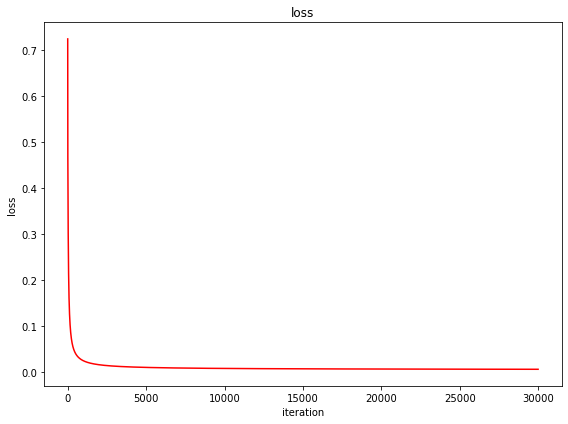

In [186]:
plot_loss_curve(loss1_iteration)

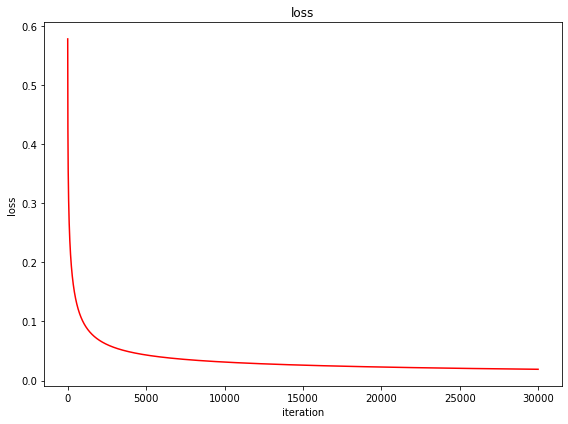

In [187]:
plot_loss_curve(loss2_iteration)

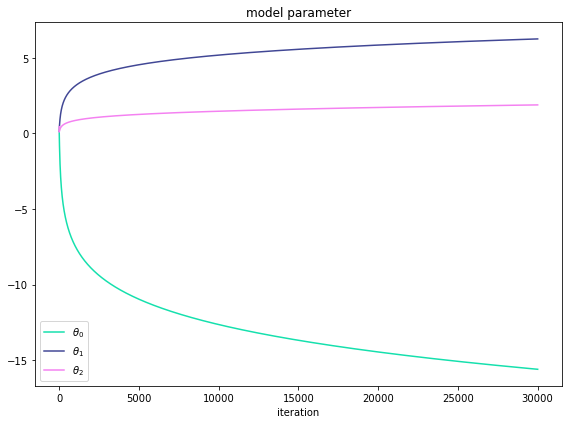

In [188]:
plot_model_parameter(theta1_iteration)

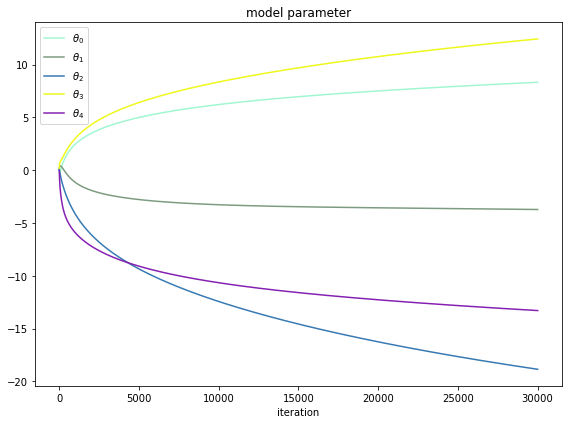

In [189]:
plot_model_parameter(theta2_iteration)

In [22]:
def plot_classifier1(data, theta):
    
    plt.figure(figsize=(8,8)) # USE THIS VALUE for the size of the figure
    #
    # 
    # fill up the function body
    #
    #

In [23]:
def plot_classifier2(data, theta):
    
    plt.figure(figsize=(8,8)) # USE THIS VALUE for the size of the figure
    #
    # 
    # fill up the function body
    #
    #

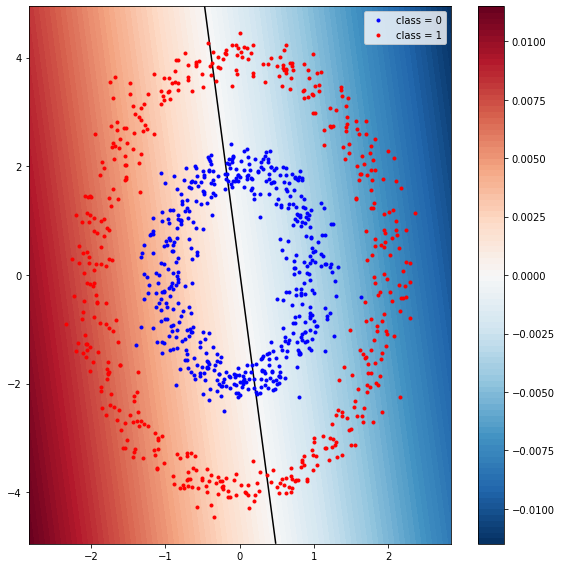

In [24]:
plot_classifier1(data1, theta1_optimal)

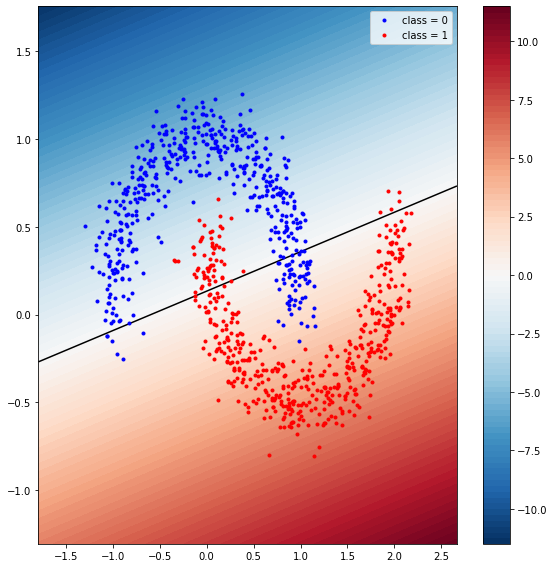

In [25]:
plot_classifier2(data2, theta2_optimal)

# * * * * * * * * * * * * * * * * * * * * * * * * * * * * * * * * *

# * results

# * * * * * * * * * * * * * * * * * * * * * * * * * * * * * * * * *

### # 01. plot the input data (data1) from the file [assignment_09_data1.txt] in blue for class 0 and in red for class 1

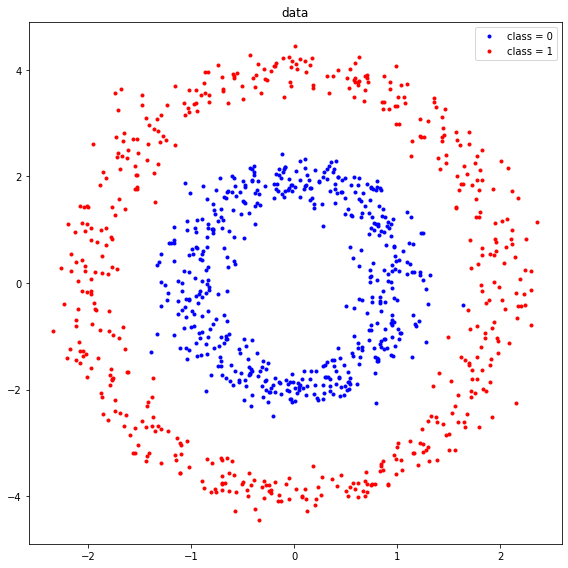

In [104]:
plot_data(data1)

### # 02. plot the input data (data2) from the file [assignment_09_data2.txt] in blue for class 0 and in red for class 1

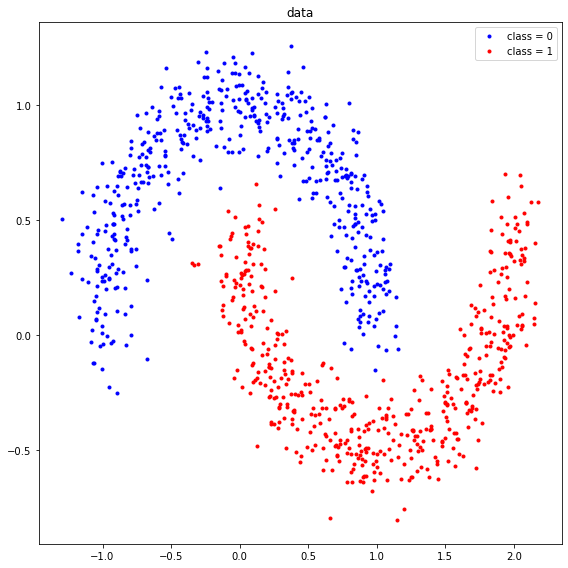

In [105]:
plot_data(data2)

### # 03. plot the values of the model parameters $\theta$ as curves over the gradient descent iterations using different colors for data1

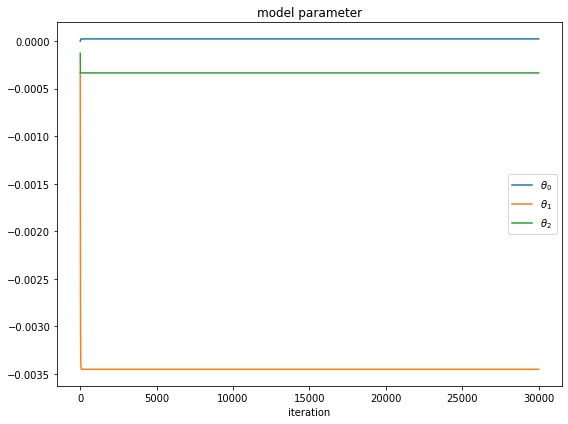

In [28]:
plot_model_parameter(theta1_iteration)

### # 04. plot the values of the model parameters $\theta$ as curves over the gradient descent iterations using different colors for data2

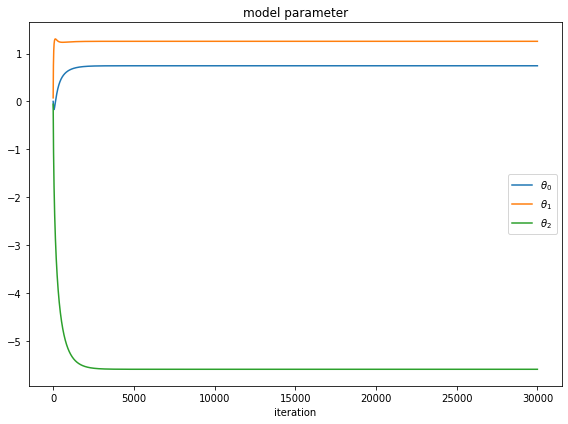

In [29]:
plot_model_parameter(theta2_iteration)

### # 05. plot the loss values in red curve over the gradient descent iterations for data1

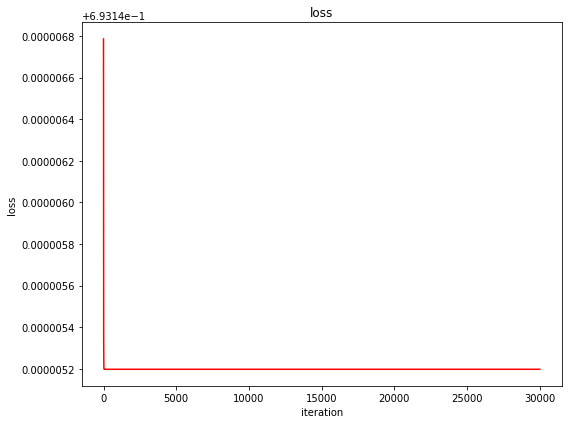

In [30]:
plot_loss_curve(loss1_iteration)

### # 06. plot the loss values in red curve over the gradient descent iterations for data2

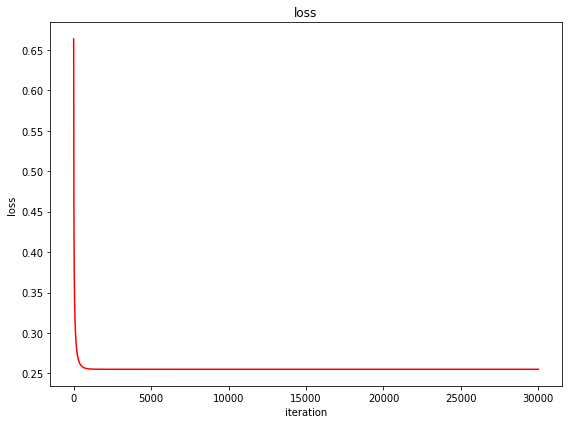

In [31]:
plot_loss_curve(loss2_iteration)

### # 07. plot the classifier with the given data points superimposed for data1

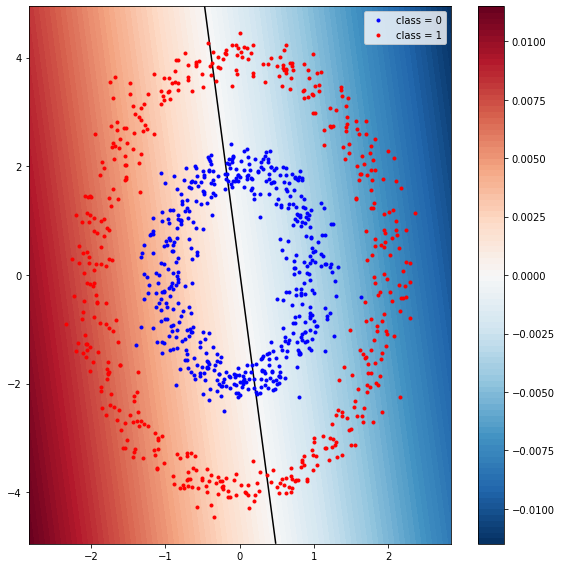

In [32]:
plot_classifier1(data1, theta1_optimal)

### # 08. plot the classifier with the given data points superimposed for data2

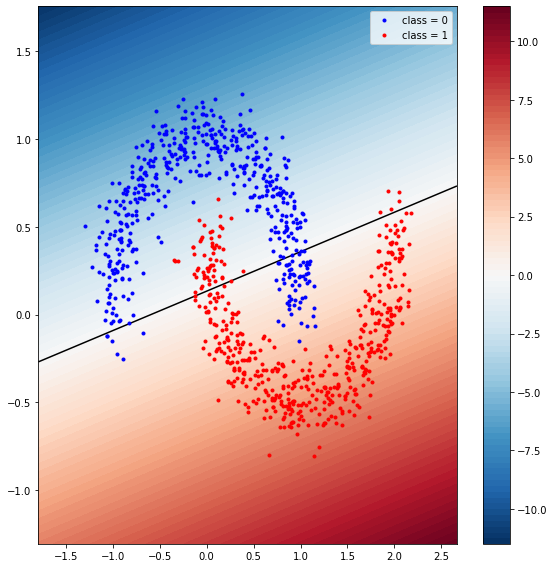

In [33]:
plot_classifier2(data2, theta2_optimal)

### # 09. print out the accuracy of the obtained classifier1 for data1

In [34]:
print(accuracy_classifier1)

0.505


### # 10. print out the accuracy of the obtained classifier2 for data1

In [35]:
print(accuracy_classifier2)

0.868
